# 08 Repeated and additional graphs from the main analyses (in 05a)
For the main reference region only (new para)

In [1]:
# install required packages - commented out so it doesn't install every time
#%conda install -n Lauren openpyxl numpy pandas statsmodels plotnine matplotlib scikit-learn scipy mizani nbconvert pandoc pyreadstat kmodes seaborn

# import required packages
import numpy as np;
import pandas as pd;
import plotnine as p9;
import pickle

import warnings
warnings.filterwarnings( "ignore", module = "plotnine\..*" ) # only include this once finished and want to create nicer figures for pdf


C:\Users\Lauren.Koenig\AppData\Roaming\Python\Python39\site-packages\pandas\core\arrays\masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (


# read in and clean data

In [2]:
data_folder_loc = '//admsyn/Primary/ADM/CustomerStudies/Rockefeller/Riluzole_Biomarkers/'
code_folder_loc = '//admsyn/homes/@DH-ADMDX/0/lauren.koenig-1606/code/Riluzole FDG/'

In [3]:
biomarker_relationship_results_log10, biomarker_relationship_results_raw, all_data = pd.read_pickle(code_folder_loc + '/output/05a_data_new_para_rr.pkl')


In [4]:
biomarker_relationship_results_log10.columns

Index(['y_var', 'x_var', 'model_p_val_baseline', 'model_B_val_baseline',
       'model_n_baseline', 'model_p_val_Intercept',
       'model_p_val_Education_years', 'model_p_val_x_var',
       'model_B_val_Intercept', 'model_B_val_Education_years',
       'model_B_val_x_var', 'model_p_val_age', 'model_B_val_age',
       'model_p_val_race[T.White/NH]', 'model_B_val_race[T.White/NH]',
       'model_p_val_sex[T.M]', 'model_B_val_sex[T.M]',
       'model_p_val_apoe4_carrier[T.Yes]', 'model_B_val_apoe4_carrier[T.Yes]',
       'type'],
      dtype='object')

In [5]:
biomarker_relationship_results_log10.groupby('type')['model_n_baseline'].max()

type
Cognitive     37
FDG PET       42
Plasma        44
Volumetric    36
Name: model_n_baseline, dtype: int64

In [6]:
biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['model_n_baseline']<31 ,['x_var', 'model_n_baseline']].sort_values('model_n_baseline').drop_duplicates()

,x_var,model_n_baseline
0,pTau217_Ab42,14
0,Ab42_40,16
0,pTau231,16
0,Ab42,16
0,Ab40,17
0,pTau217,17
0,pTau217_Ab42,18
0,GFAP,19
0,GFAP_aa,19
0,NFL,19


In [7]:
data_name = 'new_para_rr'

In [8]:
# define biomarker groups
FDG_columns = ['Avg_MedOrbFrontal', 'Graycer_gm', 'Avg_PCC', 'Avg_Hip', 'MTL_gm', 'CO', 'Temp', 'SensMot_gm', 'L_Hip',
 'Vermis_gm', 'FRONTAL_gm', 'AC_gm', 'Precun_gm', 'Par_gm', 'RASref1_gm', 'Temp_gm', 'Paracentral_gm', 'R_Hip', 'PostCing_gm']

plasma_columns = [ 'Ab40', 'Ab42', 'Ab42_40', 'GFAP','NFL',  'pTau181', 'pTau217',  'pTau231', 'pTau181_Ab42']
log10_plasma_columns = [s + '_log10' for s in plasma_columns]

cog_columns = ['MMSE', 'adascogtotal', 'bvrt', 'dstotal','tma','tmb',  'cowattotal', 'cdrtotal', 'cdrsum', 'adltotal', 'npitotal', 'gds']
vol_columns = ['VOL_Precun_Lz', 'VOL_Precun_Rz', 'VOL_InfPar_Lz', 'VOL_InfPar_Rz', 'VOL_Hip_Lz', 'VOL_Hip_Rz', 'VOL_TotalGrayz', 'VOL_Inf_Mid_Fus_Temp_Lz', 
'VOL_Inf_Mid_Fus_Temp_Rz','VOL_MidFront_Lz', 'VOL_MidFront_Rz']

In [9]:
[ele for ele in vol_columns if ele in all_data.columns]

['VOL_Precun_Lz',
 'VOL_Precun_Rz',
 'VOL_InfPar_Lz',
 'VOL_InfPar_Rz',
 'VOL_Hip_Lz',
 'VOL_Hip_Rz',
 'VOL_TotalGrayz',
 'VOL_Inf_Mid_Fus_Temp_Lz',
 'VOL_Inf_Mid_Fus_Temp_Rz',
 'VOL_MidFront_Lz',
 'VOL_MidFront_Rz']

In [10]:
print('any missing covariate data?')
all_data[all_data['timepoint'].isin(['base'])].dropna(subset = [ele for ele in FDG_columns if ele in all_data.columns], how = 'all')[['age', 'Education_years', 'sex', 'apoe4_carrier', 'race']].isna().value_counts().sort_index()

any missing covariate data?


age    Education_years  sex    apoe4_carrier  race 
False  False            False  False          False    40
                               True           False     1
                                              True      6
True   True             True   True           True      1
Name: count, dtype: int64

## make data subsets

In [11]:
# make data subsets
# baseline and non-trial data
baseline_data = all_data[all_data['timepoint'].isin(['base', 'not part of trial'])]

# baseline only
baseline_trial_data = all_data[all_data['timepoint'].isin(['base'])]

# baseline only and only age 70-80
baseline_trial_data_70_80 = baseline_trial_data[(baseline_trial_data['age']<=80) & (baseline_trial_data['age']>=70)]

In [12]:
biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['x_var'].isin(['pTau217']) & biomarker_relationship_results_log10['model_p_val_sex[T.M]'].notna(), ]

,y_var,x_var,model_p_val_baseline,model_B_val_baseline,model_n_baseline,model_p_val_Intercept,model_p_val_Education_years,model_p_val_x_var,model_B_val_Intercept,model_B_val_Education_years,model_B_val_x_var,model_p_val_age,model_B_val_age,model_p_val_race[T.White/NH],model_B_val_race[T.White/NH],model_p_val_sex[T.M],model_B_val_sex[T.M],model_p_val_apoe4_carrier[T.Yes],model_B_val_apoe4_carrier[T.Yes],type
0,Ab42_40,pTau217,Intercept 0.304182 sex[T.M] 0.0...,Intercept -0.222972 sex[T.M] 0.8...,32,0.304182,NaN,0.246654,-0.222972,NaN,0.212512,NaN,NaN,NaN,NaN,0.029434,0.803577,NaN,NaN,Plasma
0,VOL_Entorhinal_Lz,pTau217,Intercept 0.133215 sex[T.M] 0.0...,Intercept 0.317974 sex[T.M] -0.9...,32,0.133215,NaN,0.715169,0.317974,NaN,0.062612,NaN,NaN,NaN,NaN,0.015007,-0.925015,NaN,NaN,Volumetric


In [13]:
for col in ['model_p_val_Education_years', 'model_p_val_x_var', 'model_p_val_age',
       'model_p_val_sex[T.M]', 'model_p_val_apoe4_carrier[T.Yes]',
       'model_p_val_race[T.White/NH]']:
       print(col)
       print((biomarker_relationship_results_log10[col]<0.05).value_counts(), '\n')

model_p_val_Education_years
model_p_val_Education_years
False    1130
True       69
Name: count, dtype: int64 

model_p_val_x_var
model_p_val_x_var
False    1047
True      152
Name: count, dtype: int64 

model_p_val_age
model_p_val_age
False    999
True     200
Name: count, dtype: int64 

model_p_val_sex[T.M]
model_p_val_sex[T.M]
False    1180
True       19
Name: count, dtype: int64 

model_p_val_apoe4_carrier[T.Yes]
model_p_val_apoe4_carrier[T.Yes]
False    1190
True        9
Name: count, dtype: int64 

model_p_val_race[T.White/NH]
model_p_val_race[T.White/NH]
False    1198
True        1
Name: count, dtype: int64 



In [14]:
(biomarker_relationship_results_log10['model_p_val_Education_years']<0.05).value_counts()

model_p_val_Education_years
False    1130
True       69
Name: count, dtype: int64

# Plots of Significant Relationships
the notes listed and graphs plotted are for relationships with significant in the models with age as a covariate and using the log10 transformed plasma data

In [15]:
graphing_pval = 0.05
pvals_to_consider = ['model_p_val_x_var']
Bval_to_grab = 'model_B_val_x_var'

## Ab40

In [16]:
x_var = 'Ab40'

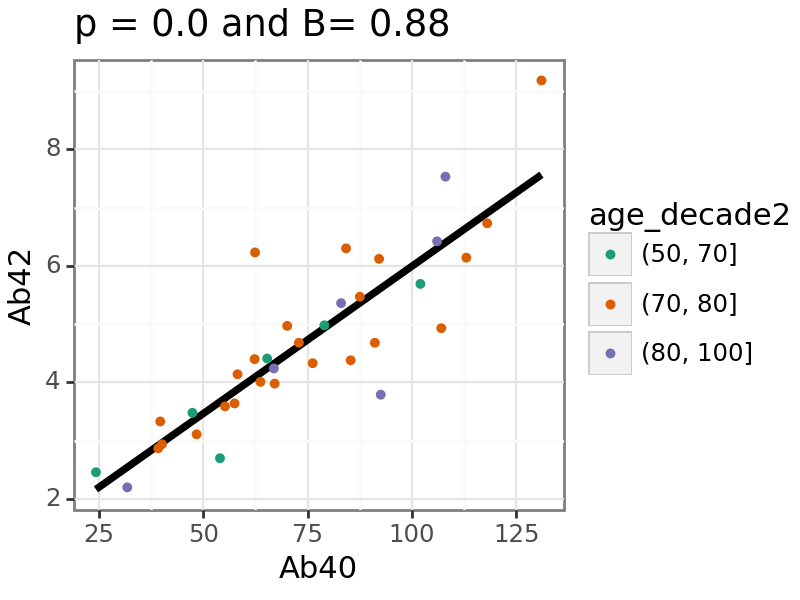

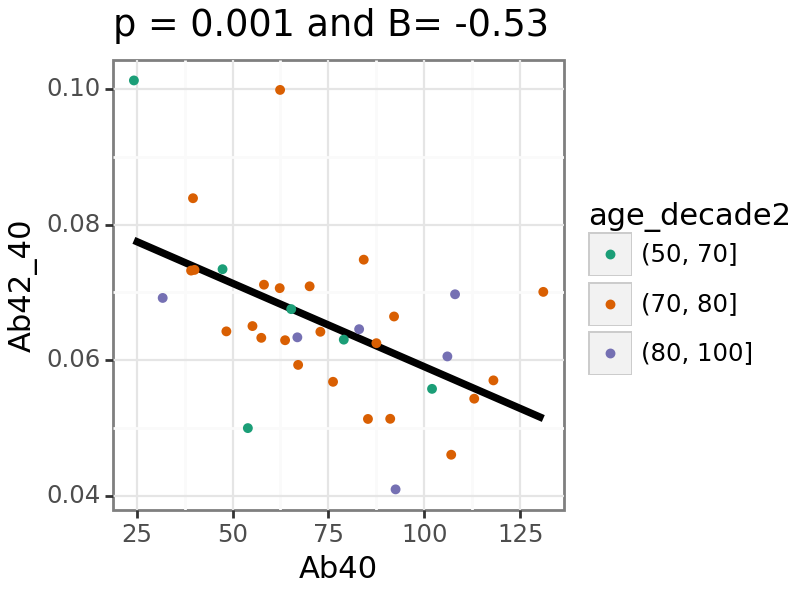

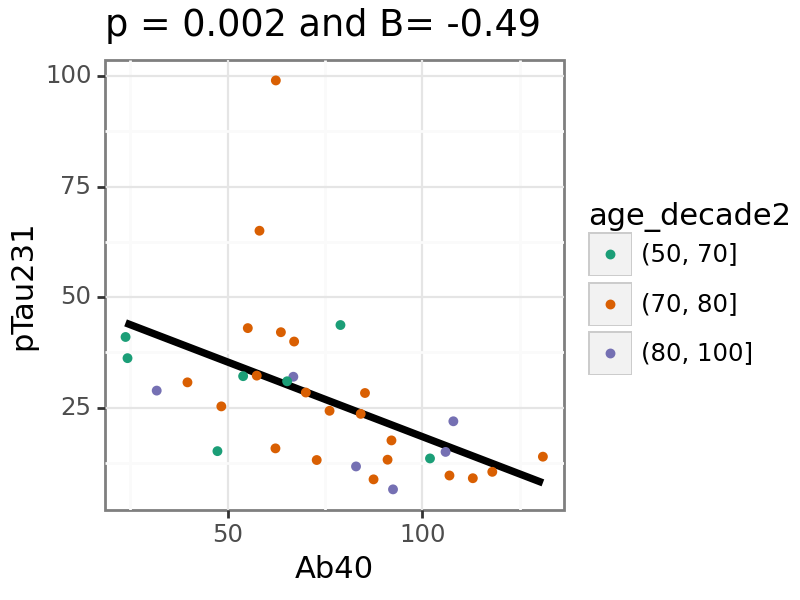

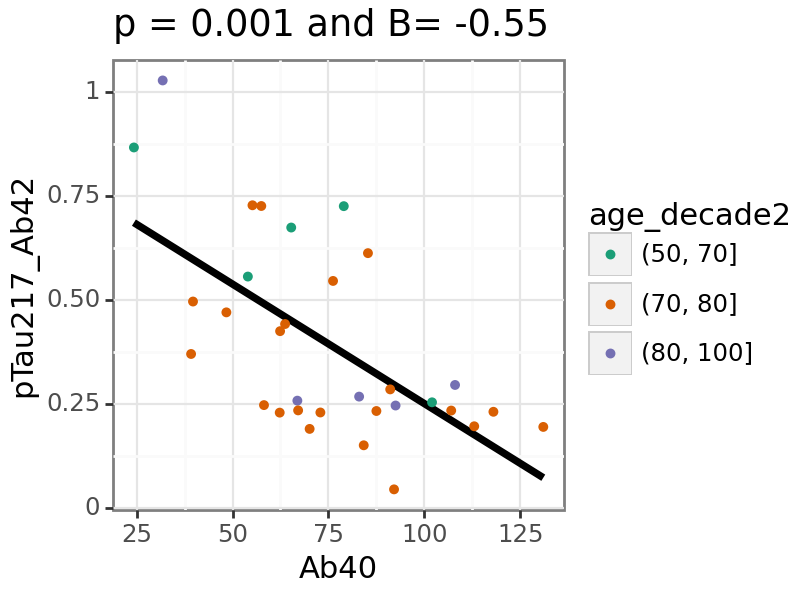

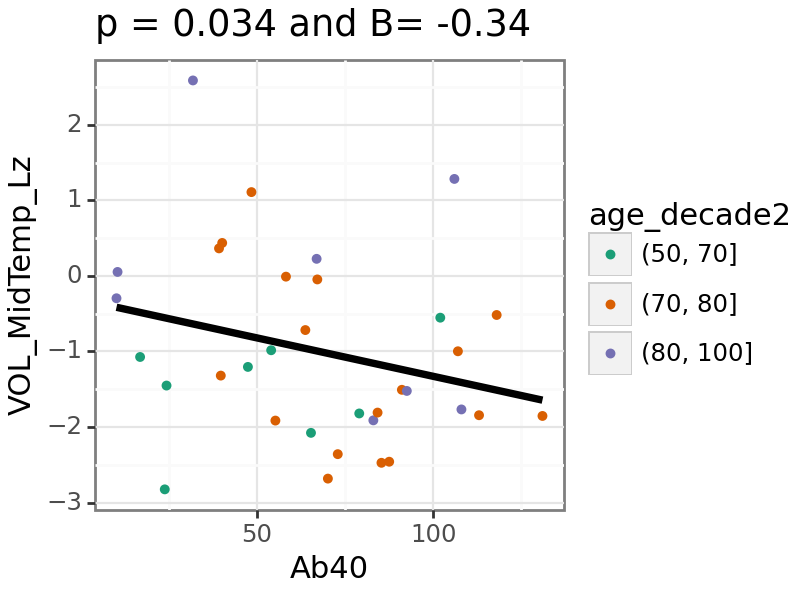

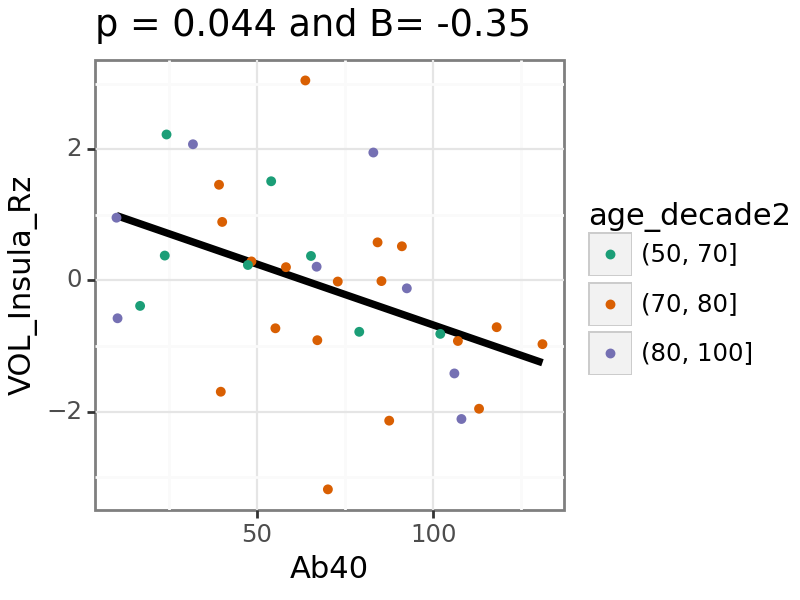

In [17]:
p9.options.figure_size = (4,3)    
var_list = biomarker_relationship_results_log10.loc[
    biomarker_relationship_results_log10['x_var'].isin([x_var]) & (biomarker_relationship_results_log10[pvals_to_consider].min(axis = 1)<graphing_pval), 
    'y_var']

for y_var in var_list.to_list():
    p_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), pvals_to_consider[0]].reset_index(drop=True)[0].round(3).astype('str')
    B_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), Bval_to_grab].reset_index(drop=True)[0].round(2).astype('str')


    subset_data = baseline_trial_data.dropna(subset = [x_var, y_var, 'age_decade2'])
    subset_data2 = subset_data.copy()
    subset_data2 = subset_data2.groupby('age_decade2', observed=True).filter(lambda x: x['ID_ADM'].nunique()> 1)
    plot = (
            p9.ggplot(subset_data, p9.aes(x = x_var, y = y_var, color = 'age_decade2'))
            + p9.theme_bw(base_size = 11)
            + p9.geom_smooth(subset_data, size = 1.5, se = False, alpha = 1, color = 'black', method = 'lm')
            #+ p9.geom_smooth(subset_data2, size = 0.8, se = False, alpha = 1, method = 'lm')
            
            + p9.geom_point(size = 1.0)
            + p9.labs(title = ('p = ' + p_value + ' and B= ' + B_value))
            + p9.scale_color_manual(['#1b9e77', '#d95f02', '#7570b3', '#737373'])
        )
    print(plot)

## Ab42

In [18]:
x_var = 'Ab42'

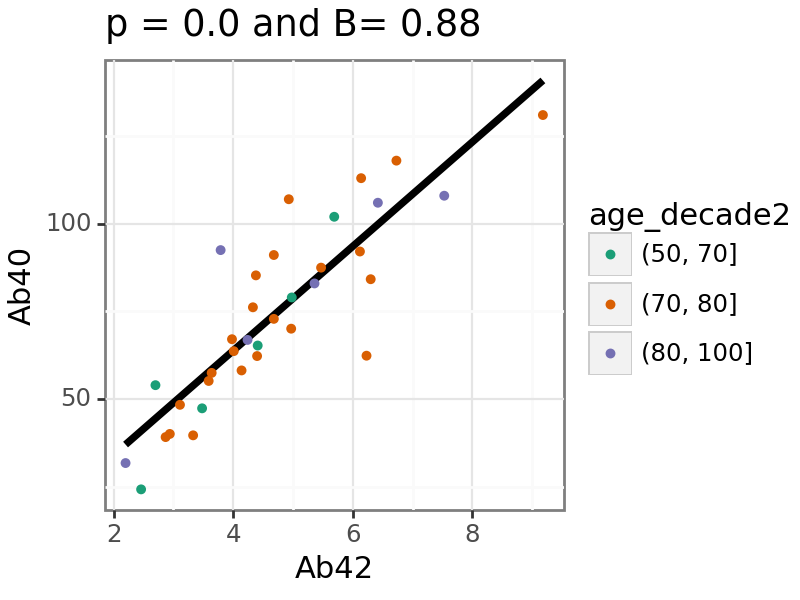

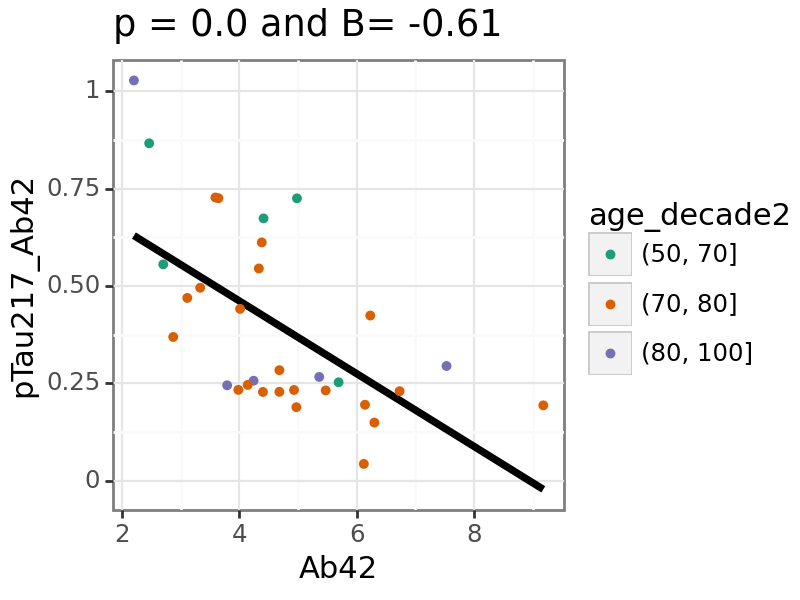

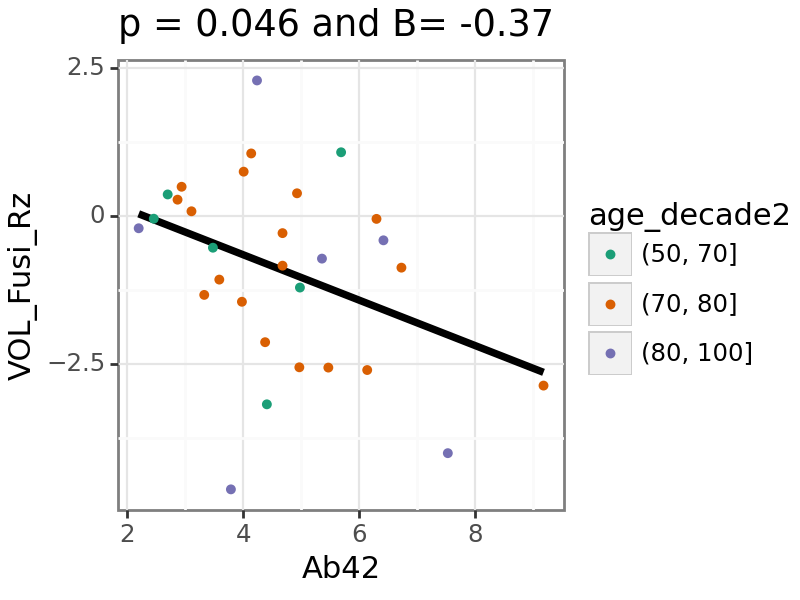

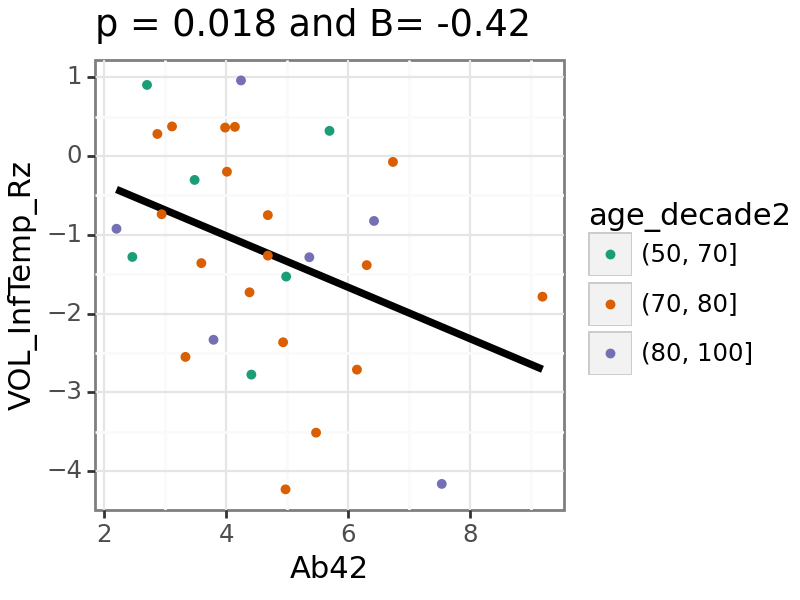

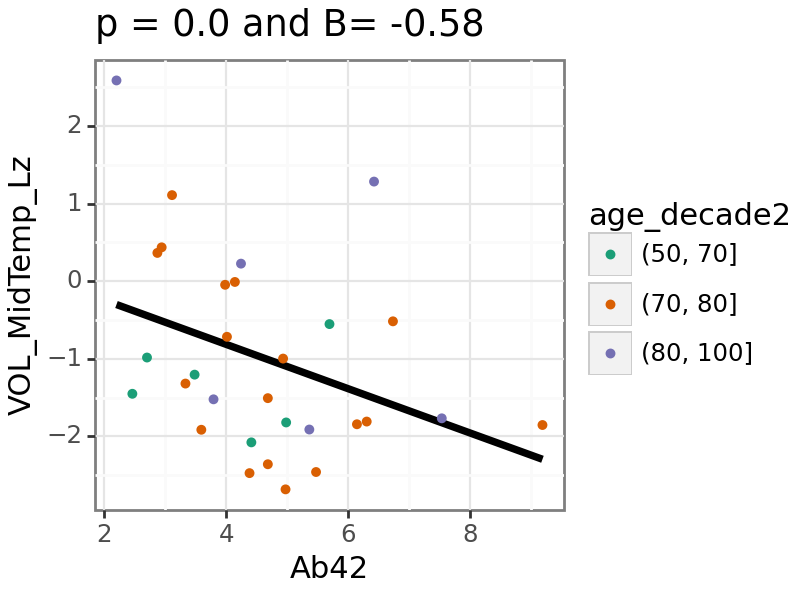

...

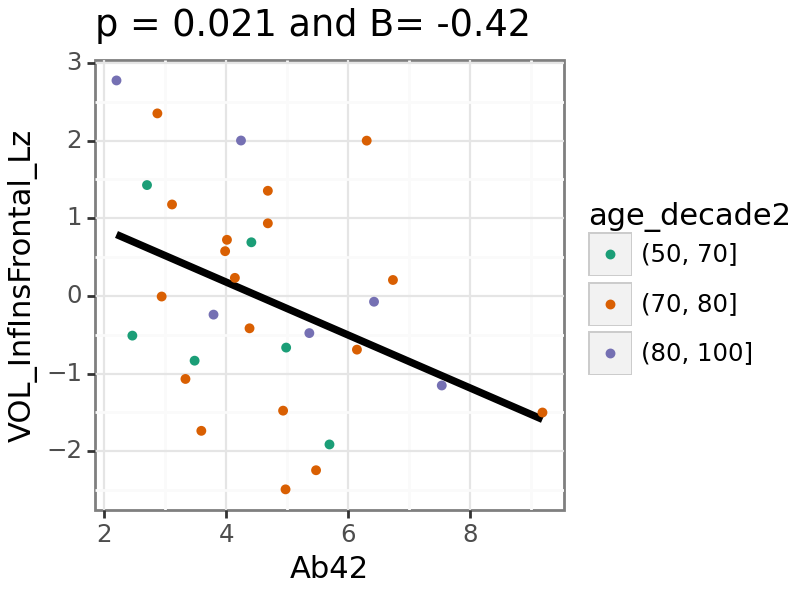

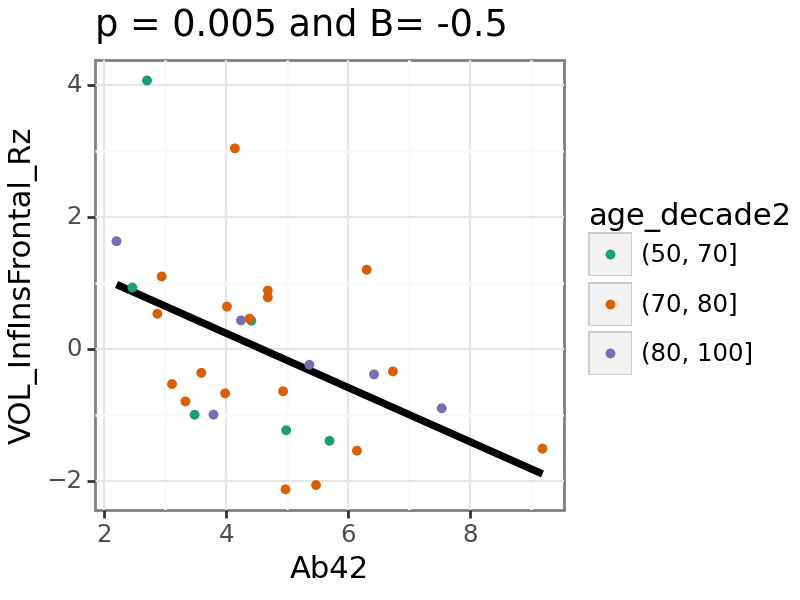

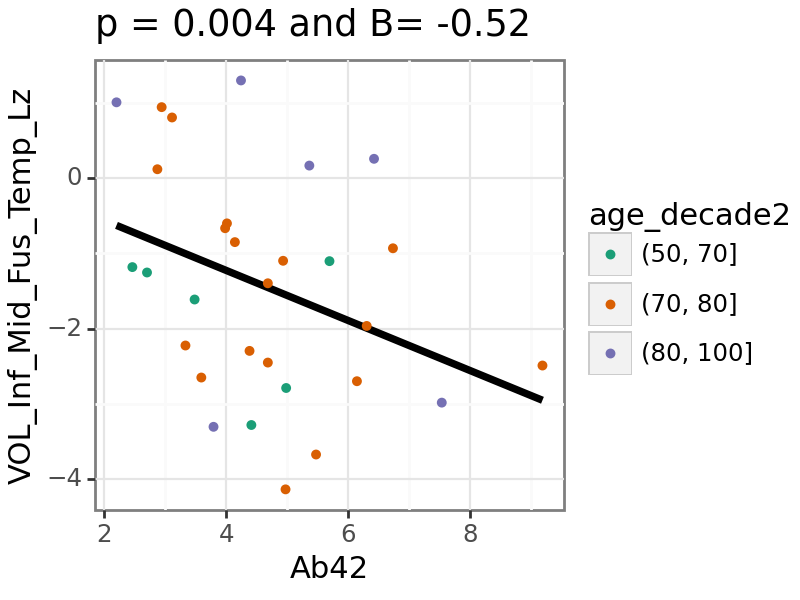

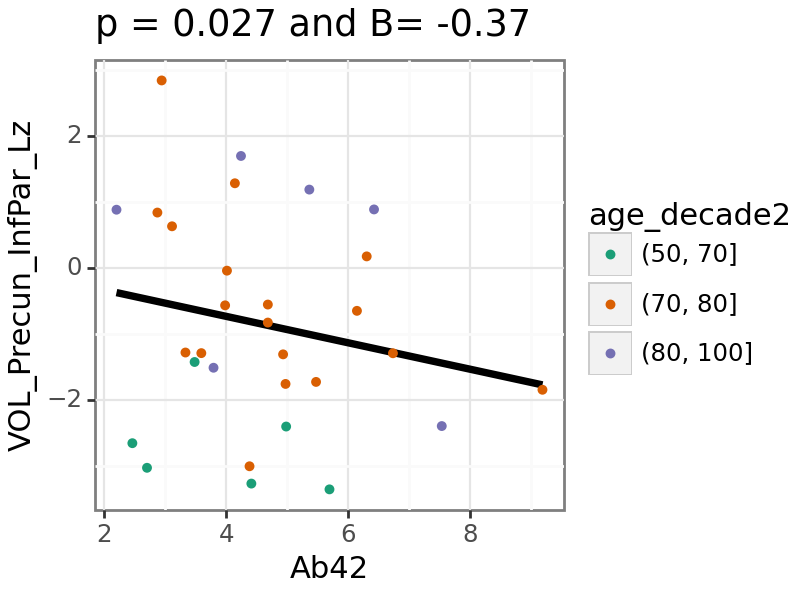

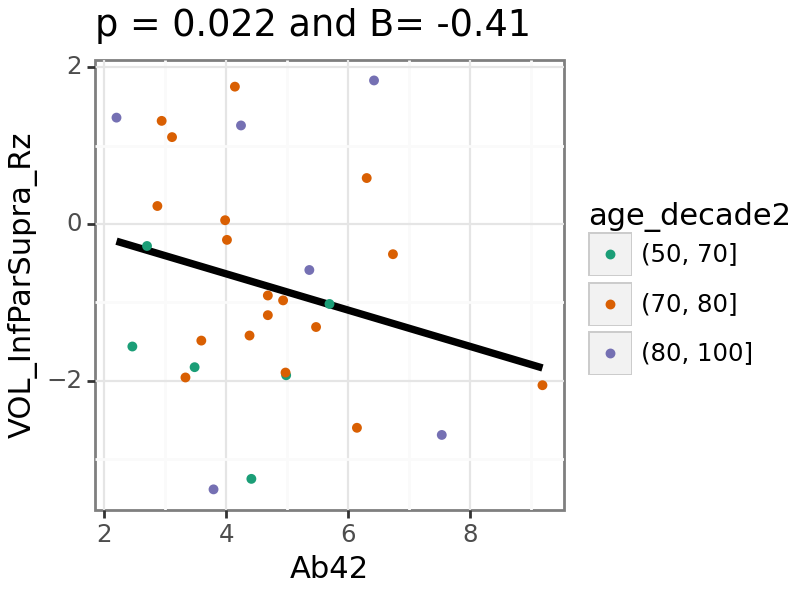

In [19]:
p9.options.figure_size = (4,3)    
var_list = biomarker_relationship_results_log10.loc[
    biomarker_relationship_results_log10['x_var'].isin([x_var]) & (biomarker_relationship_results_log10[pvals_to_consider].min(axis = 1)<graphing_pval), 
    'y_var']

for y_var in var_list.to_list():
    p_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), pvals_to_consider[0]].reset_index(drop=True)[0].round(3).astype('str')
    B_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), Bval_to_grab].reset_index(drop=True)[0].round(2).astype('str')


    subset_data = baseline_trial_data.dropna(subset = [x_var, y_var, 'age_decade2'])
    subset_data2 = subset_data.copy()
    subset_data2 = subset_data2.groupby('age_decade2', observed=True).filter(lambda x: x['ID_ADM'].nunique()> 1)
    plot = (
            p9.ggplot(subset_data, p9.aes(x = x_var, y = y_var, color = 'age_decade2'))
            + p9.theme_bw(base_size = 11)
            + p9.geom_smooth(subset_data, size = 1.5, se = False, alpha = 1, color = 'black', method = 'lm')
            #+ p9.geom_smooth(subset_data2, size = 0.8, se = False, alpha = 1, method = 'lm')
            + p9.geom_point(size = 1.0)
            + p9.labs(title = ('p = ' + p_value + ' and B= ' + B_value))
            + p9.scale_color_manual(['#1b9e77', '#d95f02', '#7570b3', '#737373'])
        )
    print(plot)

## Ab42_40

In [20]:
x_var = 'Ab42_40'

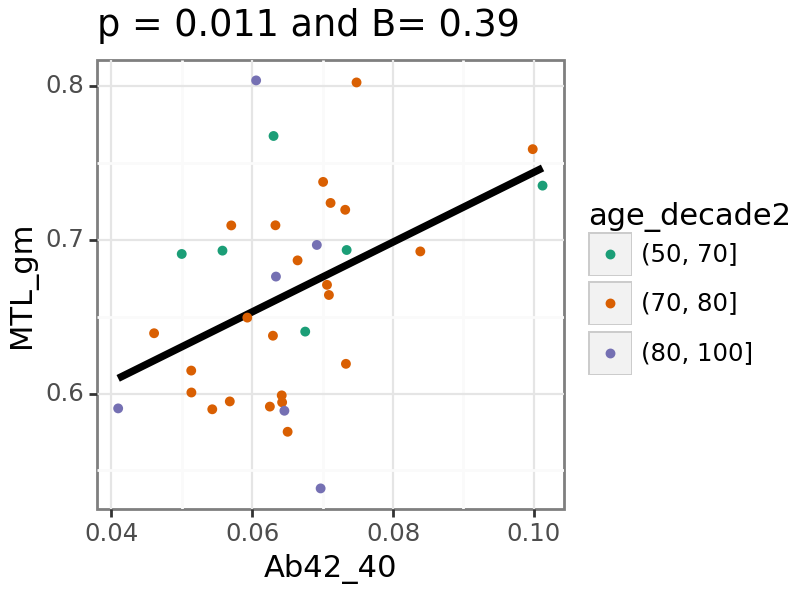

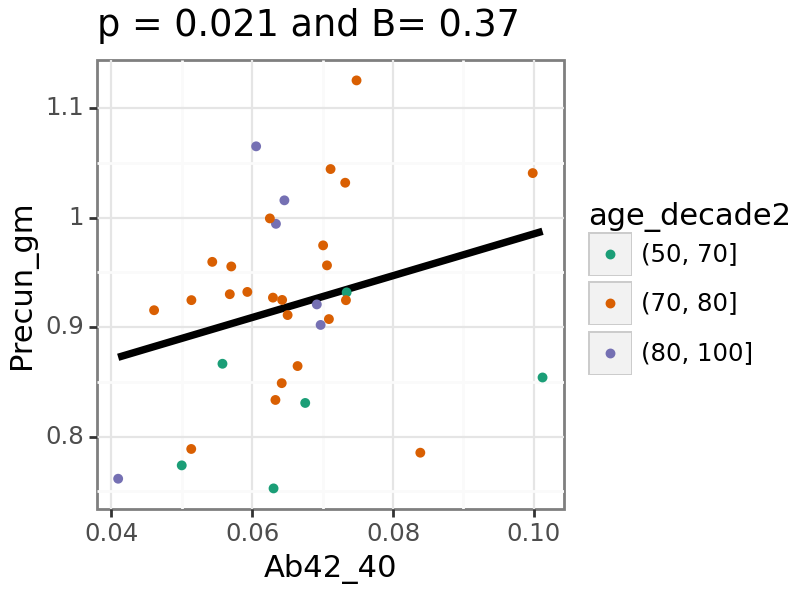

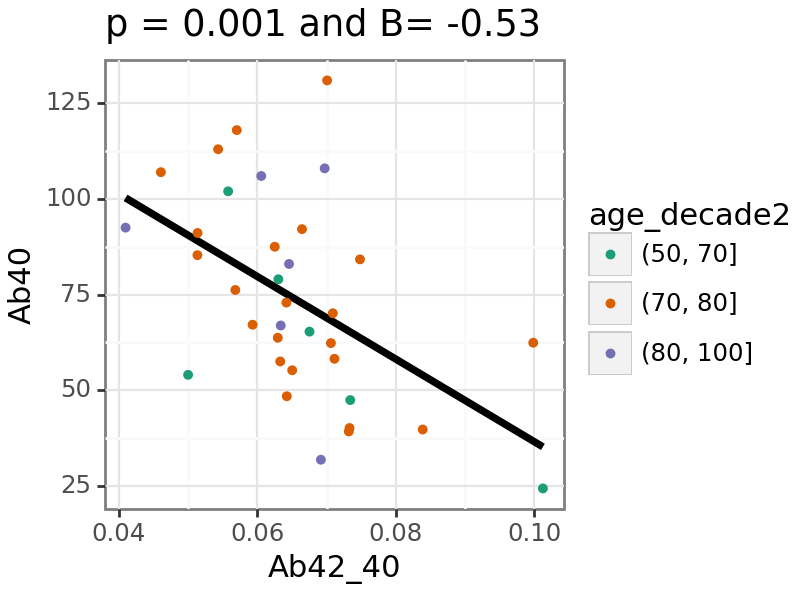

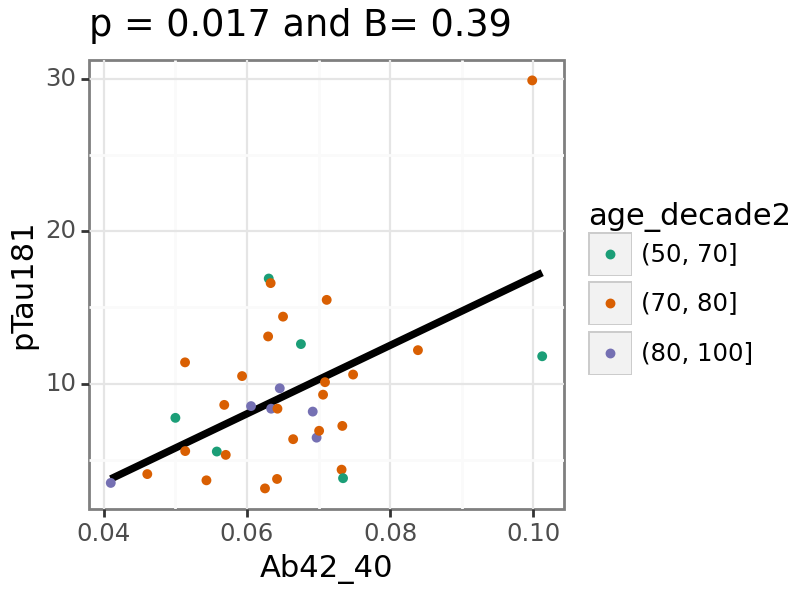

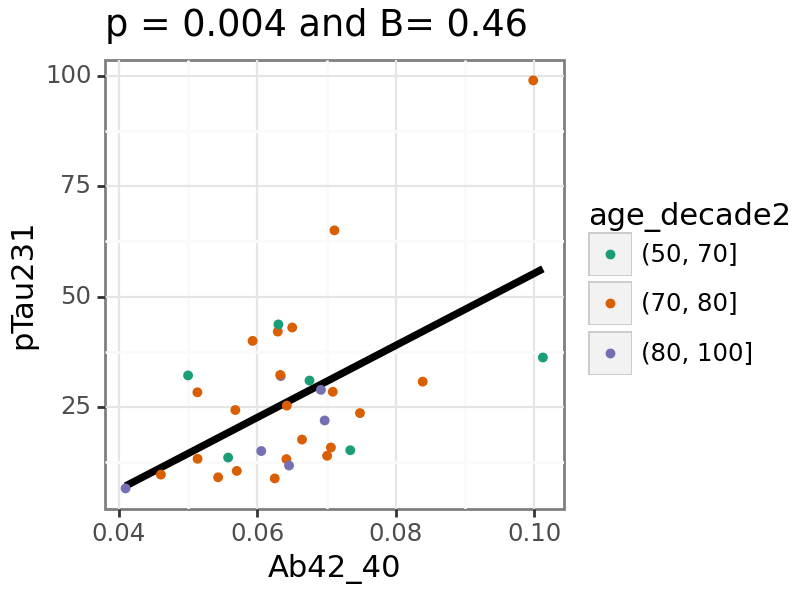

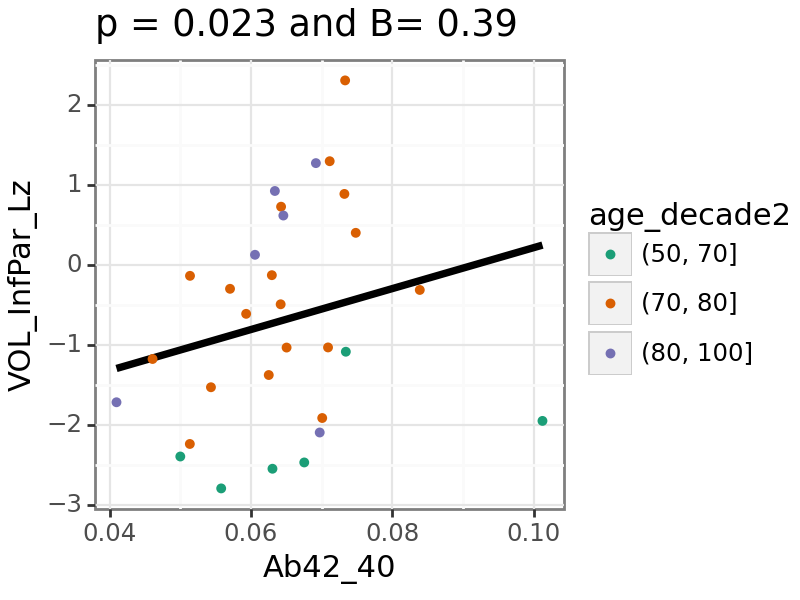

In [21]:
p9.options.figure_size = (4,3)    
var_list = biomarker_relationship_results_log10.loc[
    biomarker_relationship_results_log10['x_var'].isin([x_var]) & (biomarker_relationship_results_log10[pvals_to_consider].min(axis = 1)<graphing_pval), 
    'y_var']

for y_var in var_list.to_list():
    p_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), pvals_to_consider[0]].reset_index(drop=True)[0].round(3).astype('str')
    B_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), Bval_to_grab].reset_index(drop=True)[0].round(2).astype('str')


    subset_data = baseline_trial_data.dropna(subset = [x_var, y_var, 'age_decade2'])
    subset_data2 = subset_data.copy()
    subset_data2 = subset_data2.groupby('age_decade2', observed=True).filter(lambda x: x['ID_ADM'].nunique()> 1)
    plot = (
            p9.ggplot(subset_data, p9.aes(x = x_var, y = y_var, color = 'age_decade2'))
            + p9.theme_bw(base_size = 11)
            + p9.geom_smooth(subset_data, size = 1.5, se = False, alpha = 1, color = 'black', method = 'lm')
            #+ p9.geom_smooth(subset_data2, size = 0.8, se = False, alpha = 1, method = 'lm')
            
            + p9.geom_point(size = 1.0)
            + p9.labs(title = ('p = ' + p_value + ' and B= ' + B_value))
            + p9.scale_color_manual(['#1b9e77', '#d95f02', '#7570b3', '#737373'])
        )
    print(plot)

## pTau181


In [22]:
x_var = 'pTau181'

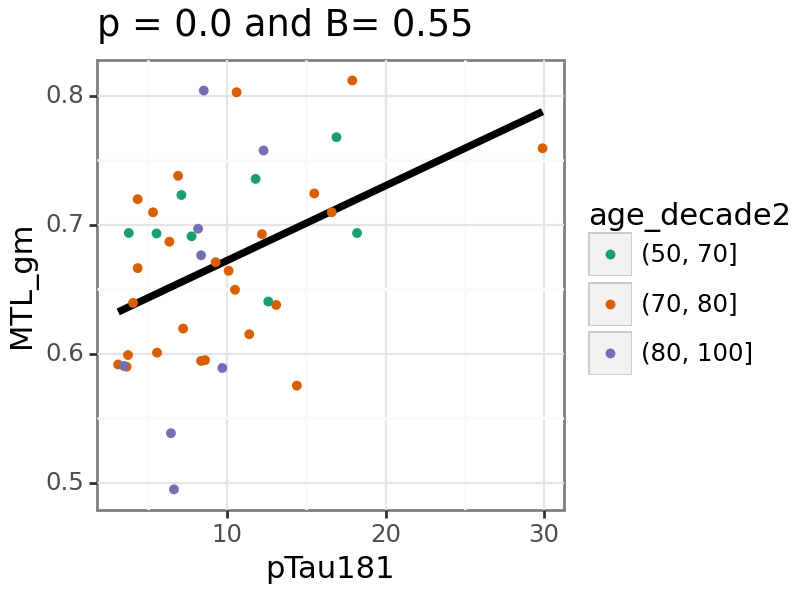

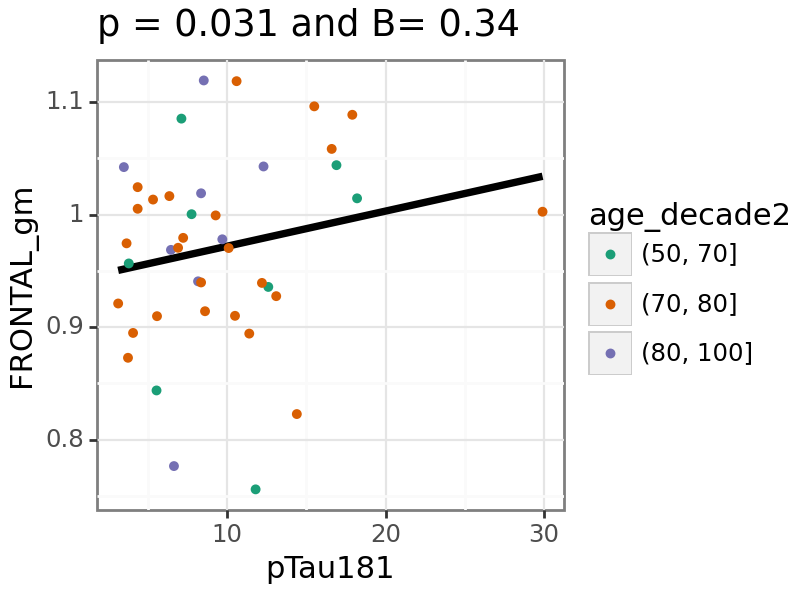

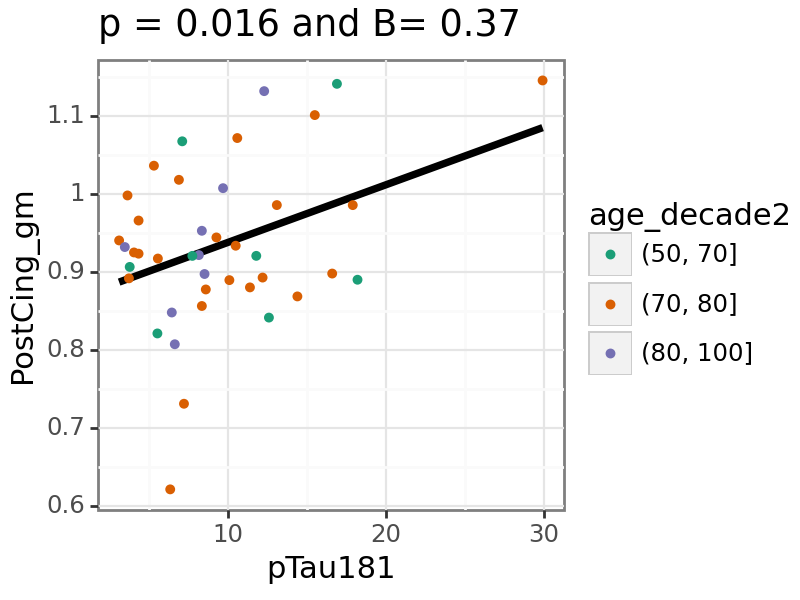

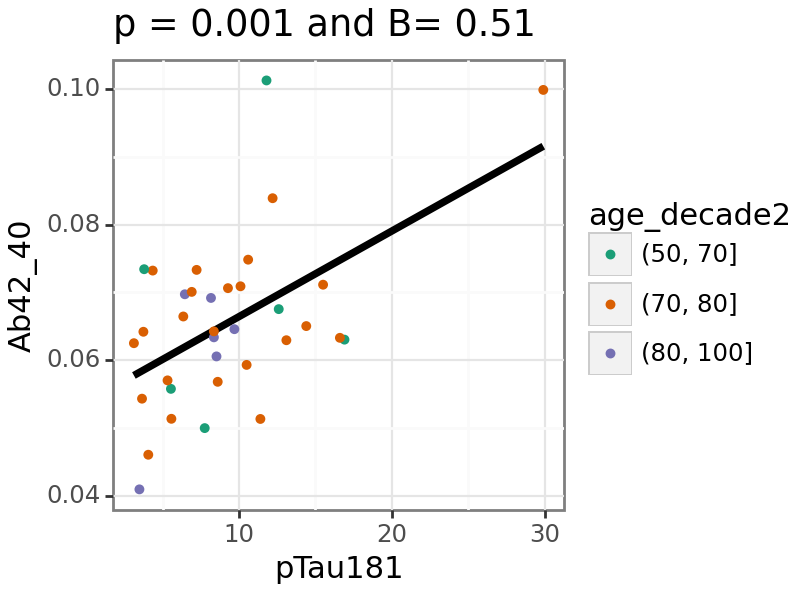

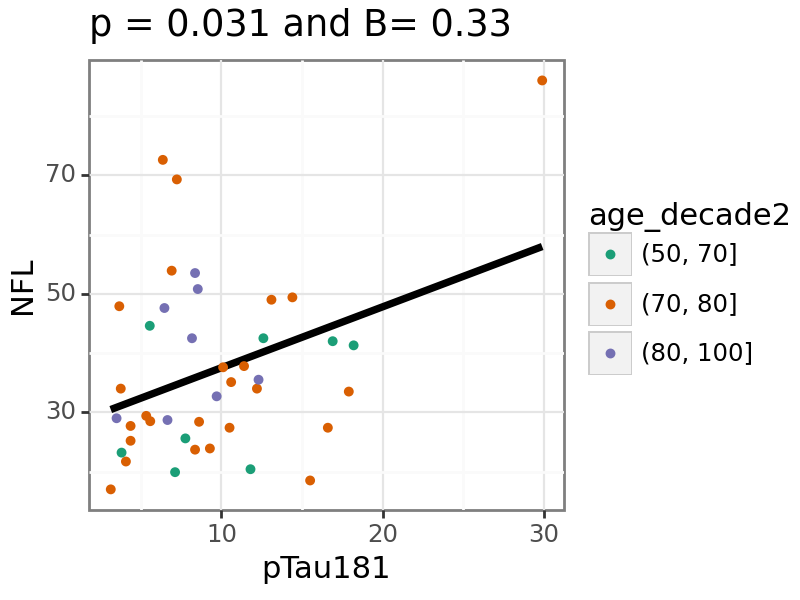

...

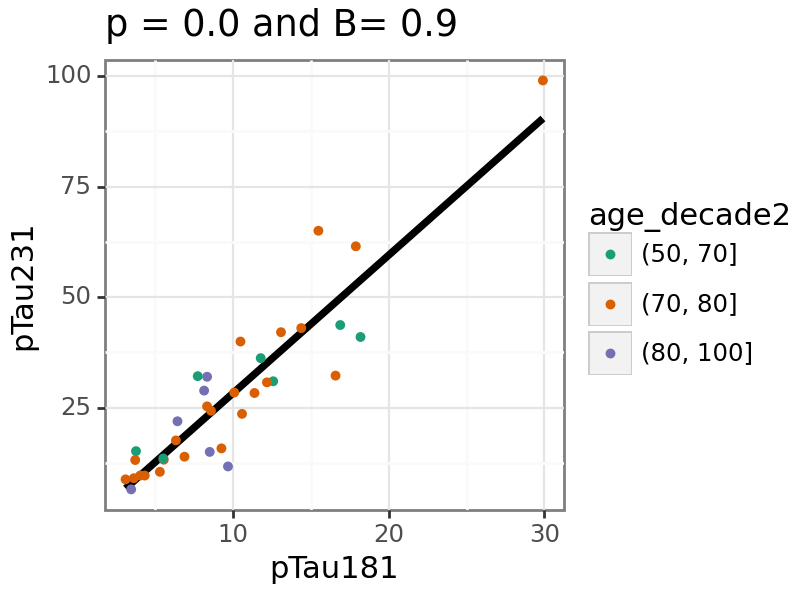

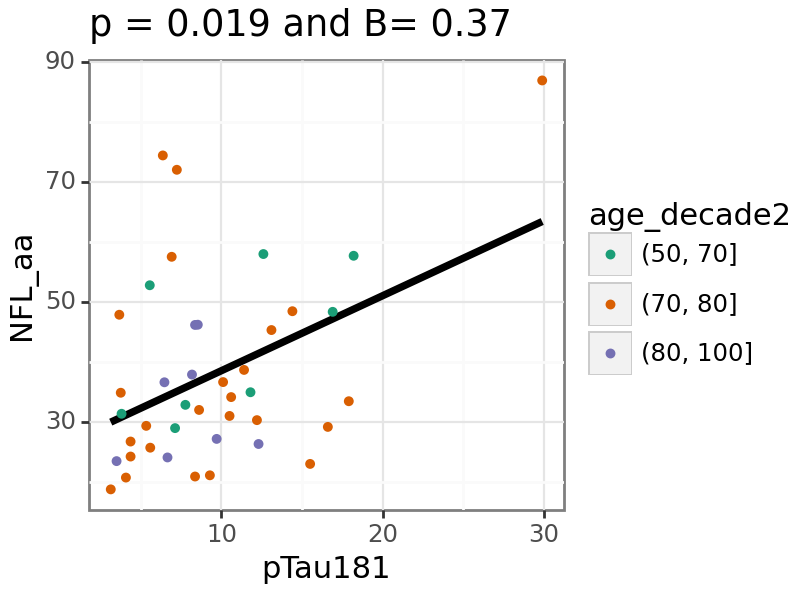

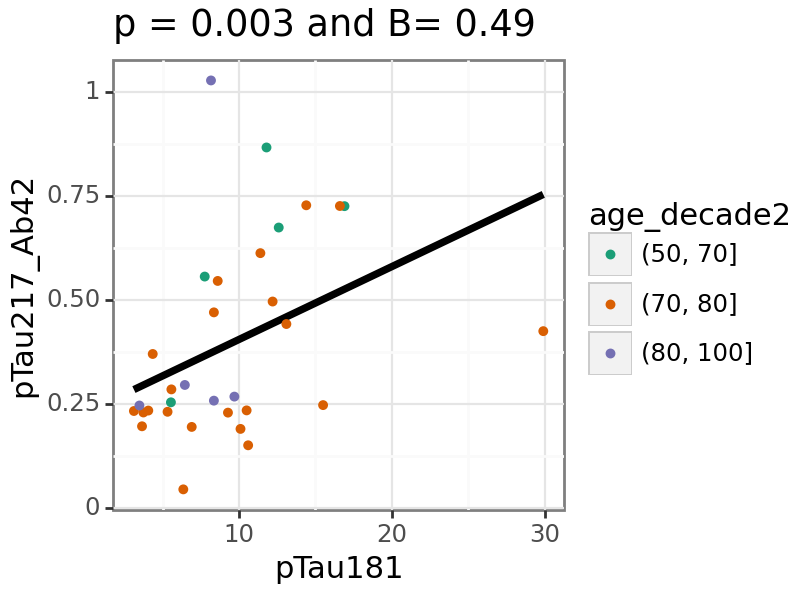

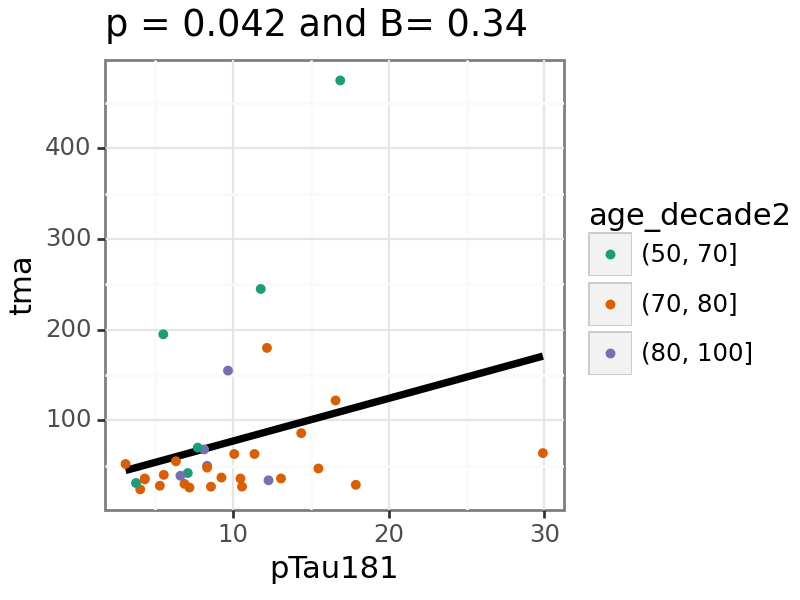

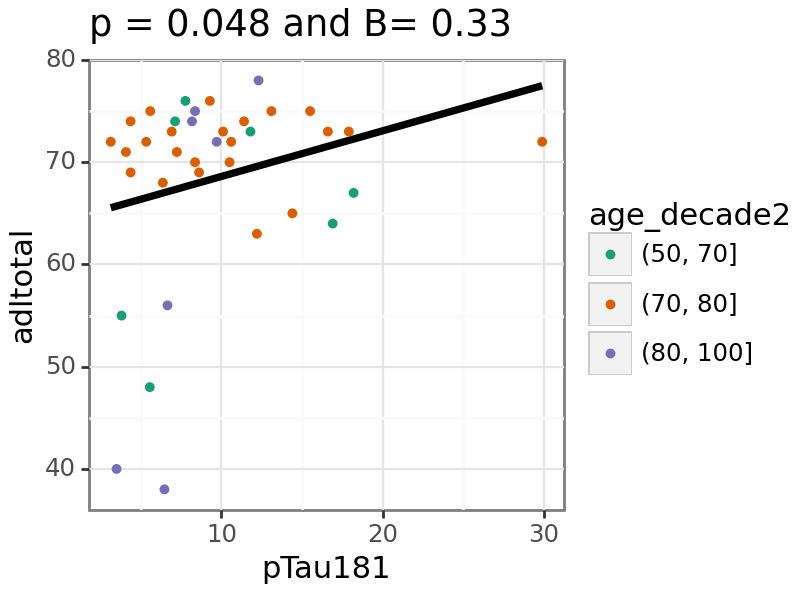

In [23]:
p9.options.figure_size = (4,3)    
var_list = biomarker_relationship_results_log10.loc[
    biomarker_relationship_results_log10['x_var'].isin([x_var]) & (biomarker_relationship_results_log10[pvals_to_consider].min(axis = 1)<graphing_pval), 
    'y_var']

for y_var in var_list.to_list():
    p_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), pvals_to_consider[0]].reset_index(drop=True)[0].round(3).astype('str')
    B_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), Bval_to_grab].reset_index(drop=True)[0].round(2).astype('str')


    subset_data = baseline_trial_data.dropna(subset = [x_var, y_var, 'age_decade2'])
    subset_data2 = subset_data.copy()
    subset_data2 = subset_data2.groupby('age_decade2', observed=True).filter(lambda x: x['ID_ADM'].nunique()> 1)
    plot = (
            p9.ggplot(subset_data, p9.aes(x = x_var, y = y_var, color = 'age_decade2'))
            + p9.theme_bw(base_size = 11)
            + p9.geom_smooth(subset_data, size = 1.5, se = False, alpha = 1, color = 'black', method = 'lm')
            #+ p9.geom_smooth(subset_data2, size = 0.8, se = False, alpha = 1, method = 'lm')
            
            + p9.geom_point(size = 1.0)
            + p9.labs(title = ('p = ' + p_value + ' and B= ' + B_value))
            + p9.scale_color_manual(['#1b9e77', '#d95f02', '#7570b3', '#737373'])
        )
    print(plot)

## pTau217

In [24]:
x_var = 'pTau217'

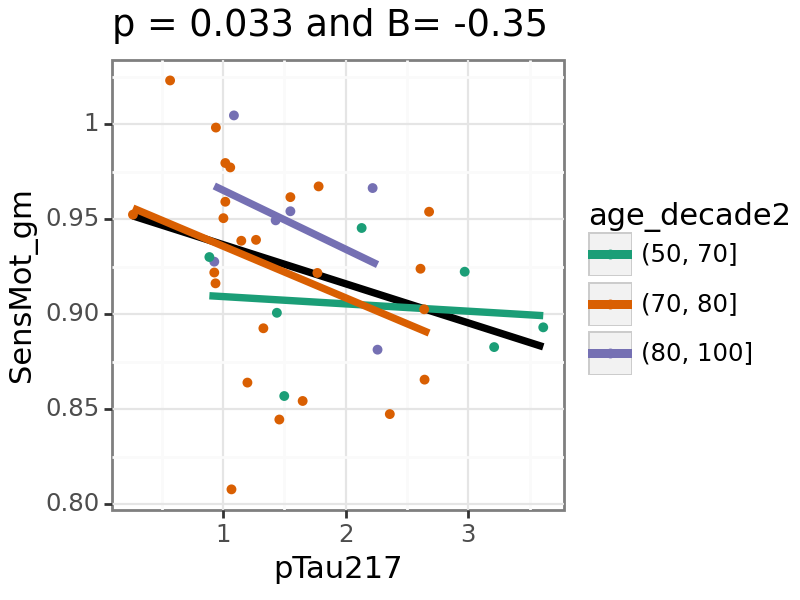

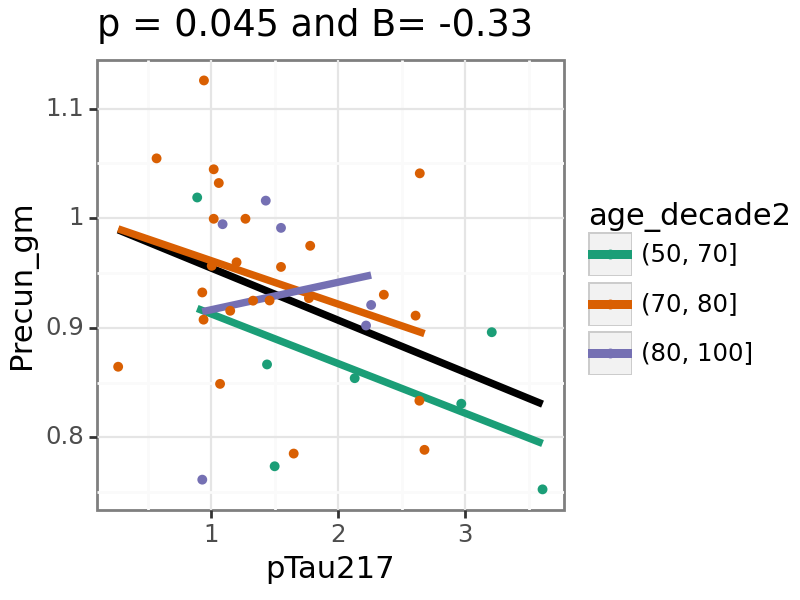

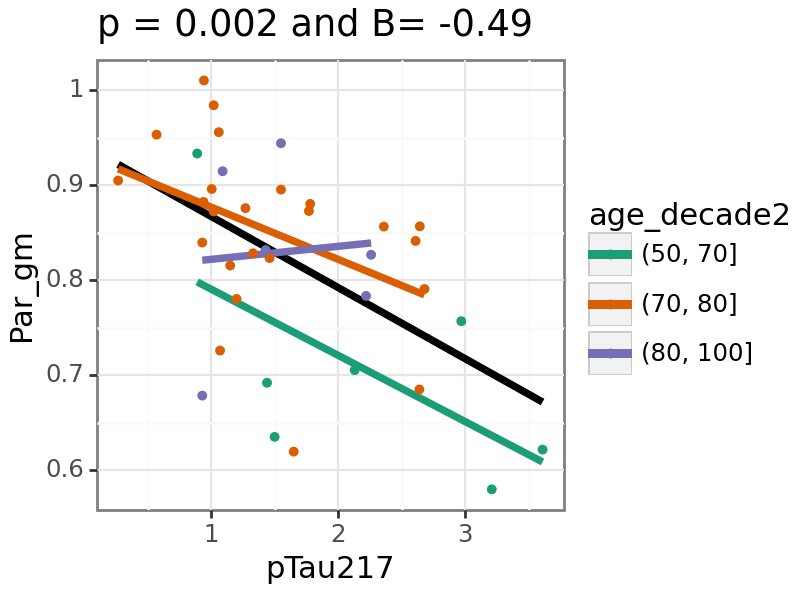

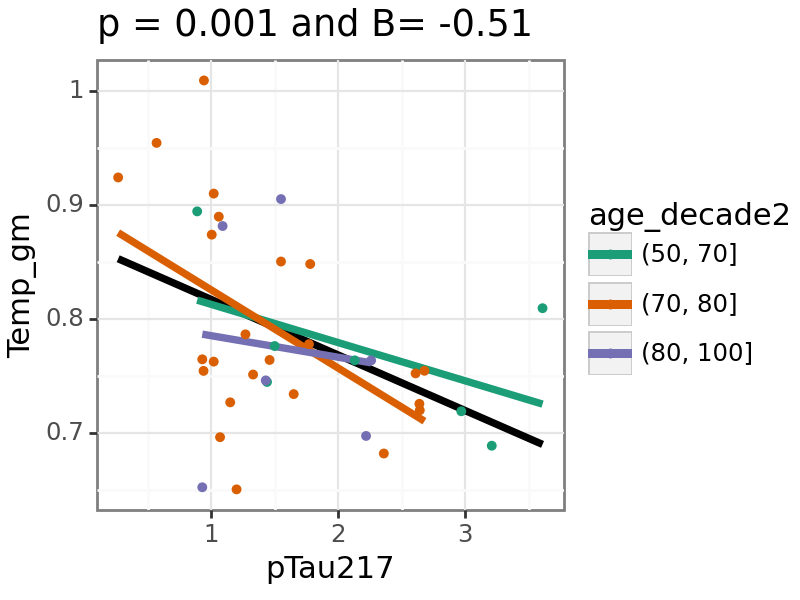

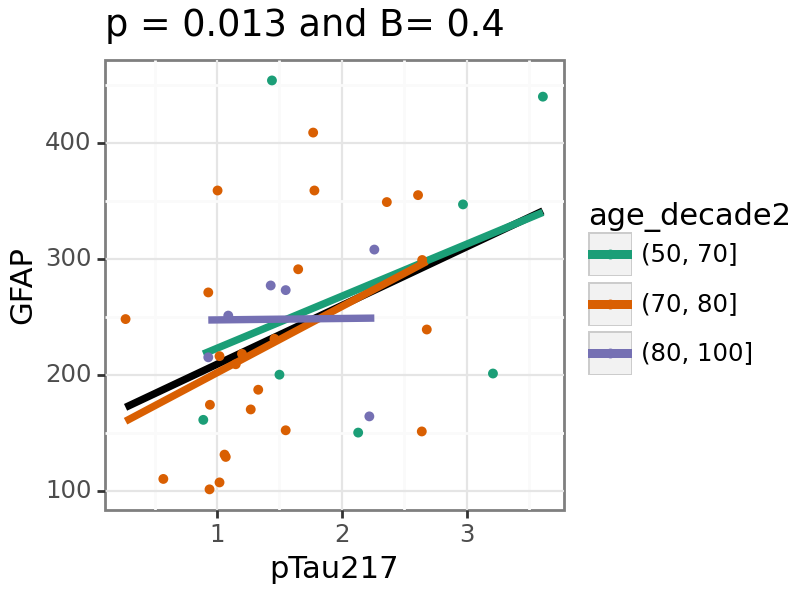

...

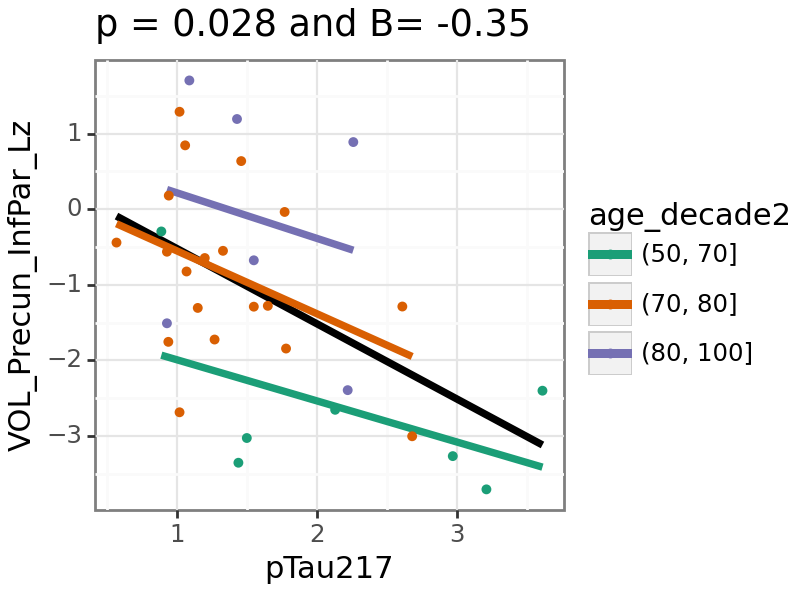

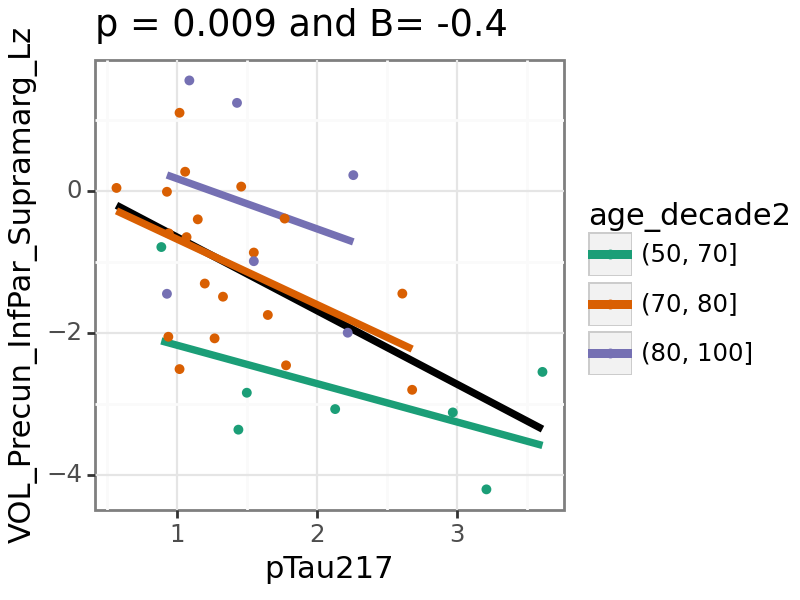

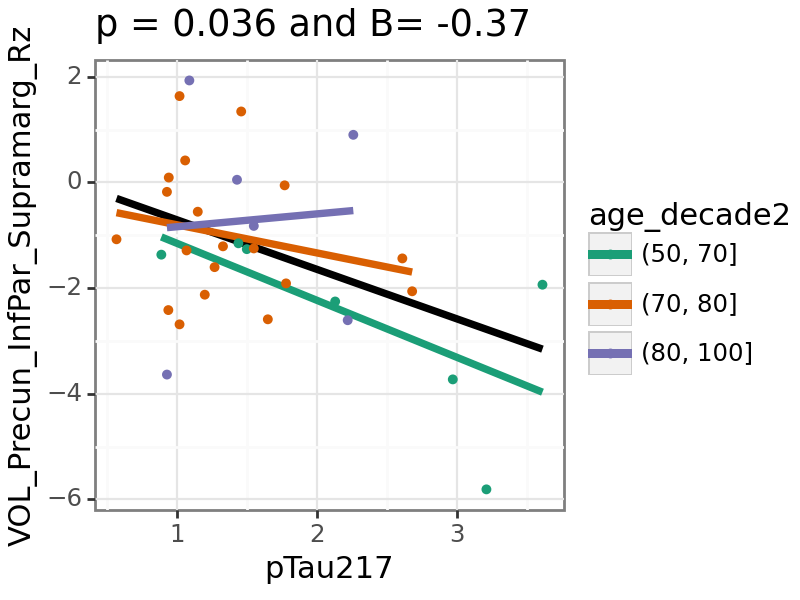

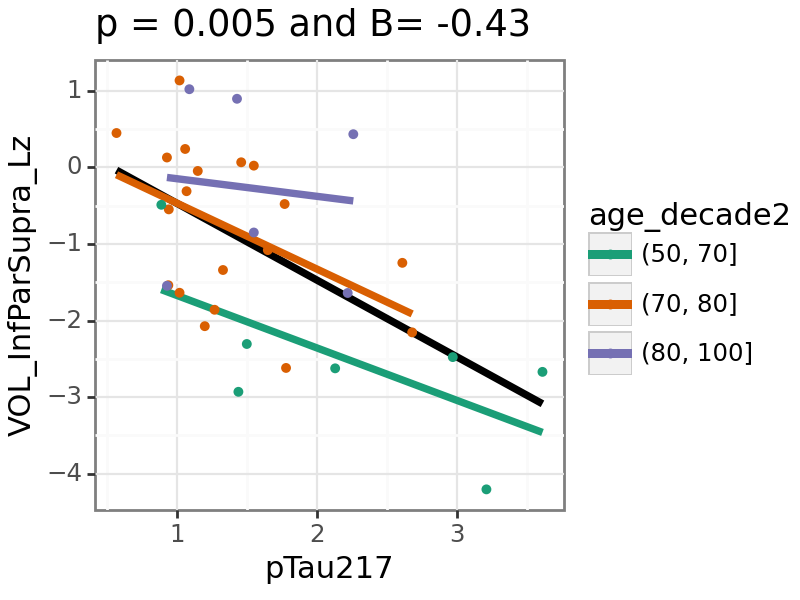

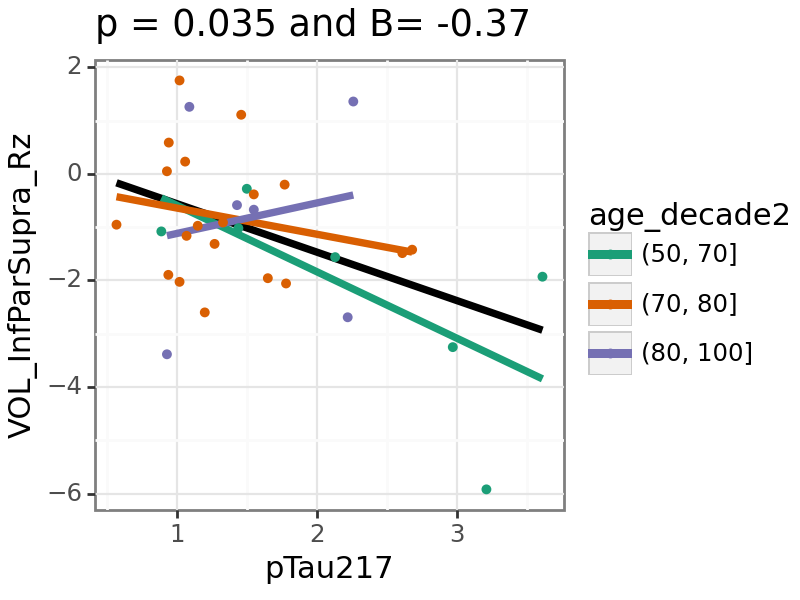

In [25]:
p9.options.figure_size = (4,3)    
var_list = biomarker_relationship_results_log10.loc[
    biomarker_relationship_results_log10['x_var'].isin([x_var]) & (biomarker_relationship_results_log10[pvals_to_consider].min(axis = 1)<graphing_pval), 
    'y_var']

for y_var in var_list.to_list():
    p_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), pvals_to_consider[0]].reset_index(drop=True)[0].round(3).astype('str')
    B_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), Bval_to_grab].reset_index(drop=True)[0].round(2).astype('str')


    subset_data = baseline_trial_data.dropna(subset = [x_var, y_var, 'age_decade2'])
    subset_data2 = subset_data.copy()
    subset_data2 = subset_data2.groupby('age_decade2', observed=True).filter(lambda x: x['ID_ADM'].nunique()> 1)
    plot = (
            p9.ggplot(subset_data, p9.aes(x = x_var, y = y_var, color = 'age_decade2'))
            + p9.theme_bw(base_size = 11)
            + p9.geom_smooth(subset_data, size = 1.5, se = False, alpha = 1, color = 'black', method = 'lm')
            + p9.geom_smooth(subset_data, size = 1.5, se = False, alpha = 1, method = 'lm')
            
            + p9.geom_point(size = 1.0)
            + p9.labs(title = ('p = ' + p_value + ' and B= ' + B_value))
            + p9.scale_color_manual(['#1b9e77', '#d95f02', '#7570b3', '#737373'])
        )
    print(plot)

## pTau231

In [26]:
x_var = 'pTau231'

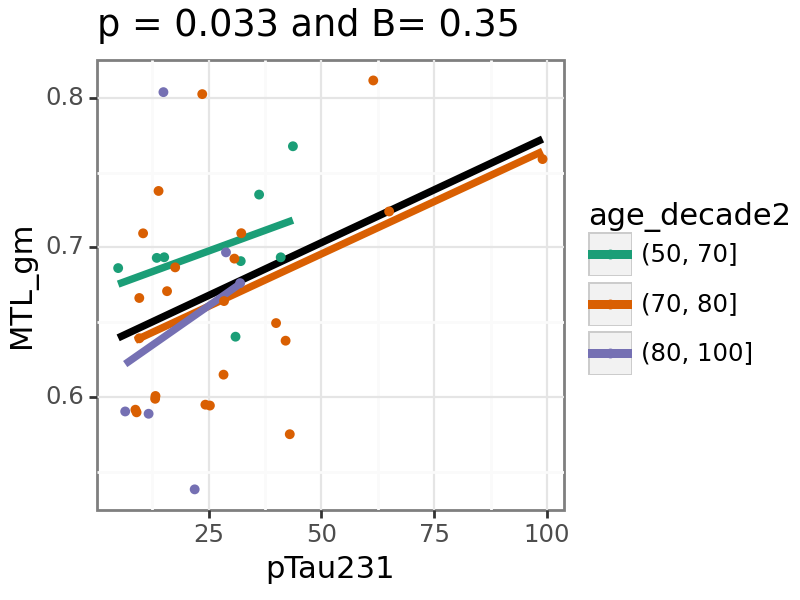

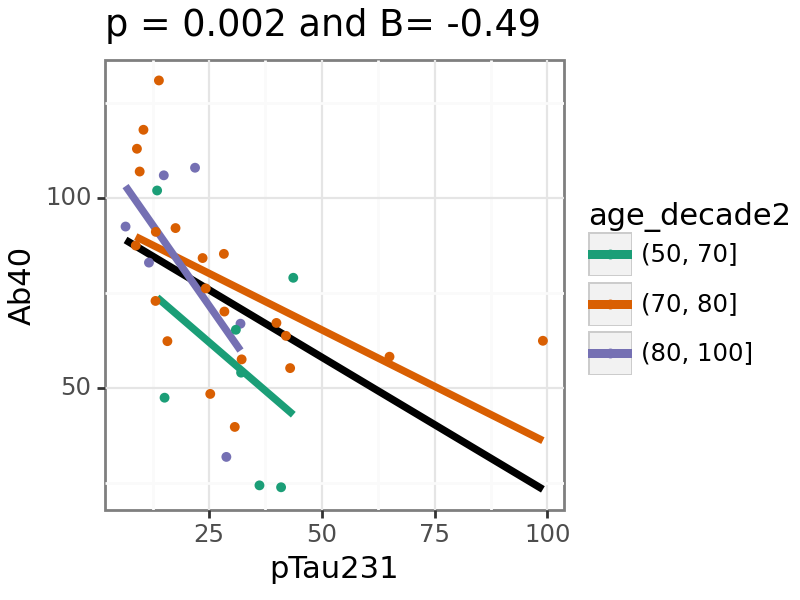

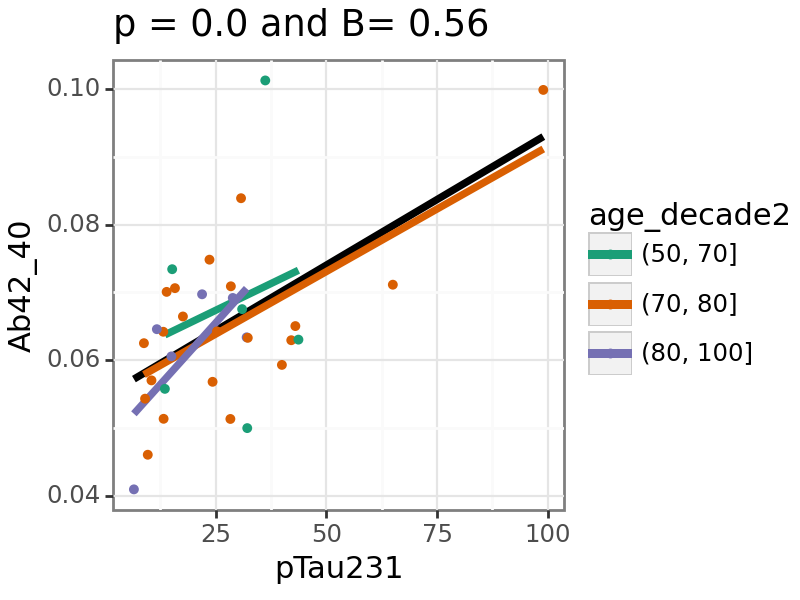

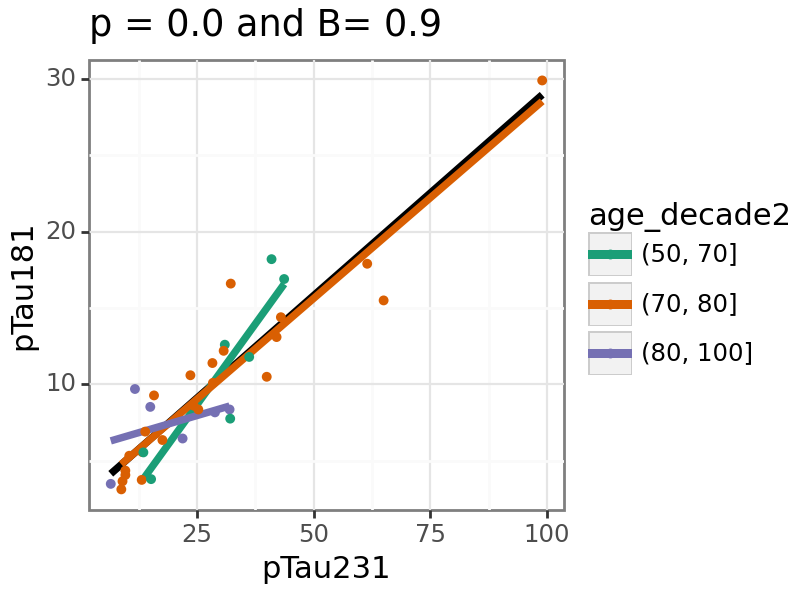

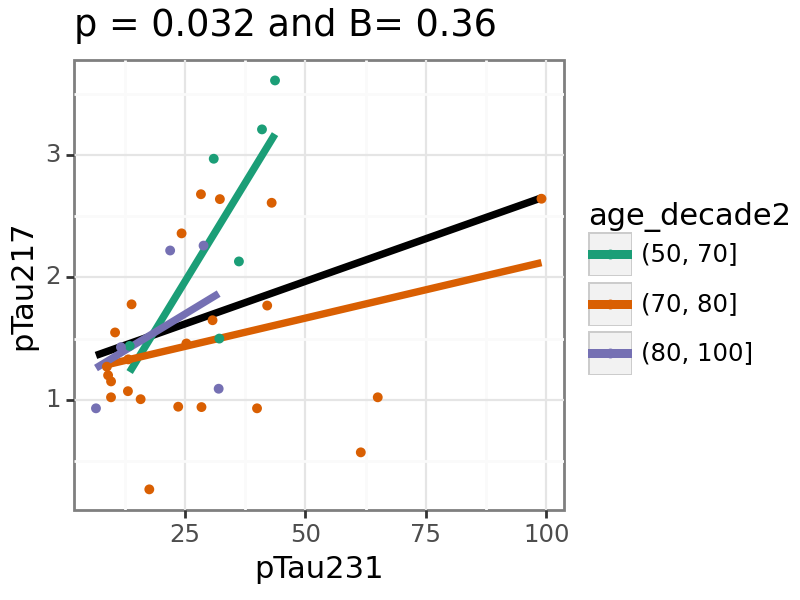

...

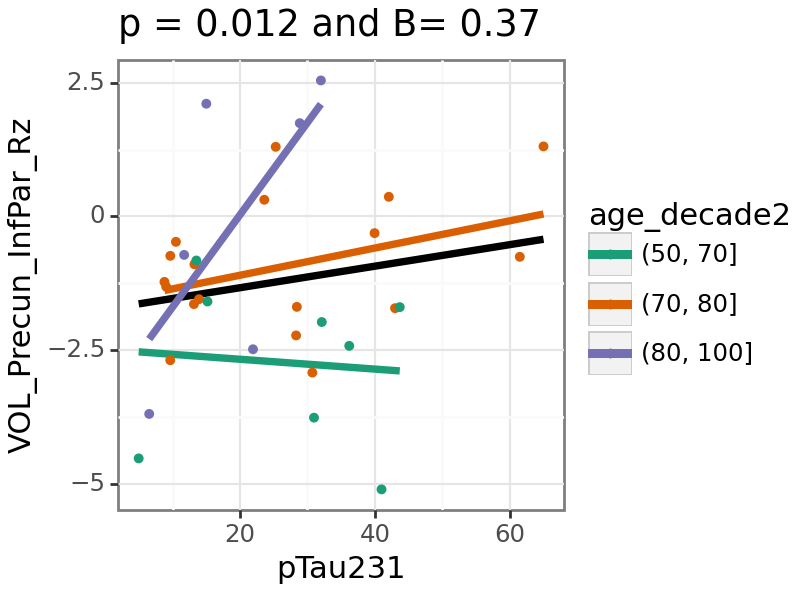

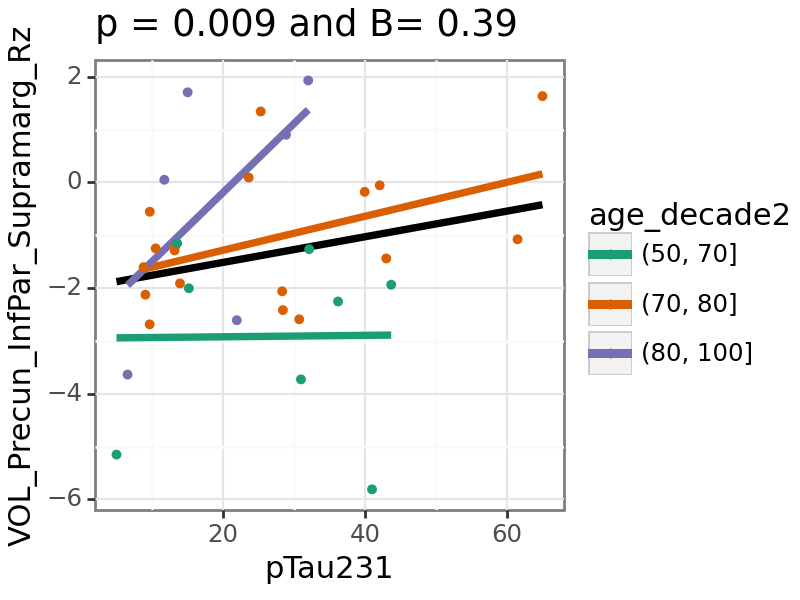

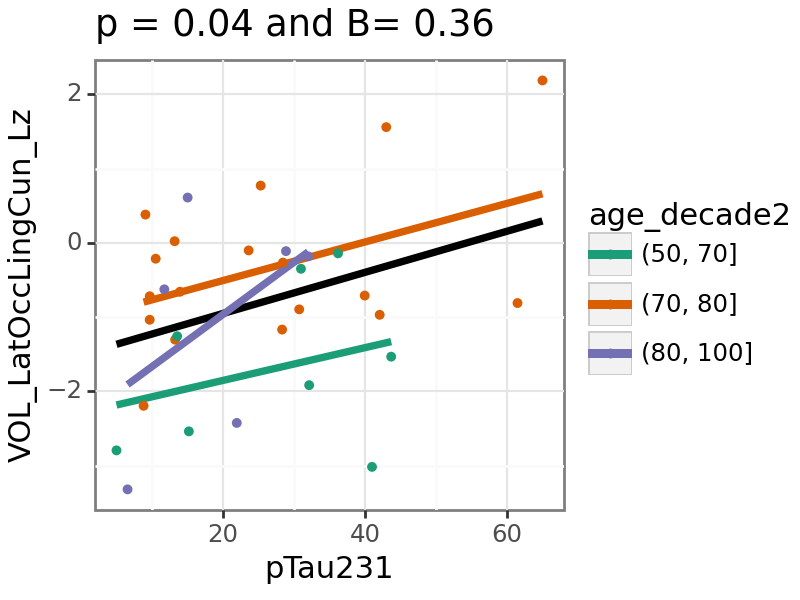

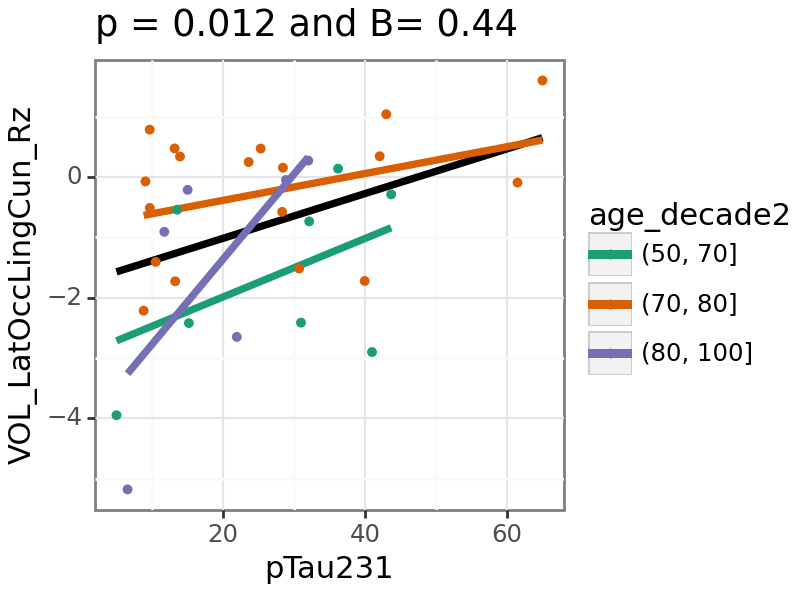

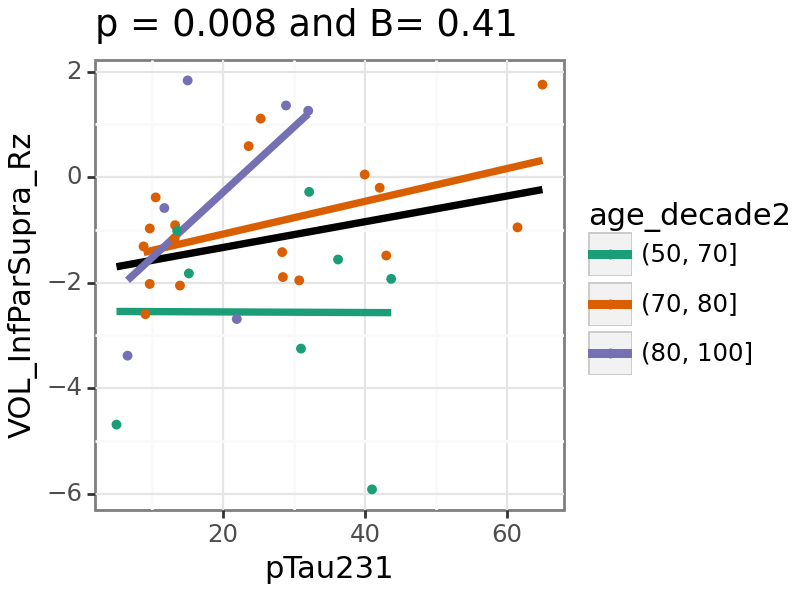

In [27]:
p9.options.figure_size = (4,3)    
var_list = biomarker_relationship_results_log10.loc[
    biomarker_relationship_results_log10['x_var'].isin([x_var]) & (biomarker_relationship_results_log10[pvals_to_consider].min(axis = 1)<graphing_pval), 
    'y_var']

for y_var in var_list.to_list():
    p_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), pvals_to_consider[0]].reset_index(drop=True)[0].round(3).astype('str')
    B_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), Bval_to_grab].reset_index(drop=True)[0].round(2).astype('str')


    subset_data = baseline_trial_data.dropna(subset = [x_var, y_var, 'age_decade2'])
    subset_data2 = subset_data.copy()
    subset_data2 = subset_data2.groupby('age_decade2', observed=True).filter(lambda x: x['ID_ADM'].nunique()> 1)
    plot = (
            p9.ggplot(subset_data, p9.aes(x = x_var, y = y_var, color = 'age_decade2'))
            + p9.theme_bw(base_size = 11)
            + p9.geom_smooth(subset_data, size = 1.5, se = False, alpha = 1, color = 'black', method = 'lm')
            + p9.geom_smooth(subset_data, size = 1.5, se = False, alpha = 1, method = 'lm')
            
            + p9.geom_point(size = 1.0)
            + p9.labs(title = ('p = ' + p_value + ' and B= ' + B_value))
            + p9.scale_color_manual(['#1b9e77', '#d95f02', '#7570b3', '#737373'])
        )
    print(plot)

## GFAP

In [28]:
x_var = 'GFAP'

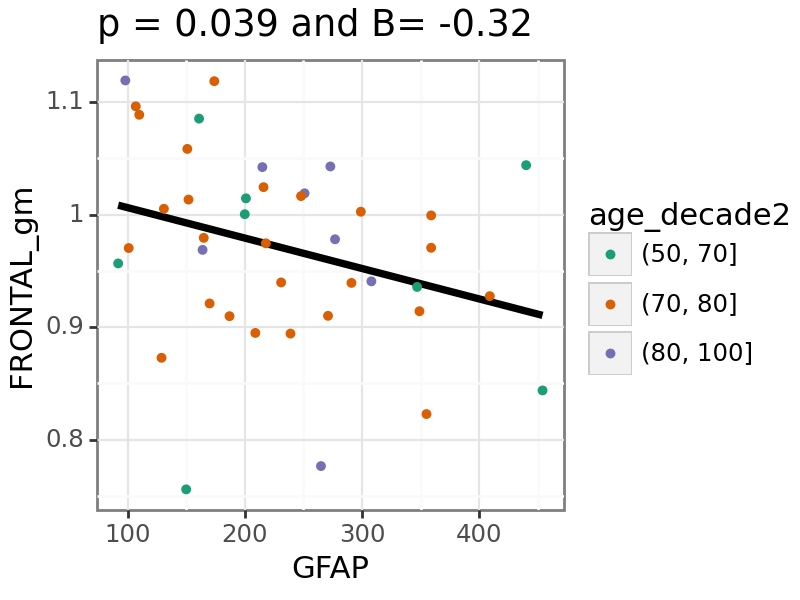

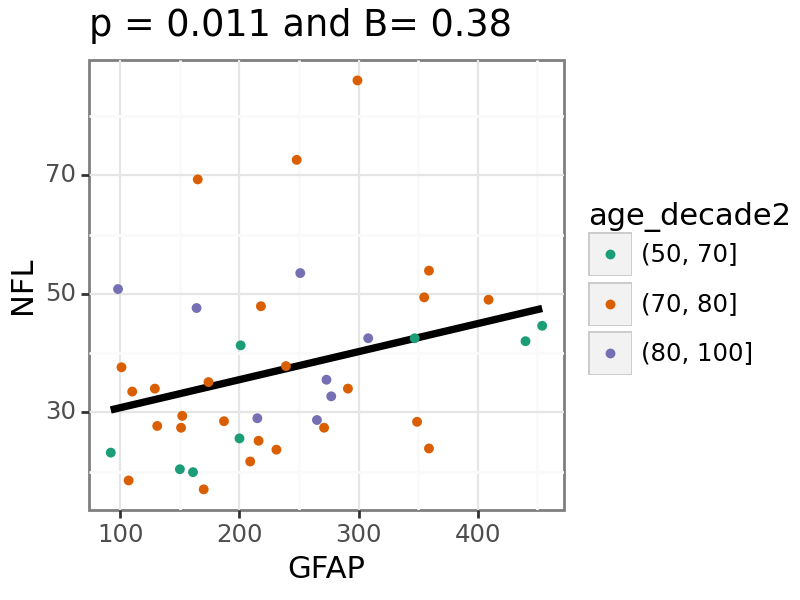

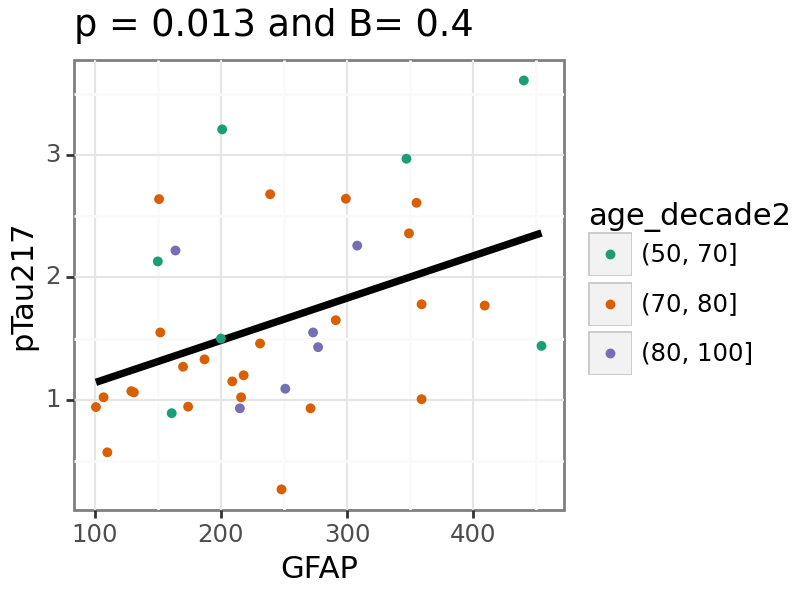

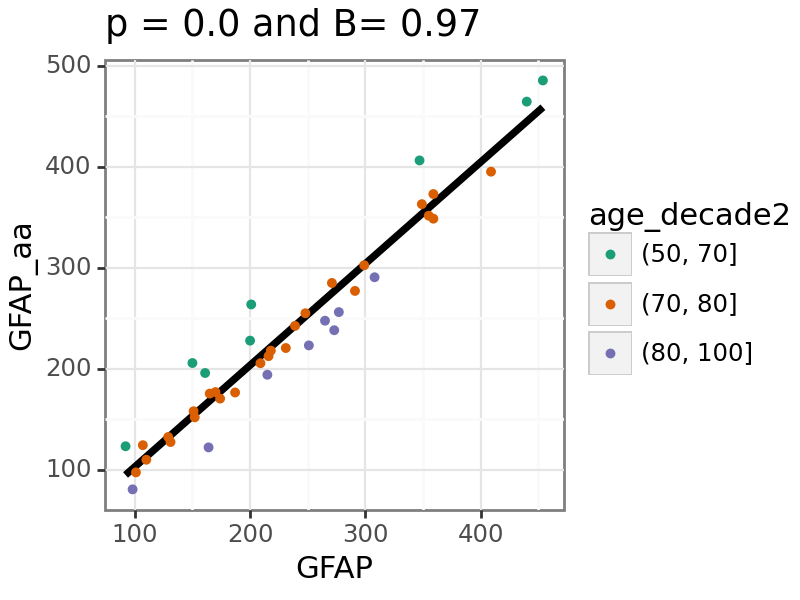

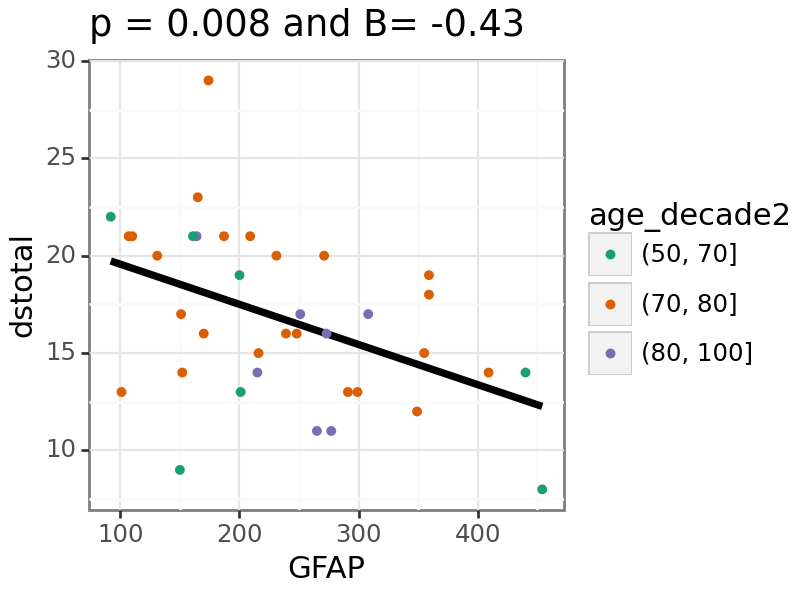

...

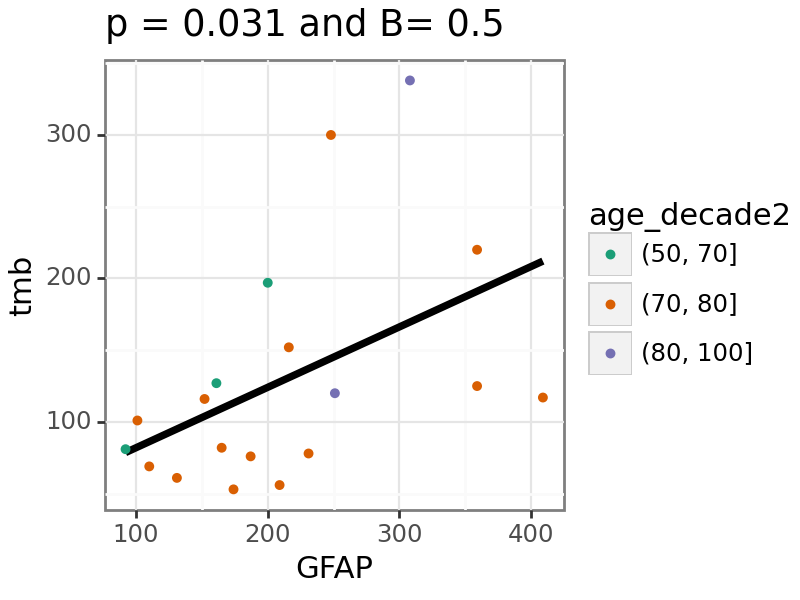

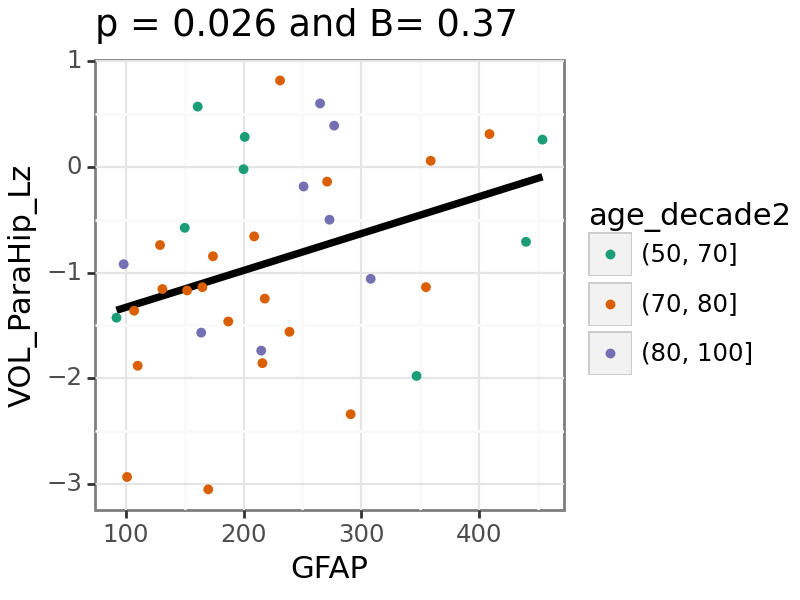

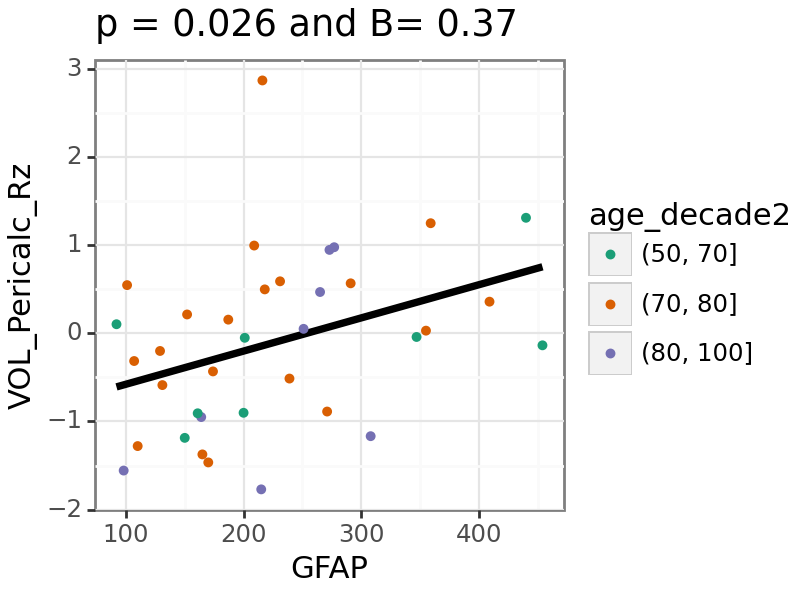

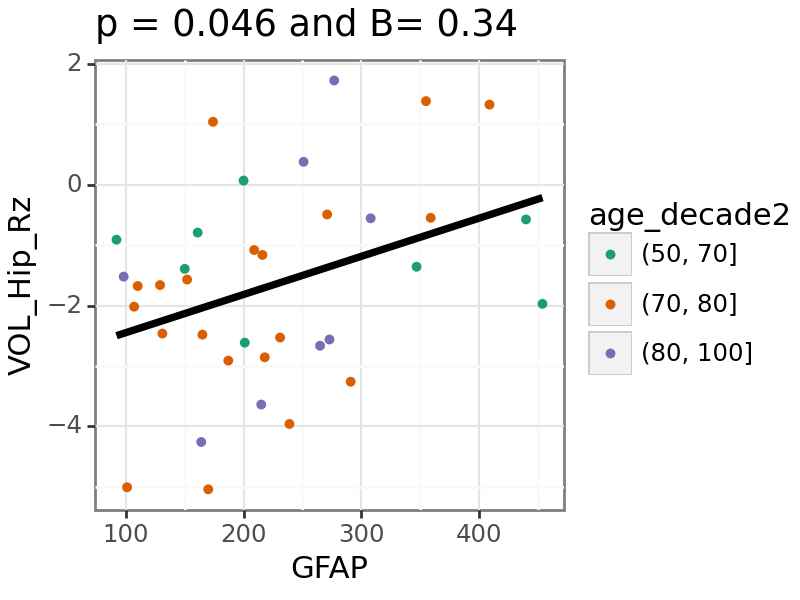

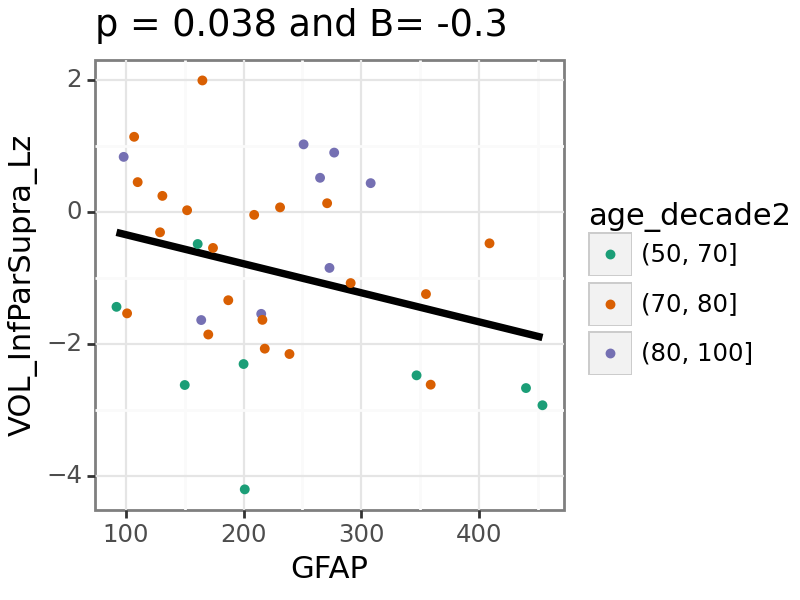

In [29]:
p9.options.figure_size = (4,3)    
var_list = biomarker_relationship_results_log10.loc[
    biomarker_relationship_results_log10['x_var'].isin([x_var]) & (biomarker_relationship_results_log10[pvals_to_consider].min(axis = 1)<graphing_pval), 
    'y_var']

for y_var in var_list.to_list():
    p_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), pvals_to_consider[0]].reset_index(drop=True)[0].round(3).astype('str')
    B_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), Bval_to_grab].reset_index(drop=True)[0].round(2).astype('str')


    subset_data = baseline_trial_data.dropna(subset = [x_var, y_var, 'age_decade2'])
    subset_data2 = subset_data.copy()
    subset_data2 = subset_data2.groupby('age_decade2', observed=True).filter(lambda x: x['ID_ADM'].nunique()> 1)
    plot = (
            p9.ggplot(subset_data, p9.aes(x = x_var, y = y_var, color = 'age_decade2'))
            + p9.theme_bw(base_size = 11)
            + p9.geom_smooth(subset_data, size = 1.5, se = False, alpha = 1, color = 'black', method = 'lm')
            #+ p9.geom_smooth(subset_data2, size = 0.8, se = False, alpha = 1, method = 'lm')
            
            + p9.geom_point(size = 1.0)
            + p9.labs(title = ('p = ' + p_value + ' and B= ' + B_value))
            + p9.scale_color_manual(['#1b9e77', '#d95f02', '#7570b3', '#737373'])
        )
    print(plot)

## NFL

In [30]:
x_var = 'NFL'

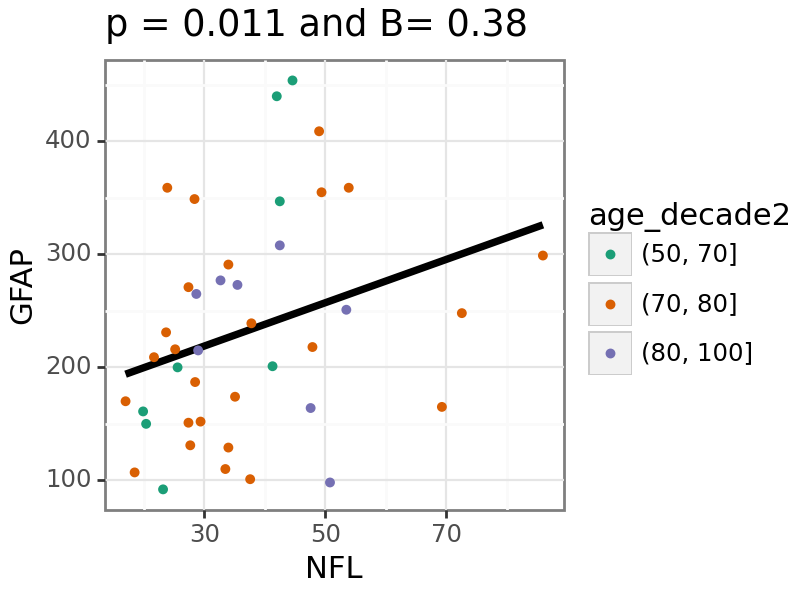

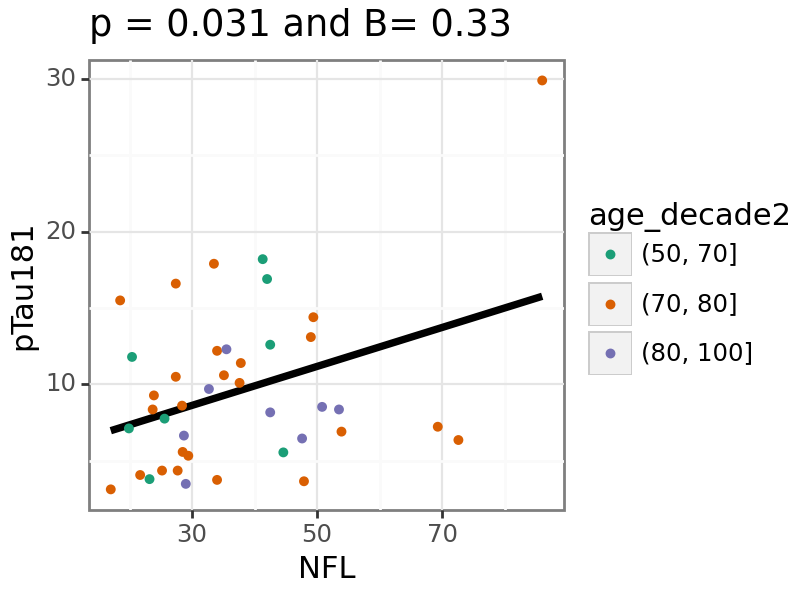

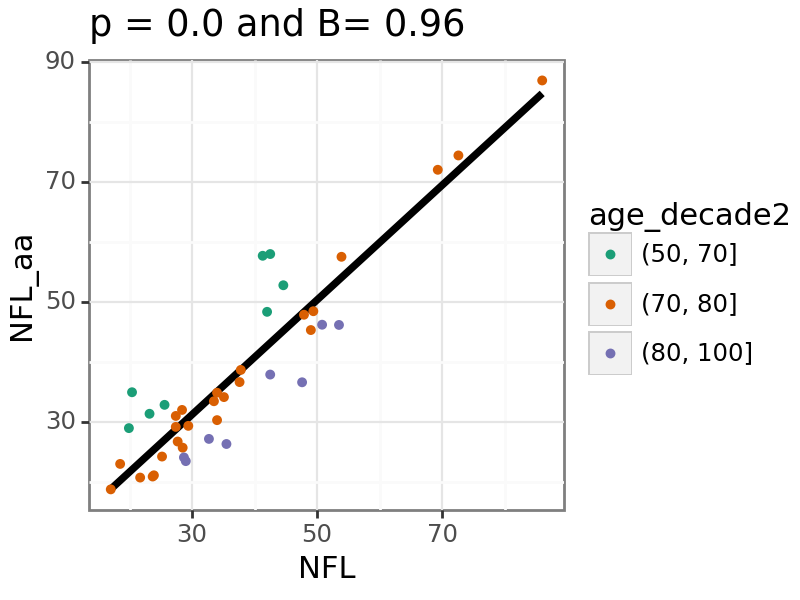

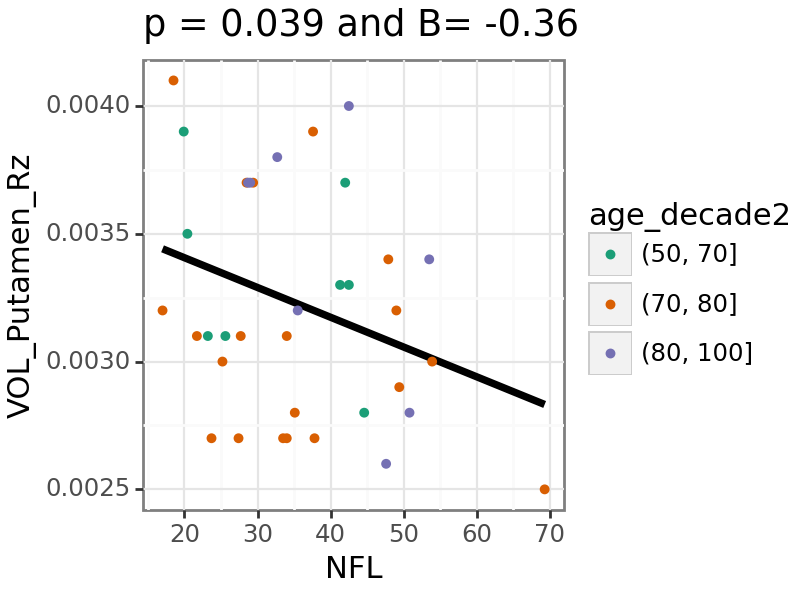

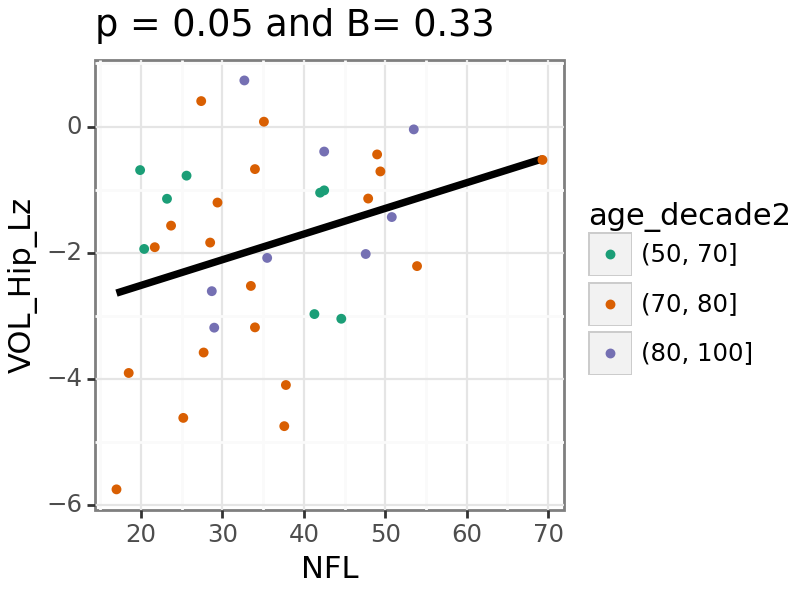

In [31]:
p9.options.figure_size = (4,3)    
var_list = biomarker_relationship_results_log10.loc[
    biomarker_relationship_results_log10['x_var'].isin([x_var]) & (biomarker_relationship_results_log10[pvals_to_consider].min(axis = 1)<graphing_pval), 
    'y_var']

for y_var in var_list.to_list():
    p_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), pvals_to_consider[0]].reset_index(drop=True)[0].round(3).astype('str')
    B_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), Bval_to_grab].reset_index(drop=True)[0].round(2).astype('str')


    subset_data = baseline_trial_data.dropna(subset = [x_var, y_var, 'age_decade2'])
    subset_data2 = subset_data.copy()
    subset_data2 = subset_data2.groupby('age_decade2', observed=True).filter(lambda x: x['ID_ADM'].nunique()> 1)
    plot = (
            p9.ggplot(subset_data, p9.aes(x = x_var, y = y_var, color = 'age_decade2'))
            + p9.theme_bw(base_size = 11)
            + p9.geom_smooth(subset_data, size = 1.5, se = False, alpha = 1, color = 'black', method = 'lm')
            #+ p9.geom_smooth(subset_data2, size = 0.8, se = False, alpha = 1, method = 'lm')
            
            + p9.geom_point(size = 1.0)
            + p9.labs(title = ('p = ' + p_value + ' and B= ' + B_value))
            + p9.scale_color_manual(['#1b9e77', '#d95f02', '#7570b3', '#737373'])
        )
    print(plot)

## ptau 217 / Ab42

In [32]:
x_var = 'pTau217_Ab42'

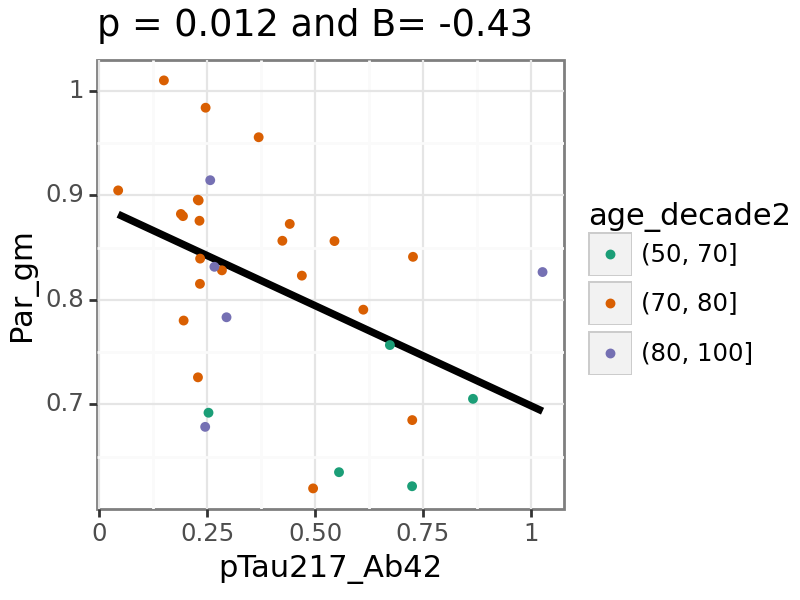

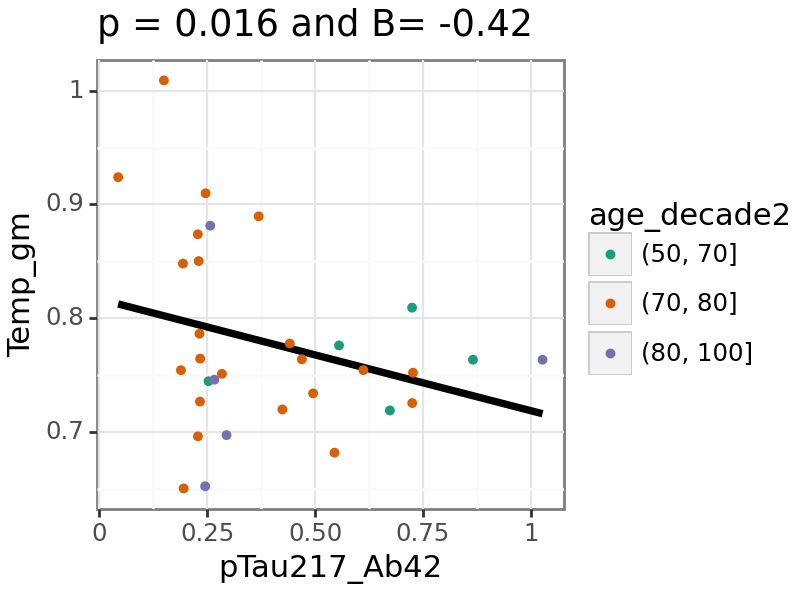

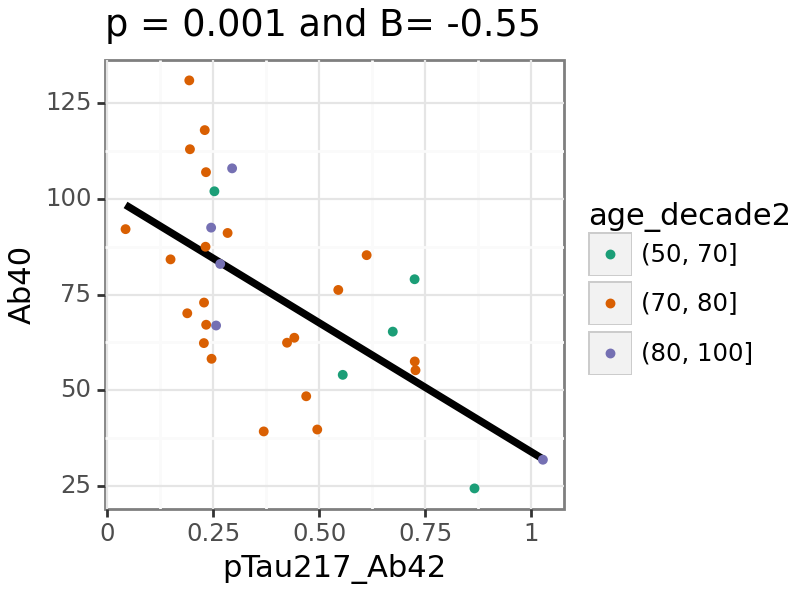

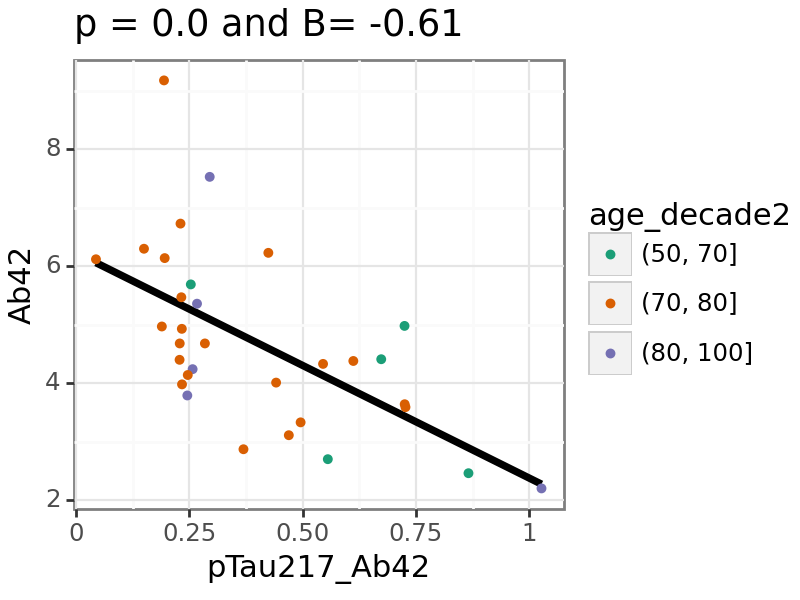

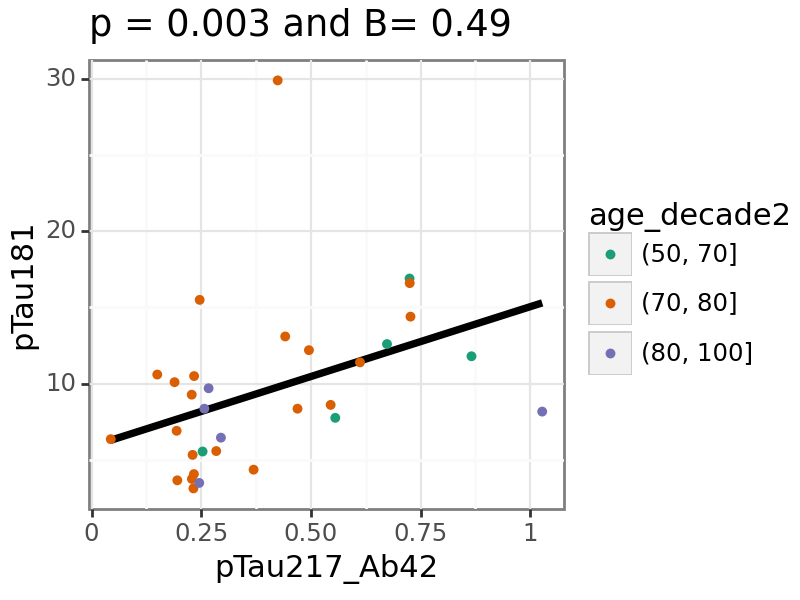

...

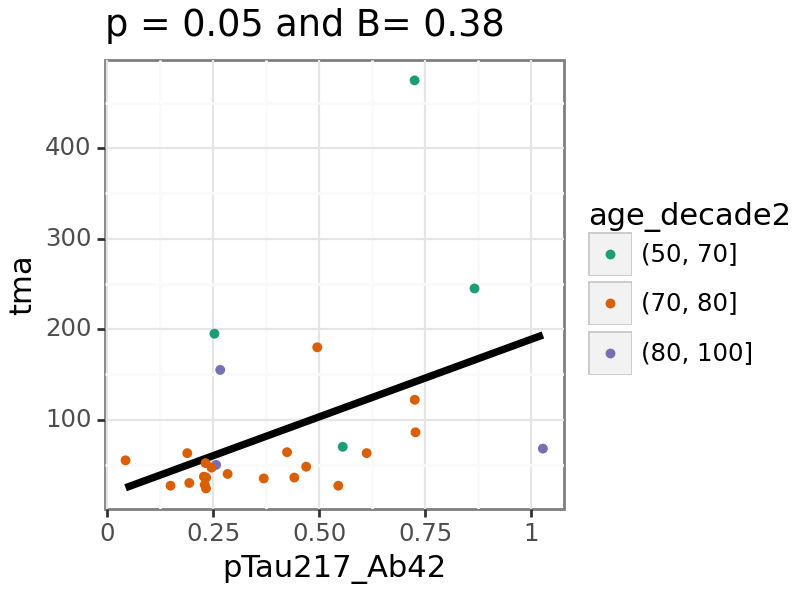

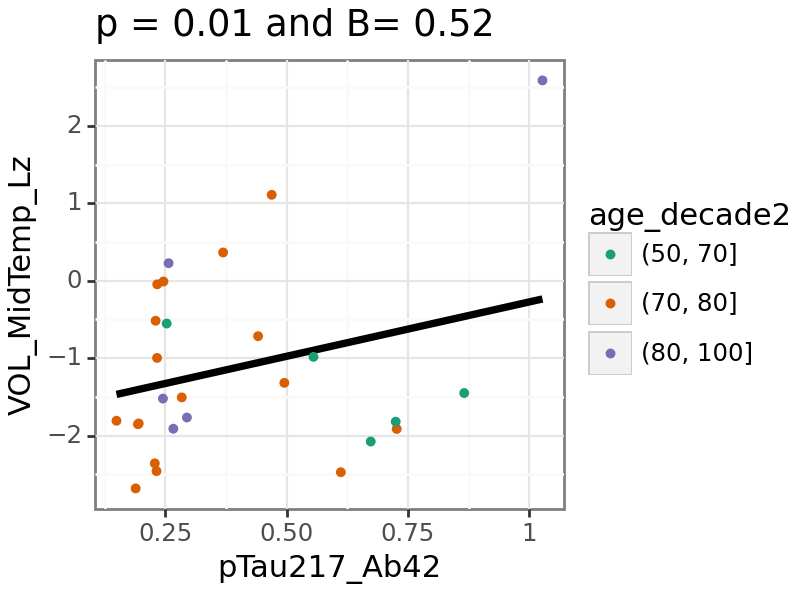

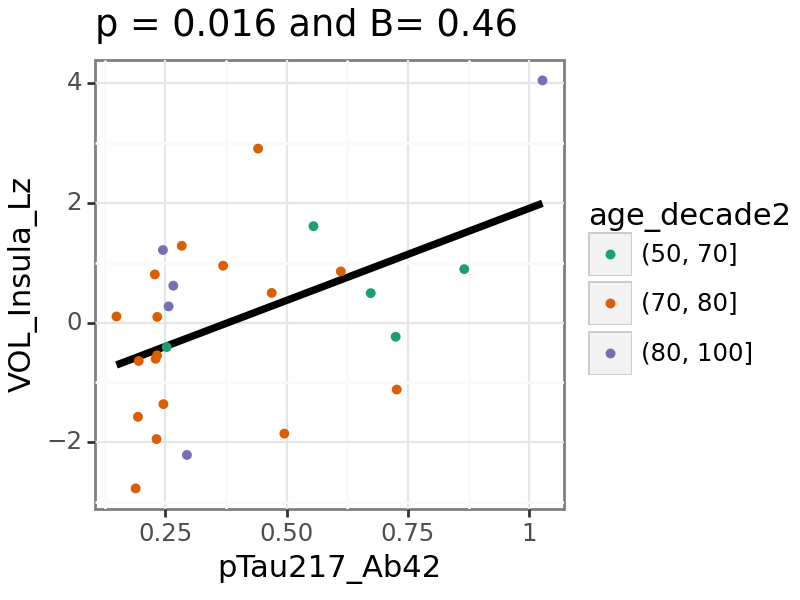

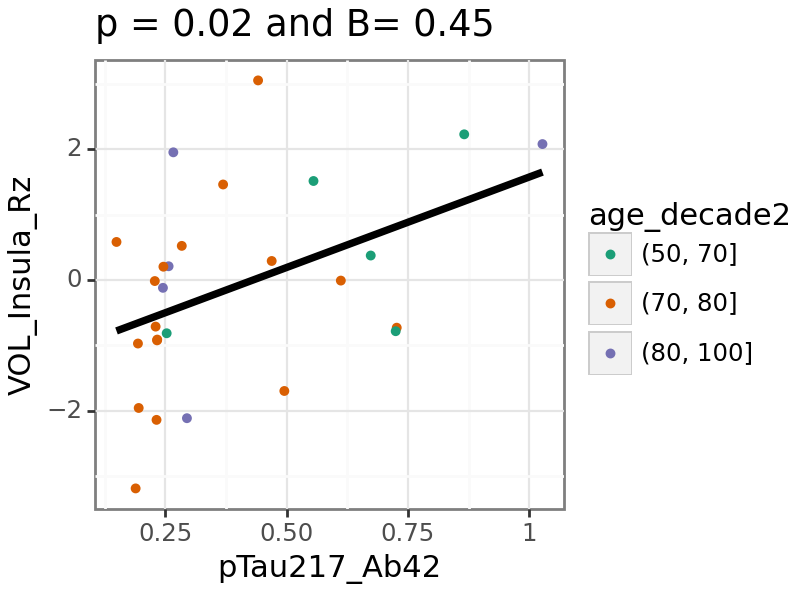

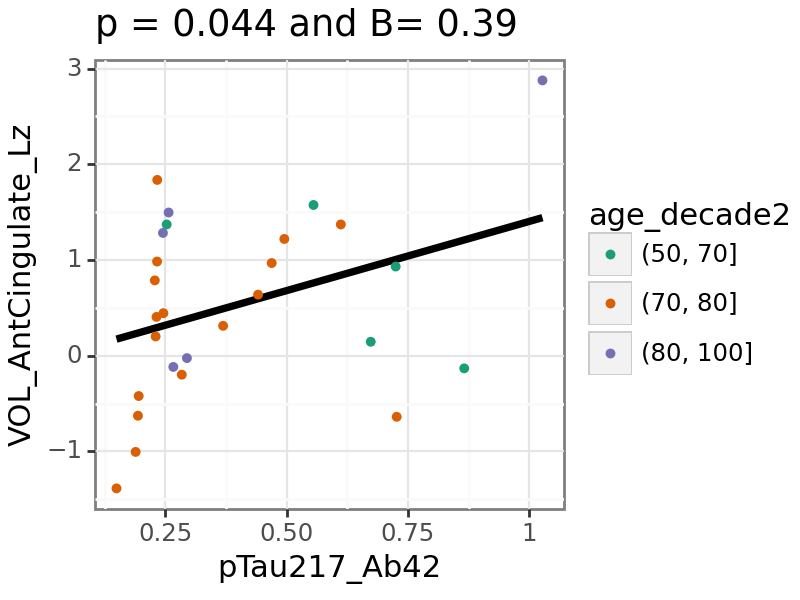

In [33]:
p9.options.figure_size = (4,3)    
var_list = biomarker_relationship_results_log10.loc[
    biomarker_relationship_results_log10['x_var'].isin([x_var]) & (biomarker_relationship_results_log10[pvals_to_consider].min(axis = 1)<graphing_pval), 
    'y_var']

for y_var in var_list.to_list():
    p_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), pvals_to_consider[0]].reset_index(drop=True)[0].round(3).astype('str')
    B_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), Bval_to_grab].reset_index(drop=True)[0].round(2).astype('str')


    subset_data = baseline_trial_data.dropna(subset = [x_var, y_var, 'age_decade2'])
    subset_data2 = subset_data.copy()
    subset_data2 = subset_data2.groupby('age_decade2', observed=True).filter(lambda x: x['ID_ADM'].nunique()> 1)
    plot = (
            p9.ggplot(subset_data, p9.aes(x = x_var, y = y_var, color = 'age_decade2'))
            + p9.theme_bw(base_size = 11)
            + p9.geom_smooth(subset_data, size = 1.5, se = False, alpha = 1, color = 'black', method = 'lm')
            #+ p9.geom_smooth(subset_data2, size = 0.8, se = False, alpha = 1, method = 'lm')
            
            + p9.geom_point(size = 1.0)
            + p9.labs(title = ('p = ' + p_value + ' and B= ' + B_value))
            + p9.scale_color_manual(['#1b9e77', '#d95f02', '#7570b3', '#737373'])
        )
    print(plot)

# Exploring the relationships that have the opposite direction than what we expect : checking if other factors can explain

In [34]:
baseline_trial_data['MMSE_bin'] = pd.qcut(baseline_trial_data['MMSE'], [0, .33, .66, 1.], precision = 2).astype('str')
baseline_trial_data['cdrsum_bin'] = pd.qcut(baseline_trial_data['cdrsum'], [0, .33, .66, 1.], precision = 2).astype('str')
baseline_trial_data['Ab42_40_log10_bin'] = pd.qcut(baseline_trial_data['Ab42_40_log10'], [0, .33, .66, 1.], precision = 2).astype('str')
baseline_trial_data['pTau217_log10_bin'] = pd.qcut(baseline_trial_data['pTau217_log10'], [0, .33, .66, 1.], precision = 2).astype('str')
baseline_trial_data['GFAP_log10_bin'] = pd.qcut(baseline_trial_data['GFAP_log10'], [0, .33, .66, 1.], precision = 2).astype('str')
baseline_trial_data['NFL_log10_bin'] = pd.qcut(baseline_trial_data['NFL_log10'], [0, .33, .66, 1.], precision = 2).astype('str')
baseline_trial_data['VOL_Hip_Rz_bin'] = pd.qcut(baseline_trial_data['VOL_Hip_Rz'], [0, .33, .66, 1.], precision = 2).astype('str')

C:\Users\Lauren.Koenig\AppData\Local\Temp\4\ipykernel_38248\4187745018.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\Lauren.Koenig\AppData\Local\Temp\4\ipykernel_38248\4187745018.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\Users\Lauren.Koenig\AppData\Local\Temp\4\ipykernel_38248\4187745018.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https:

## Do we see the relationships for all age groups

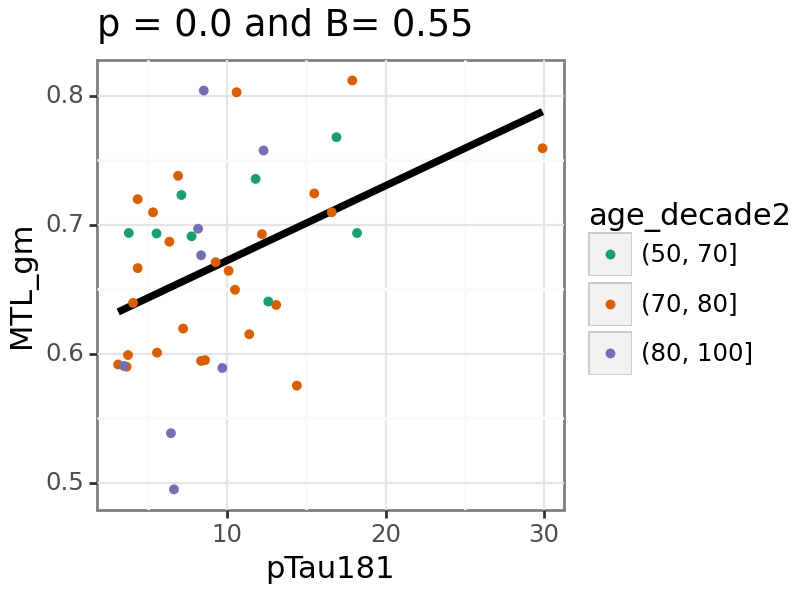

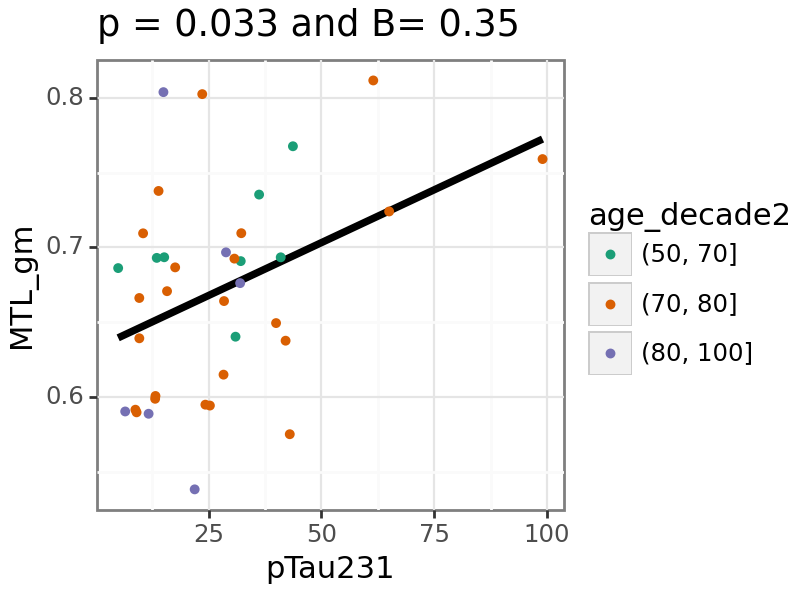

In [35]:
p9.options.figure_size = (4,3)  

for y_var in[ele for ele in ['Avg_Hip', 'MTL_gm'] if ele in all_data.columns]:
    for x_var in ['pTau181', 'pTau231']:
        p_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), pvals_to_consider[0]].reset_index(drop=True)[0].round(3).astype('str')
        B_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), Bval_to_grab].reset_index(drop=True)[0].round(2).astype('str')

        subset_data = baseline_trial_data.dropna(subset = [x_var, y_var, 'age_decade2'])
        subset_data2 = subset_data.copy()
        subset_data2 = subset_data2.groupby('age_decade2', observed=True).filter(lambda x: x['ID_ADM'].nunique()> 5)
        plot = (
                p9.ggplot(subset_data, p9.aes(x = x_var, y = y_var, color = 'age_decade2'))
                + p9.theme_bw(base_size = 11)
                + p9.geom_smooth(subset_data, size = 1.5, se = False, alpha = 1, color = 'black', method = 'lm')
                #+ p9.geom_smooth(subset_data2, size = 0.8, se = False, alpha = 1, method = 'lm')
                
                + p9.geom_point(size = 1.0)
                + p9.labs(title = ('p = ' + p_value + ' and B= ' + B_value))
                + p9.scale_color_manual(['#1b9e77', '#d95f02', '#7570b3', '#737373'])
            )
        print(plot)

## Do we see the relationships for all CDR sum of boxes

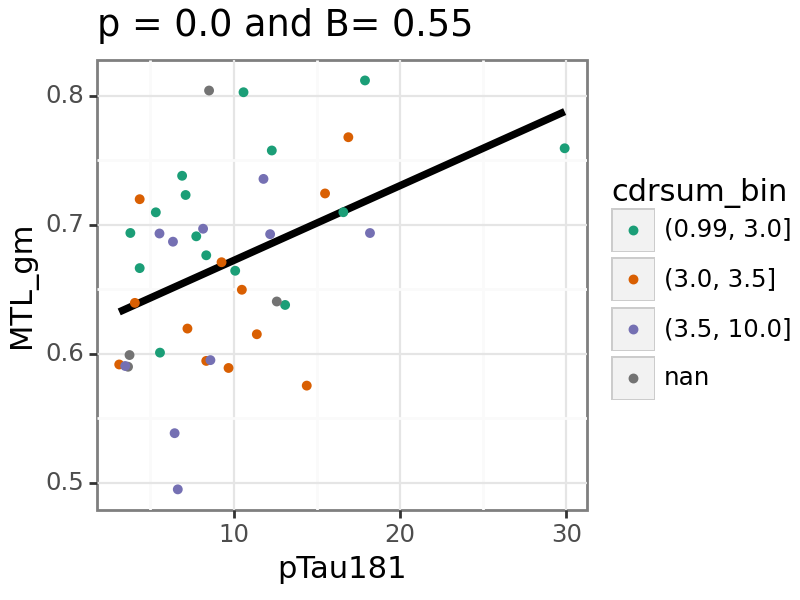

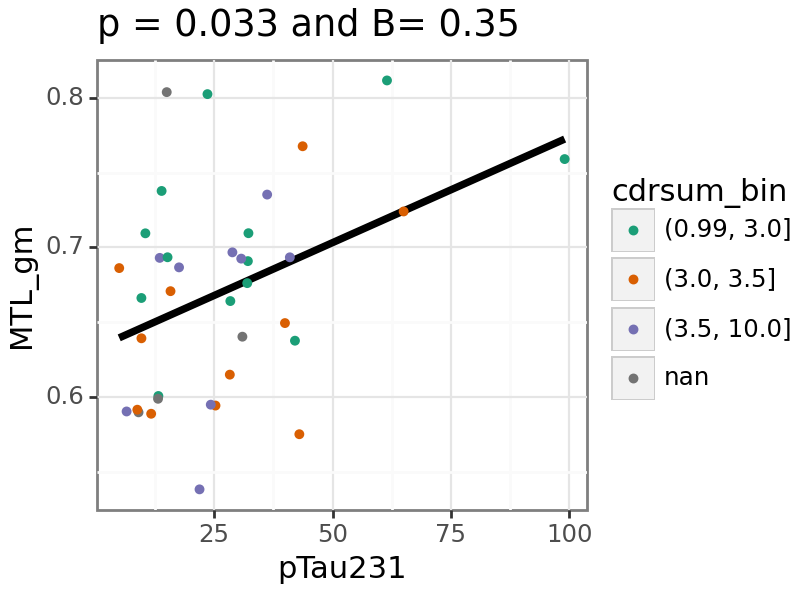

In [36]:
p9.options.figure_size = (4,3)  

for y_var in [ele for ele in ['Avg_Hip', 'MTL_gm'] if ele in all_data.columns]:
    for x_var in ['pTau181', 'pTau231']:

        p_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), pvals_to_consider[0]].reset_index(drop=True)[0].round(3).astype('str')
        B_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), Bval_to_grab].reset_index(drop=True)[0].round(2).astype('str')

        subset_data = baseline_trial_data.dropna(subset = [x_var, y_var, 'age_decade2'])
        subset_data2 = subset_data.copy()
        subset_data2 = subset_data2.groupby('cdrsum_bin', observed=True).filter(lambda x: x['ID_ADM'].nunique()> 5)
        plot = (
                p9.ggplot(subset_data, p9.aes(x = x_var, y = y_var, color = 'cdrsum_bin'))
                + p9.theme_bw(base_size = 11)
                + p9.geom_smooth(subset_data, size = 1.5, se = False, alpha = 1, color = 'black', method = 'lm')
                #+ p9.geom_smooth(subset_data2, size = 0.8, se = False, alpha = 1, method = 'lm')
                
                + p9.geom_point(size = 1.0)
                + p9.labs(title = ('p = ' + p_value + ' and B= ' + B_value))
                + p9.scale_color_manual(['#1b9e77', '#d95f02', '#7570b3', '#737373'])
            )
        print(plot)



## Do we see the relationships for all CDR 

C:\Users\Lauren.Koenig\AppData\Local\Temp\4\ipykernel_38248\4246220671.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


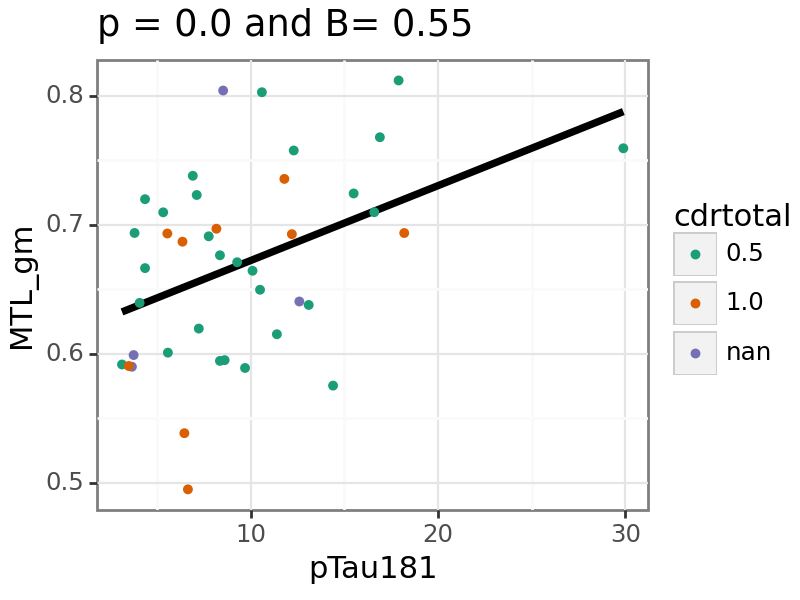

C:\Users\Lauren.Koenig\AppData\Local\Temp\4\ipykernel_38248\4246220671.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


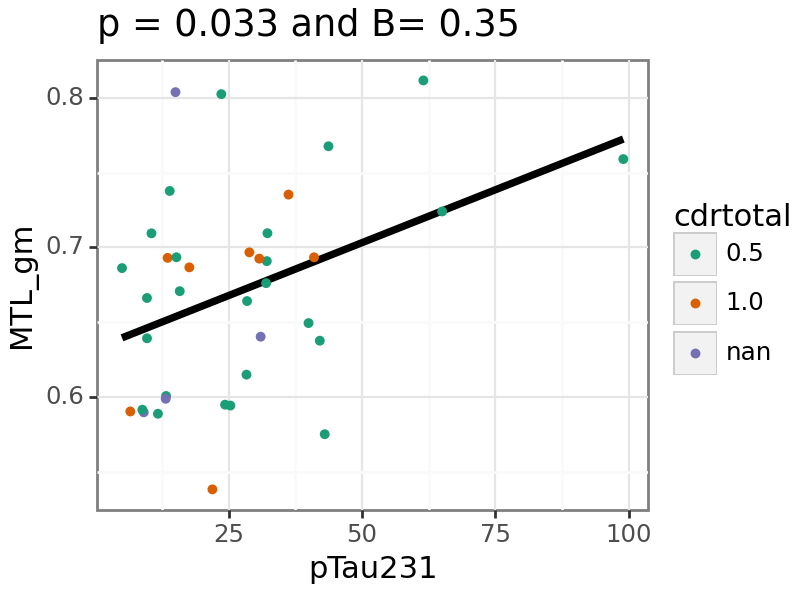

In [37]:
p9.options.figure_size = (4,3)  

for y_var in[ele for ele in ['Avg_Hip', 'MTL_gm'] if ele in all_data.columns]:
    for x_var in ['pTau181', 'pTau231']:
        p_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), pvals_to_consider[0]].reset_index(drop=True)[0].round(3).astype('str')
        B_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), Bval_to_grab].reset_index(drop=True)[0].round(2).astype('str')

        subset_data = baseline_trial_data.dropna(subset = [x_var, y_var, 'age_decade2'])
        subset_data['cdrtotal'] = subset_data['cdrtotal'].astype('str')
        subset_data2 = subset_data.copy()
        subset_data2 = subset_data2.groupby('cdrtotal', observed=True).filter(lambda x: x['ID_ADM'].nunique()> 5)
        plot = (
                p9.ggplot(subset_data, p9.aes(x = x_var, y = y_var, color = 'cdrtotal'))
                + p9.theme_bw(base_size = 11)
                + p9.geom_smooth(subset_data, size = 1.5, se = False, alpha = 1, color = 'black', method = 'lm')
                #+ p9.geom_smooth(subset_data2, size = 0.8, se = False, alpha = 1, method = 'lm')
                
                + p9.geom_point(size = 1.0)
                + p9.labs(title = ('p = ' + p_value + ' and B= ' + B_value))
                + p9.scale_color_manual(['#1b9e77', '#d95f02', '#7570b3', '#737373'])
            )
        print(plot)

## Do we see the relationships for all MMSE

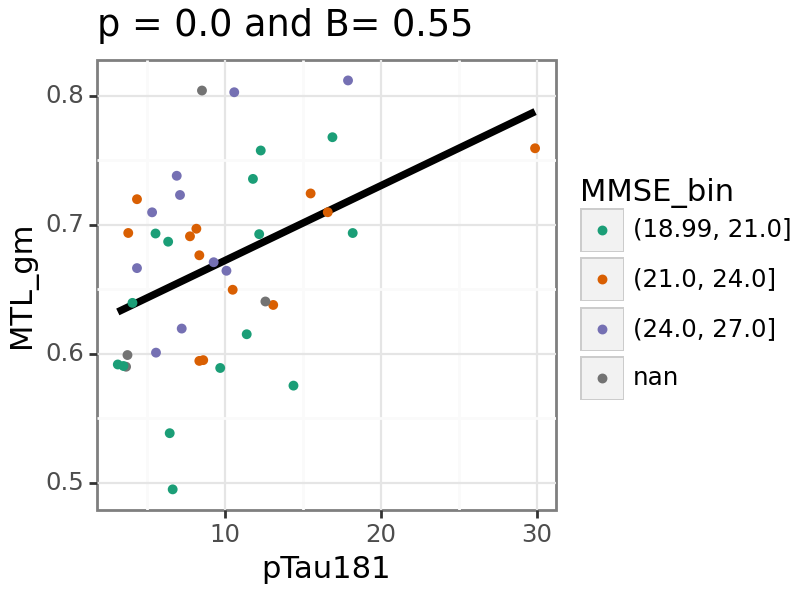

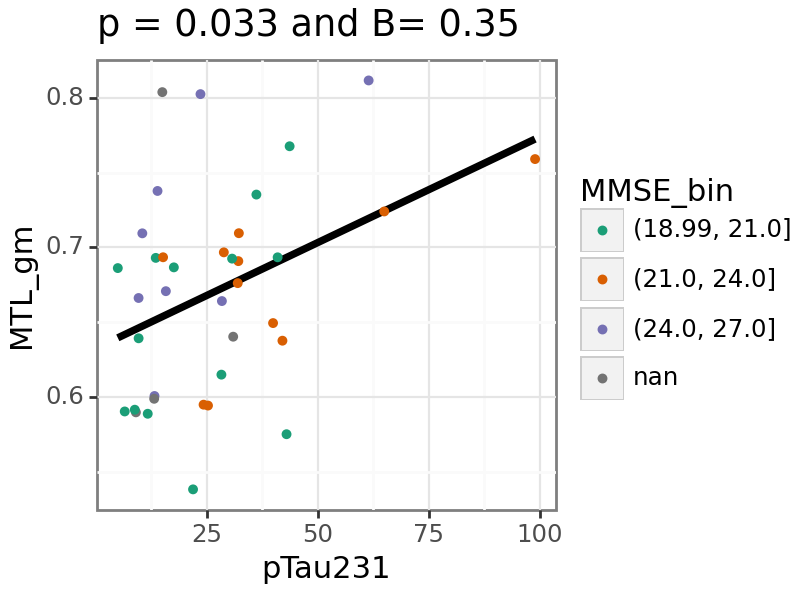

In [38]:
p9.options.figure_size = (4,3)  

for y_var in[ele for ele in ['Avg_Hip', 'MTL_gm'] if ele in all_data.columns]:
    for x_var in ['pTau181', 'pTau231']:

        p_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), pvals_to_consider[0]].reset_index(drop=True)[0].round(3).astype('str')
        B_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), Bval_to_grab].reset_index(drop=True)[0].round(2).astype('str')

        subset_data = baseline_trial_data.dropna(subset = [x_var, y_var, 'age_decade2'])
        subset_data2 = subset_data.copy()
        subset_data2 = subset_data2.groupby('MMSE_bin', observed=True).filter(lambda x: x['ID_ADM'].nunique()> 5)
        plot = (
                p9.ggplot(subset_data, p9.aes(x = x_var, y = y_var, color = 'MMSE_bin'))
                + p9.theme_bw(base_size = 11)
                + p9.geom_smooth(subset_data, size = 1.5, se = False, alpha = 1, color = 'black', method = 'lm')
                #+ p9.geom_smooth(subset_data2, size = 0.8, se = False, alpha = 1, method = 'lm')
                
                + p9.geom_point(size = 1.0)
                + p9.labs(title = ('p = ' + p_value + ' and B= ' + B_value))
                + p9.scale_color_manual(['#1b9e77', '#d95f02', '#7570b3', '#737373'])
            )
        print(plot)

## Do we see the relationships for all levels of Ab42/40 

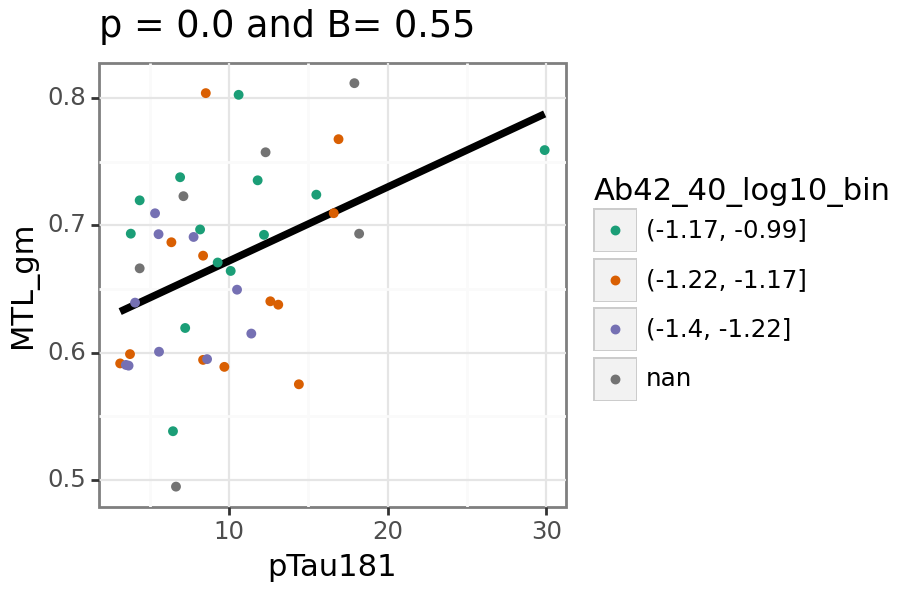

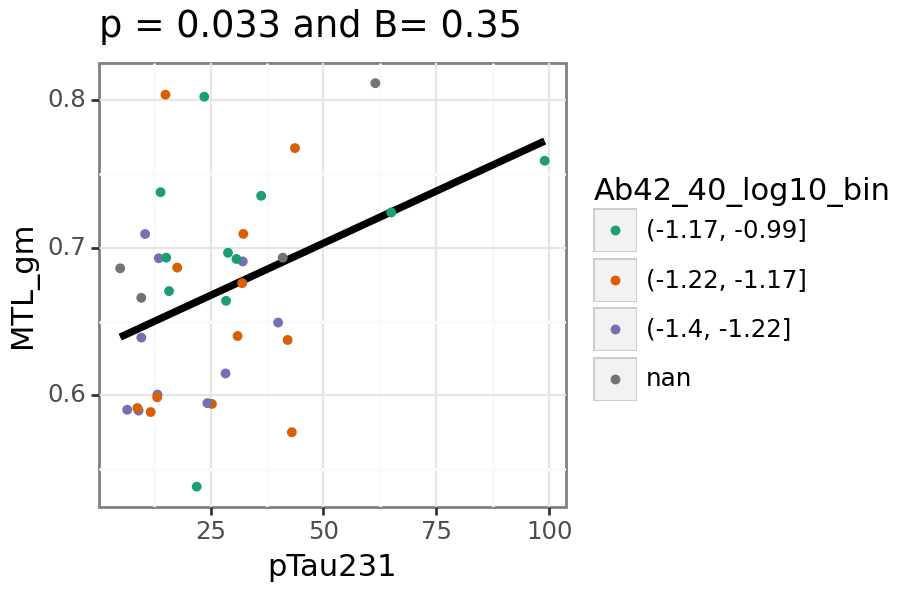

In [39]:
p9.options.figure_size = (4.5,3)  

for y_var in[ele for ele in ['Avg_Hip', 'MTL_gm'] if ele in all_data.columns]:
    for x_var in ['pTau181', 'pTau231']:

        p_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), pvals_to_consider[0]].reset_index(drop=True)[0].round(3).astype('str')
        B_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), Bval_to_grab].reset_index(drop=True)[0].round(2).astype('str')

        subset_data = baseline_trial_data.dropna(subset = [x_var, y_var, 'age_decade2'])
        subset_data2 = subset_data.copy()
        subset_data2 = subset_data2.groupby('Ab42_40_log10_bin', observed=True).filter(lambda x: x['ID_ADM'].nunique()> 5)
        plot = (
                p9.ggplot(subset_data, p9.aes(x = x_var, y = y_var, color = 'Ab42_40_log10_bin'))
                + p9.theme_bw(base_size = 11)
                + p9.geom_smooth(subset_data, size = 1.5, se = False, alpha = 1, color = 'black', method = 'lm')
                #+ p9.geom_smooth(subset_data2, size = 0.8, se = False, alpha = 1, method = 'lm')
                
                + p9.geom_point(size = 1.0)
                + p9.labs(title = ('p = ' + p_value + ' and B= ' + B_value))
                + p9.scale_color_manual(['#1b9e77', '#d95f02', '#7570b3', '#737373'])
            )
        print(plot)

## Do we see the relationships for all levels of pTau217

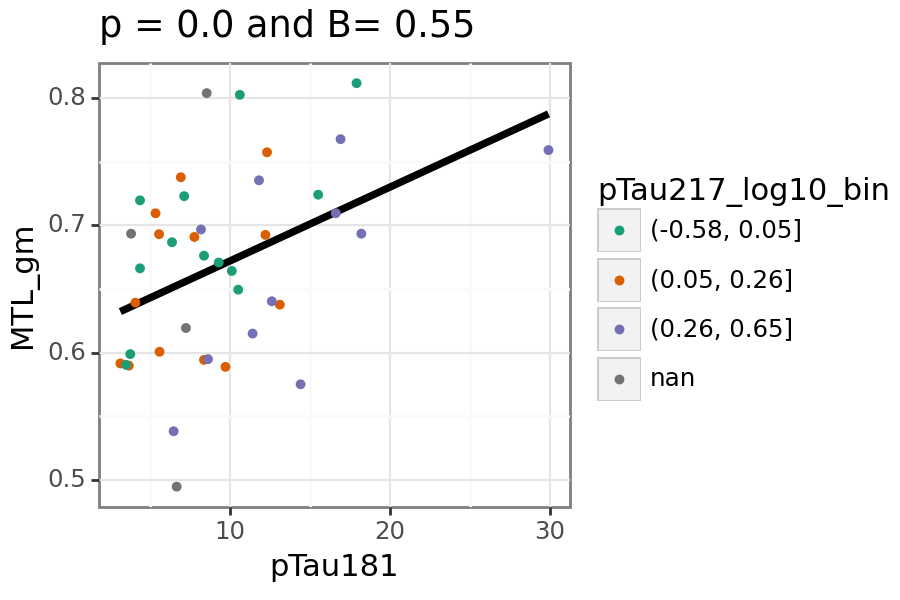

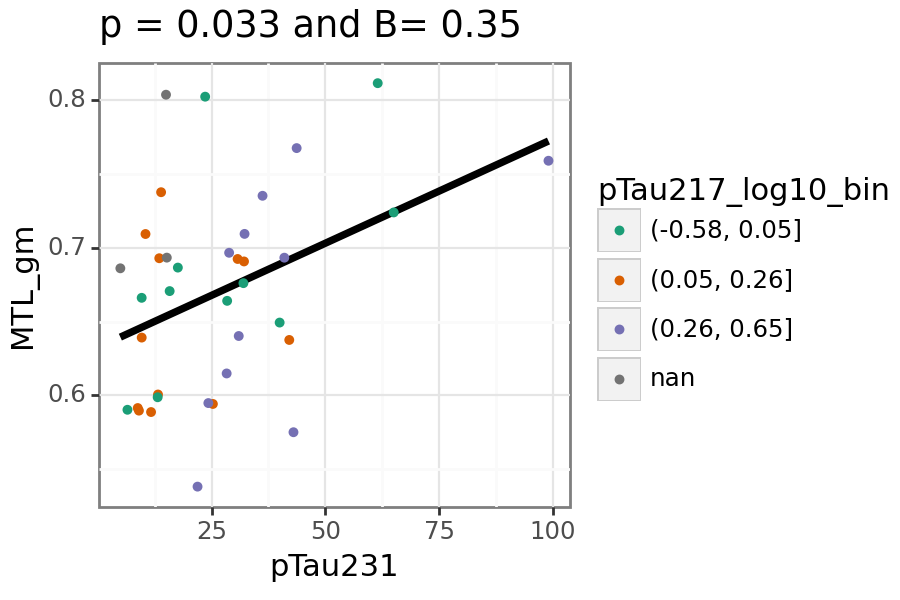

In [40]:
p9.options.figure_size = (4.5,3)  

for y_var in[ele for ele in ['Avg_Hip', 'MTL_gm'] if ele in all_data.columns]:
    for x_var in ['pTau181', 'pTau231']:
        p_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), pvals_to_consider[0]].reset_index(drop=True)[0].round(3).astype('str')
        B_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), Bval_to_grab].reset_index(drop=True)[0].round(2).astype('str')

        subset_data = baseline_trial_data.dropna(subset = [x_var, y_var, 'age_decade2'])
        subset_data2 = subset_data.copy()
        subset_data2 = subset_data2.groupby('pTau217_log10_bin', observed=True).filter(lambda x: x['ID_ADM'].nunique()> 5)
        plot = (
                p9.ggplot(subset_data, p9.aes(x = x_var, y = y_var, color = 'pTau217_log10_bin'))
                + p9.theme_bw(base_size = 11)
                + p9.geom_smooth(subset_data, size = 1.5, se = False, alpha = 1, color = 'black', method = 'lm')
                #+ p9.geom_smooth(subset_data2, size = 0.8, se = False, alpha = 1, method = 'lm')
                
                + p9.geom_point(size = 1.0)
                + p9.labs(title = ('p = ' + p_value + ' and B= ' + B_value))
                + p9.scale_color_manual(['#1b9e77', '#d95f02', '#7570b3', '#737373'])
            )
        print(plot)

## Do we see the relationships for all levels of GFAP

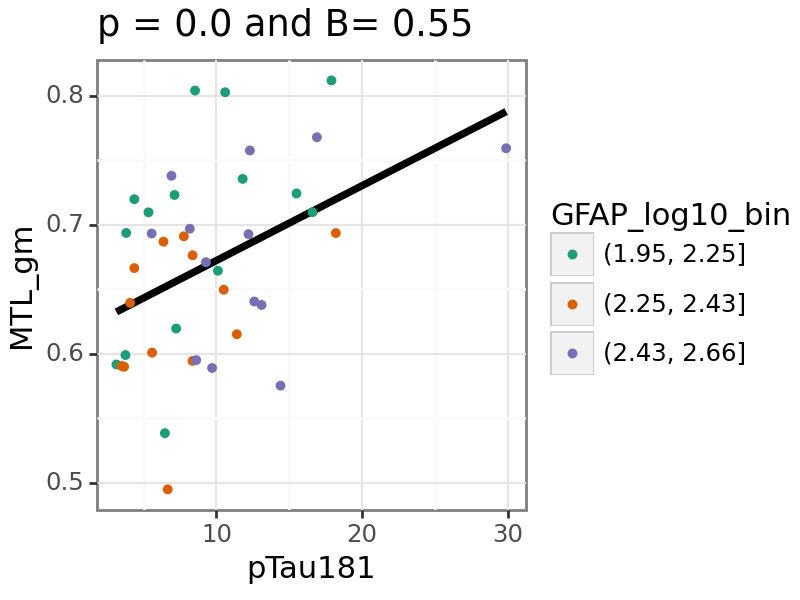

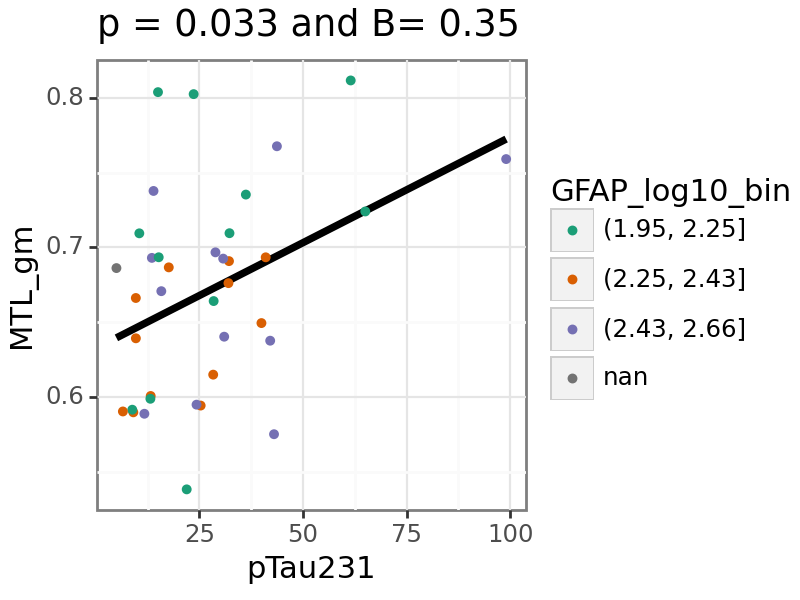

In [41]:
p9.options.figure_size = (4,3)  

for y_var in[ele for ele in ['Avg_Hip', 'MTL_gm'] if ele in all_data.columns]:
    for x_var in ['pTau181', 'pTau231']:
        p_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), pvals_to_consider[0]].reset_index(drop=True)[0].round(3).astype('str')
        B_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), Bval_to_grab].reset_index(drop=True)[0].round(2).astype('str')

        subset_data = baseline_trial_data.dropna(subset = [x_var, y_var, 'age_decade2'])
        subset_data2 = subset_data.copy()
        subset_data2 = subset_data2.groupby('GFAP_log10_bin', observed=True).filter(lambda x: x['ID_ADM'].nunique()> 5)
        plot = (
                p9.ggplot(subset_data, p9.aes(x = x_var, y = y_var, color = 'GFAP_log10_bin'))
                + p9.theme_bw(base_size = 11)
                + p9.geom_smooth(subset_data, size = 1.5, se = False, alpha = 1, color = 'black', method = 'lm')
                #+ p9.geom_smooth(subset_data2, size = 0.8, se = False, alpha = 1, method = 'lm')
                
                + p9.geom_point(size = 1.0)
                + p9.labs(title = ('p = ' + p_value + ' and B= ' + B_value))
                + p9.scale_color_manual(['#1b9e77', '#d95f02', '#7570b3', '#737373'])
            )
        print(plot)

## Do we see the relationships for all levels of NFL

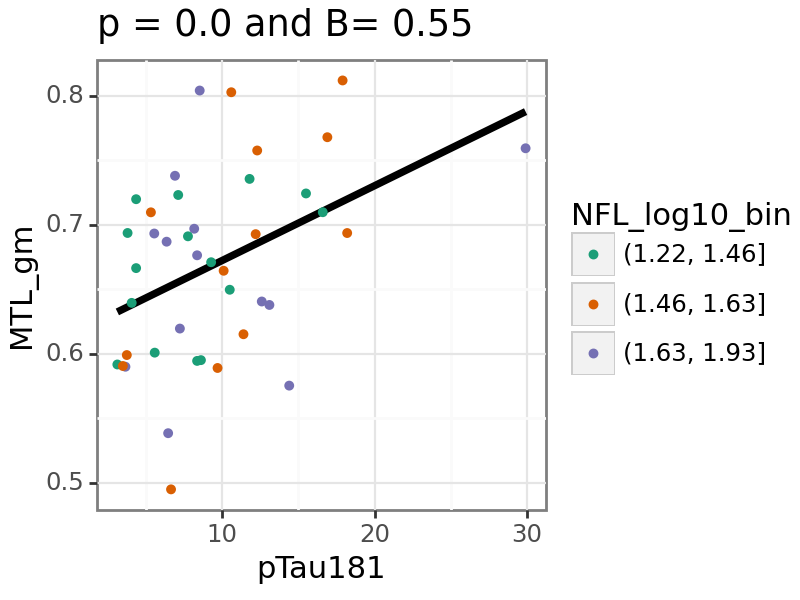

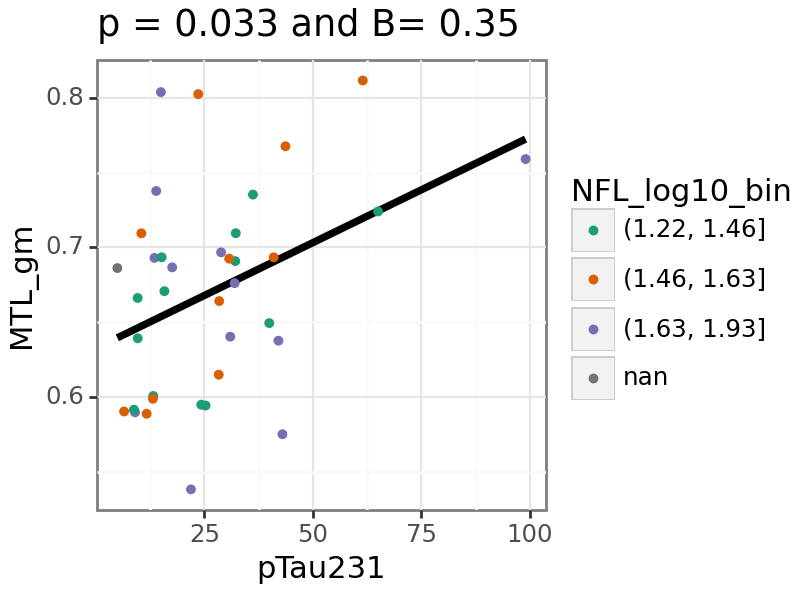

In [42]:
p9.options.figure_size = (4,3)  

for y_var in[ele for ele in ['Avg_Hip', 'MTL_gm'] if ele in all_data.columns]:
    for x_var in ['pTau181', 'pTau231']:
        p_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), pvals_to_consider[0]].reset_index(drop=True)[0].round(3).astype('str')
        B_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), Bval_to_grab].reset_index(drop=True)[0].round(2).astype('str')

        subset_data = baseline_trial_data.dropna(subset = [x_var, y_var, 'age_decade2'])
        subset_data2 = subset_data.copy()
        subset_data2 = subset_data2.groupby('NFL_log10_bin', observed=True).filter(lambda x: x['ID_ADM'].nunique()> 5)
        plot = (
                p9.ggplot(subset_data, p9.aes(x = x_var, y = y_var, color = 'NFL_log10_bin'))
                + p9.theme_bw(base_size = 11)
                + p9.geom_smooth(subset_data, size = 1.5, se = False, alpha = 1, color = 'black', method = 'lm')
                #+ p9.geom_smooth(subset_data2, size = 0.8, se = False, alpha = 1, method = 'lm')
                
                + p9.geom_point(size = 1.0)
                + p9.labs(title = ('p = ' + p_value + ' and B= ' + B_value))
                + p9.scale_color_manual(['#1b9e77', '#d95f02', '#7570b3', '#737373'])
            )
        print(plot)

## Do we see the relationships for all levels of Hip Vol

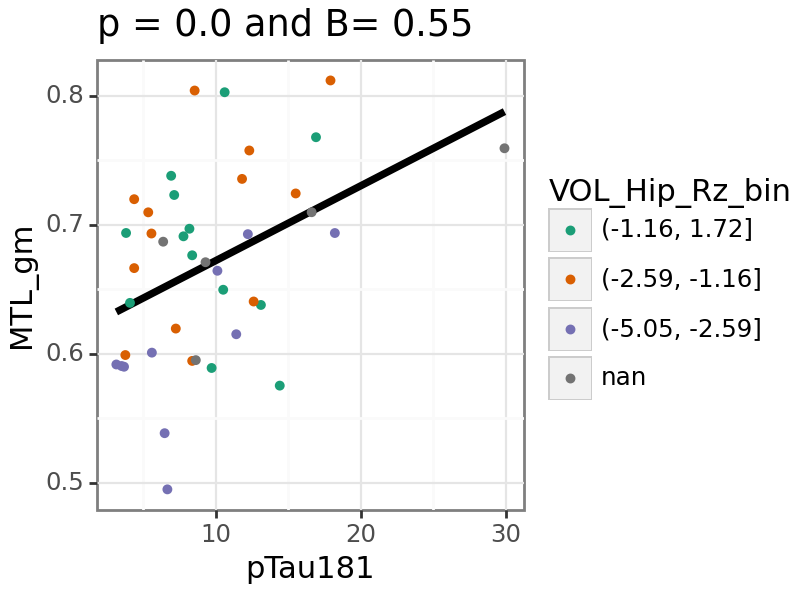

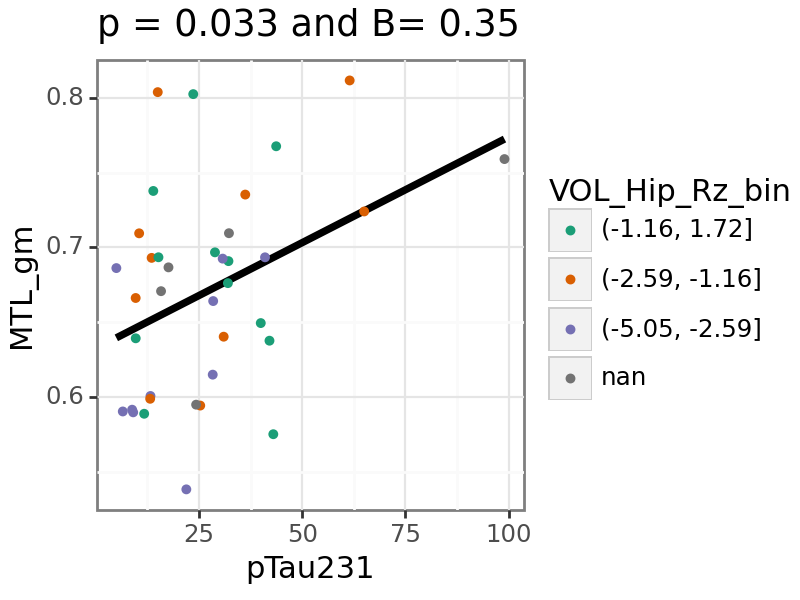

In [43]:
p9.options.figure_size = (4,3)  

for y_var in[ele for ele in ['Avg_Hip', 'MTL_gm'] if ele in all_data.columns]:
    for x_var in ['pTau181', 'pTau231']:
        p_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), pvals_to_consider[0]].reset_index(drop=True)[0].round(3).astype('str')
        B_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), Bval_to_grab].reset_index(drop=True)[0].round(2).astype('str')

        subset_data = baseline_trial_data.dropna(subset = [x_var, y_var, 'age_decade2'])
        subset_data2 = subset_data.copy()
        subset_data2 = subset_data2.groupby('VOL_Hip_Rz_bin', observed=True).filter(lambda x: x['ID_ADM'].nunique()> 5)
        plot = (
                p9.ggplot(subset_data, p9.aes(x = x_var, y = y_var, color = 'VOL_Hip_Rz_bin'))
                + p9.theme_bw(base_size = 11)
                + p9.geom_smooth(subset_data, size = 1.5, se = False, alpha = 1, color = 'black', method = 'lm')
                #+ p9.geom_smooth(subset_data2, size = 0.8, se = False, alpha = 1, method = 'lm')
                
                + p9.geom_point(size = 1.0)
                + p9.labs(title = ('p = ' + p_value + ' and B= ' + B_value))
                + p9.scale_color_manual(['#1b9e77', '#d95f02', '#7570b3', '#737373'])
            )
        print(plot)

# Additional Graphs 11/19/2024

## ptau v ptau separated by age group

pTau217 pTau231


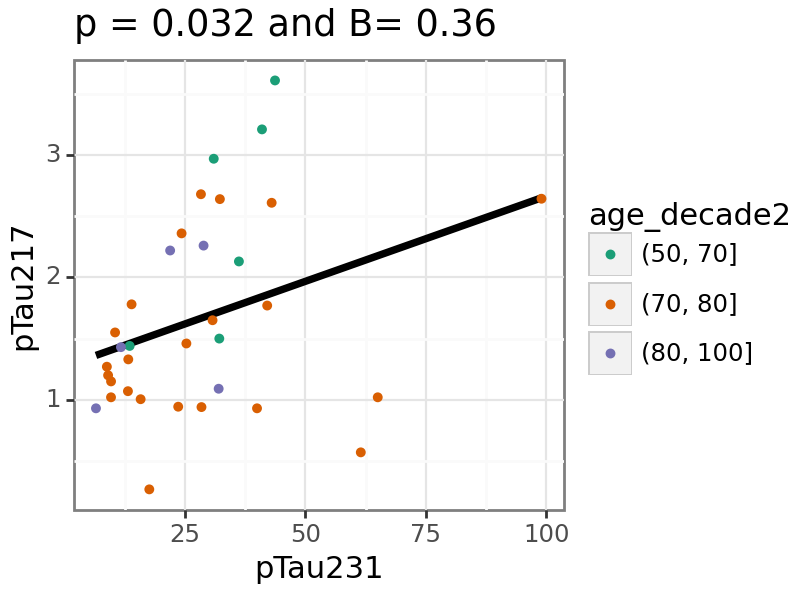


pTau217 pTau181


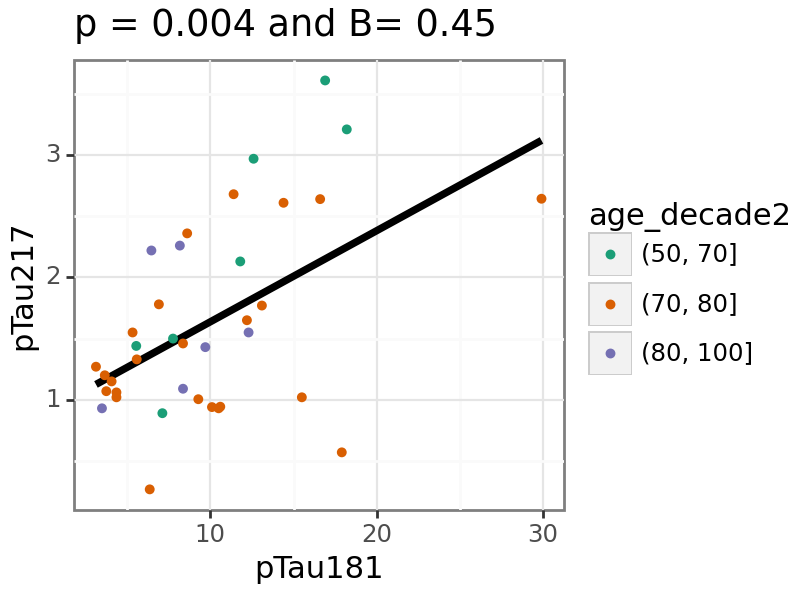


pTau181 pTau231


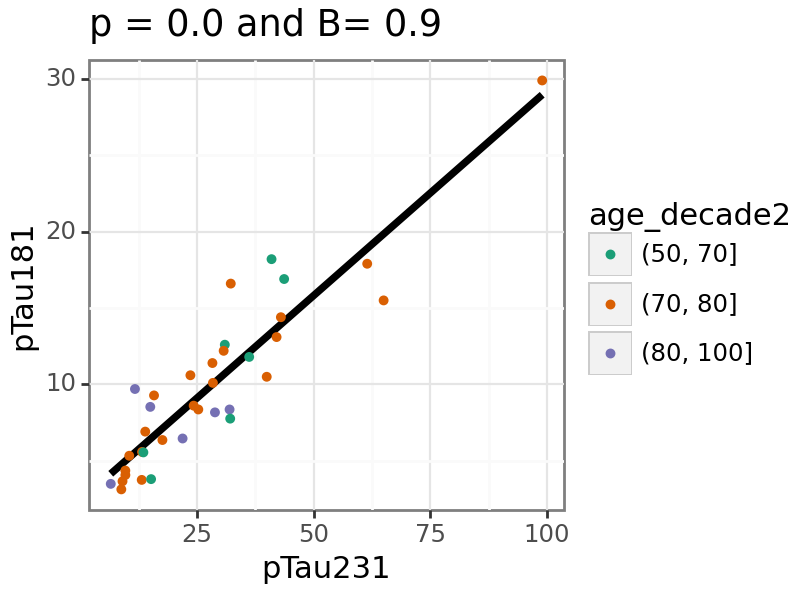

In [44]:

y_var = 'pTau217'
x_var = 'pTau231'
print(y_var, x_var)

p_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), pvals_to_consider[0]].reset_index(drop=True)[0].round(3).astype('str')
B_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), Bval_to_grab].reset_index(drop=True)[0].round(2).astype('str')

subset_data = baseline_trial_data.dropna(subset = [x_var, y_var, 'age_decade2'])
subset_data2 = subset_data.copy()
subset_data2 = subset_data2.groupby('age_decade2', observed=True).filter(lambda x: x['ID_ADM'].nunique()> 4)
p9.options.figure_size = (4,3)  
plot = (
        p9.ggplot(subset_data, p9.aes(x = x_var, y = y_var, color = 'age_decade2'))
        + p9.theme_bw(base_size = 11)
        + p9.geom_smooth(subset_data, size = 1.5, se = False, alpha = 1, color = 'black', method = 'lm')
        #+ p9.geom_smooth(subset_data2, size = 0.8, se = False, alpha = 1, method = 'lm')
        
        + p9.geom_point(size = 1.0)
        + p9.labs(title = ('p = ' + p_value + ' and B= ' + B_value))
        + p9.scale_color_manual(['#1b9e77', '#d95f02', '#7570b3', '#737373'])
    )
print(plot)



y_var = 'pTau217'
x_var = 'pTau181'
print(y_var, x_var)

p_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), pvals_to_consider[0]].reset_index(drop=True)[0].round(3).astype('str')
B_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), Bval_to_grab].reset_index(drop=True)[0].round(2).astype('str')

subset_data = baseline_trial_data.dropna(subset = [x_var, y_var, 'age_decade2'])
subset_data2 = subset_data.copy()
subset_data2 = subset_data2.groupby('age_decade2', observed=True).filter(lambda x: x['ID_ADM'].nunique()> 4)
p9.options.figure_size = (4,3)  
plot = (
        p9.ggplot(subset_data, p9.aes(x = x_var, y = y_var, color = 'age_decade2'))
        + p9.theme_bw(base_size = 11)
        + p9.geom_smooth(subset_data, size = 1.5, se = False, alpha = 1, color = 'black', method = 'lm')
        #+ p9.geom_smooth(subset_data2, size = 0.8, se = False, alpha = 1, method = 'lm')
        
        + p9.geom_point(size = 1.0)
        + p9.labs(title = ('p = ' + p_value + ' and B= ' + B_value))
        + p9.scale_color_manual(['#1b9e77', '#d95f02', '#7570b3', '#737373'])
    )
print(plot)


y_var = 'pTau181'
x_var = 'pTau231'
print(y_var, x_var)

p_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), pvals_to_consider[0]].reset_index(drop=True)[0].round(3).astype('str')
B_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), Bval_to_grab].reset_index(drop=True)[0].round(2).astype('str')

subset_data = baseline_trial_data.dropna(subset = [x_var, y_var, 'age_decade2'])
subset_data2 = subset_data.copy()
subset_data2 = subset_data2.groupby('age_decade2', observed=True).filter(lambda x: x['ID_ADM'].nunique()> 4)
p9.options.figure_size = (4,3)  
plot = (
        p9.ggplot(subset_data, p9.aes(x = x_var, y = y_var, color = 'age_decade2'))
        + p9.theme_bw(base_size = 11)
        + p9.geom_smooth(subset_data, size = 1.5, se = False, alpha = 1, color = 'black', method = 'lm')
        #+ p9.geom_smooth(subset_data2, size = 0.8, se = False, alpha = 1, method = 'lm')
        
        + p9.geom_point(size = 1.0)
        + p9.labs(title = ('p = ' + p_value + ' and B= ' + B_value))
        + p9.scale_color_manual(['#1b9e77', '#d95f02', '#7570b3', '#737373'])
    )
print(plot)


## All ptaus v all volumes, separated by age group

VOL_Precun_Lz pTau217


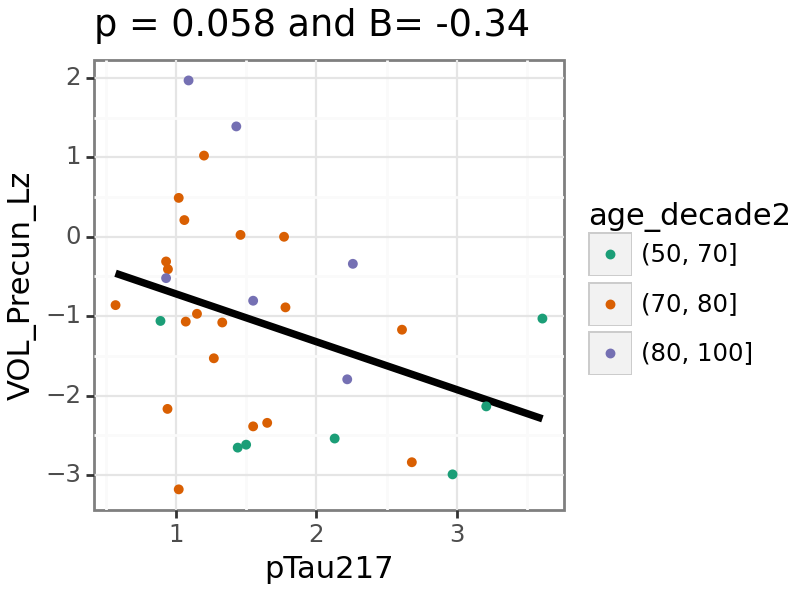


VOL_Precun_Lz pTau181


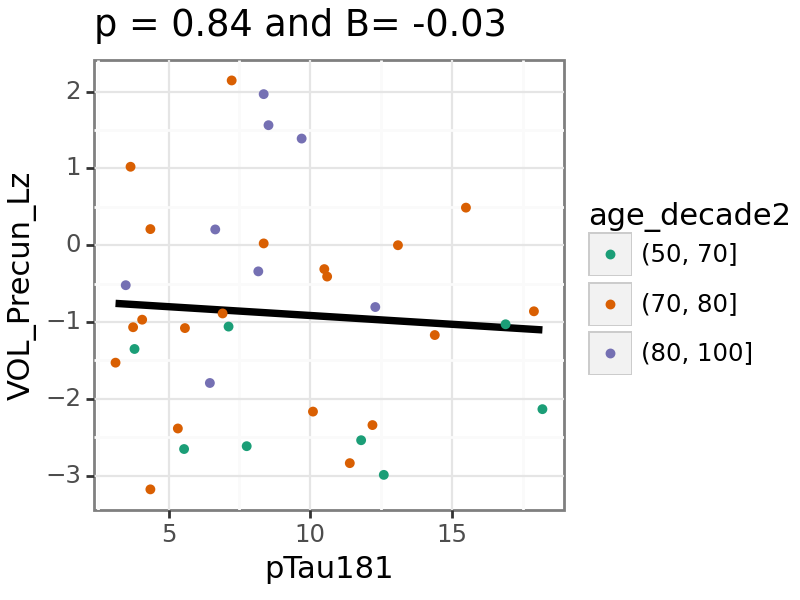


VOL_Precun_Lz pTau231


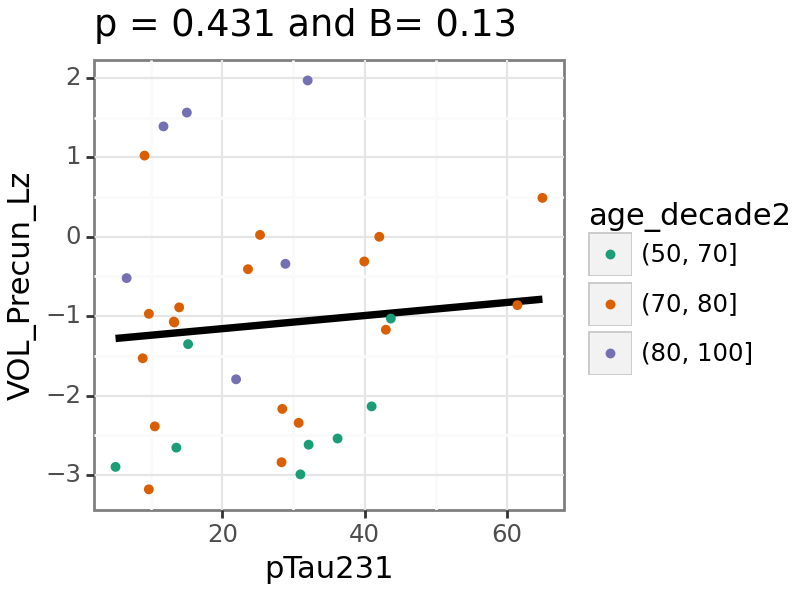


VOL_Precun_Rz pTau217


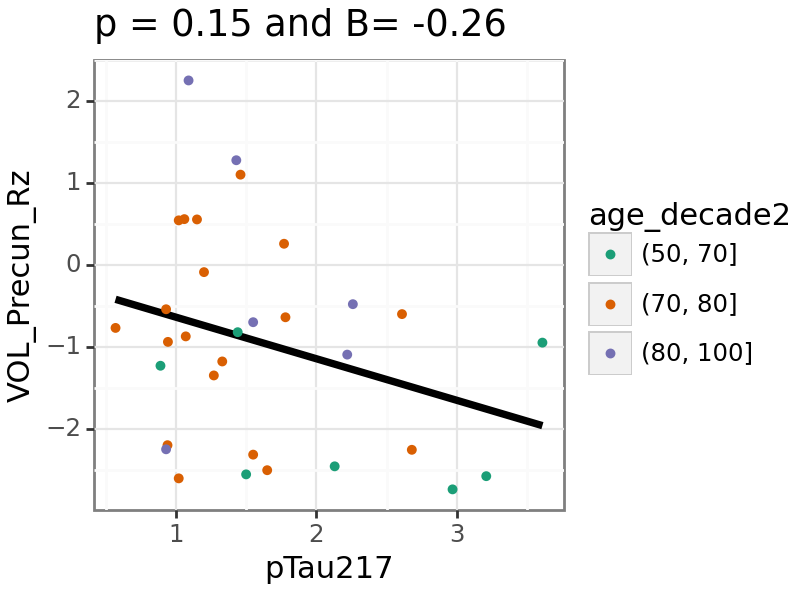


VOL_Precun_Rz pTau181


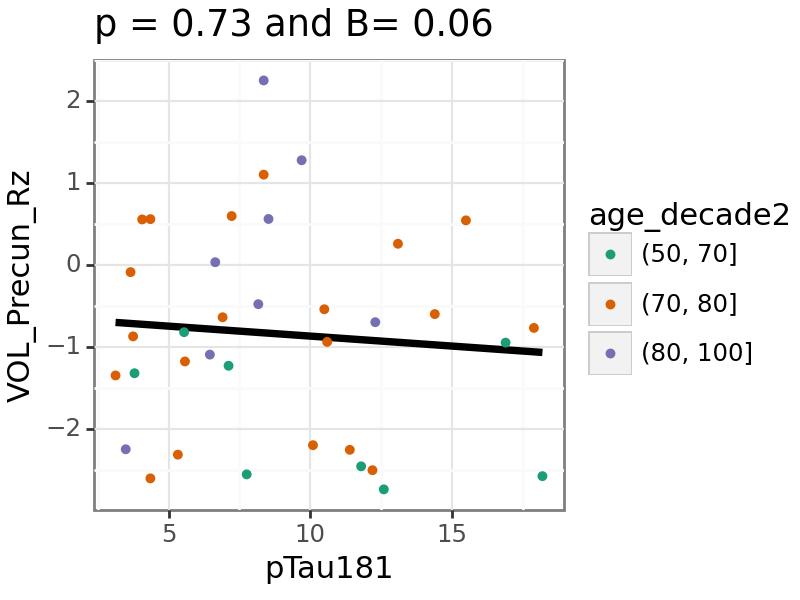


VOL_Precun_Rz pTau231


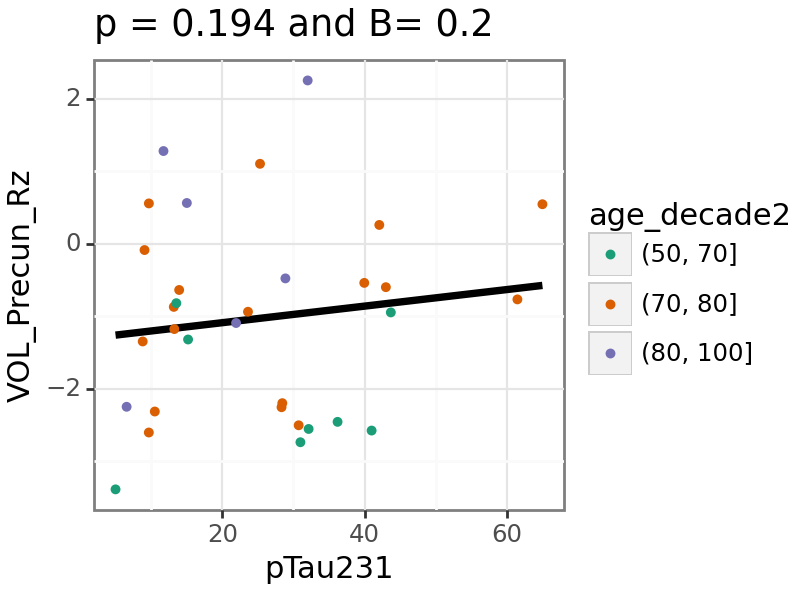


VOL_InfPar_Lz pTau217


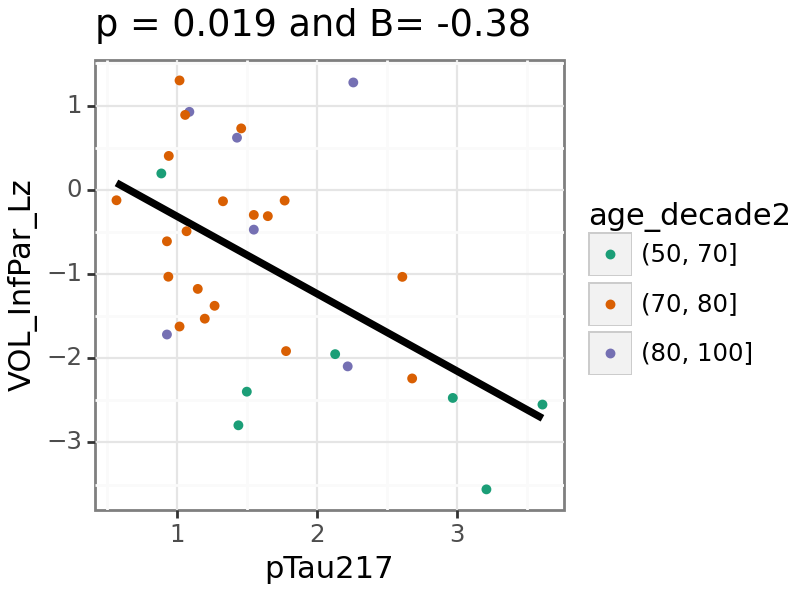


VOL_InfPar_Lz pTau181


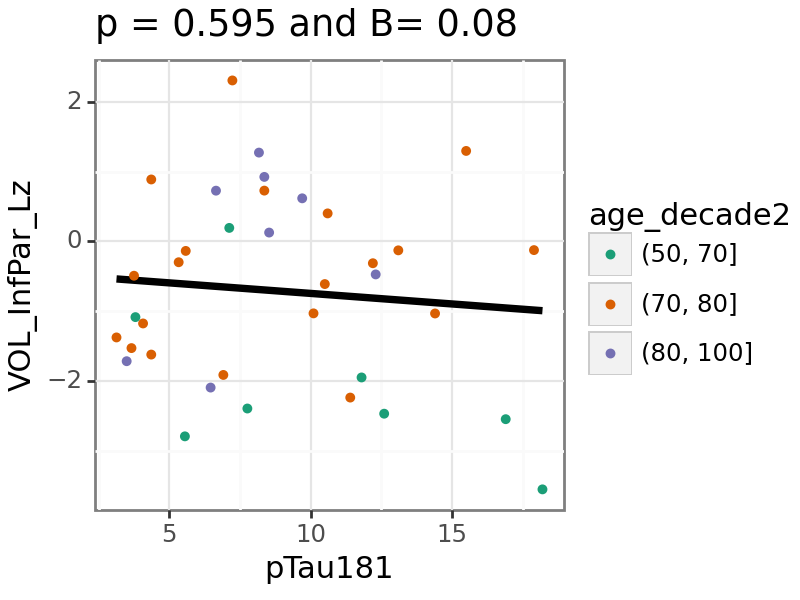


VOL_InfPar_Lz pTau231


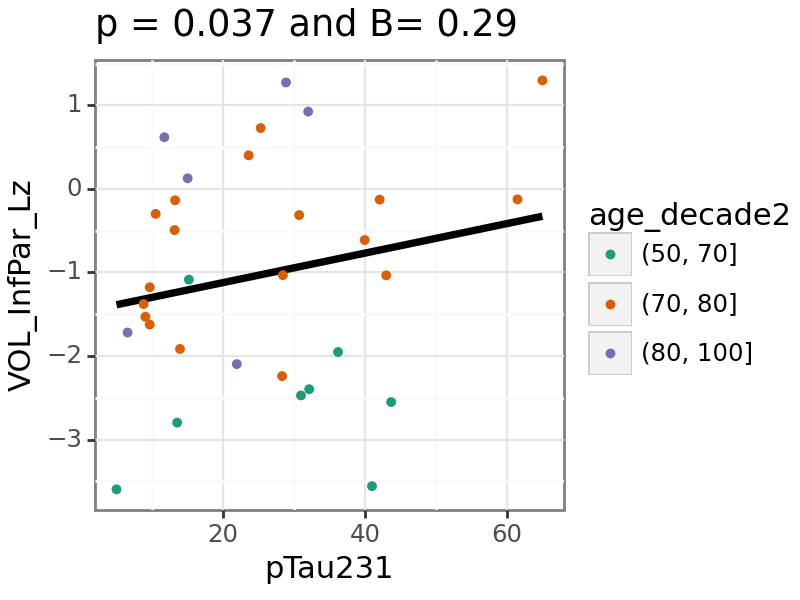


VOL_InfPar_Rz pTau217


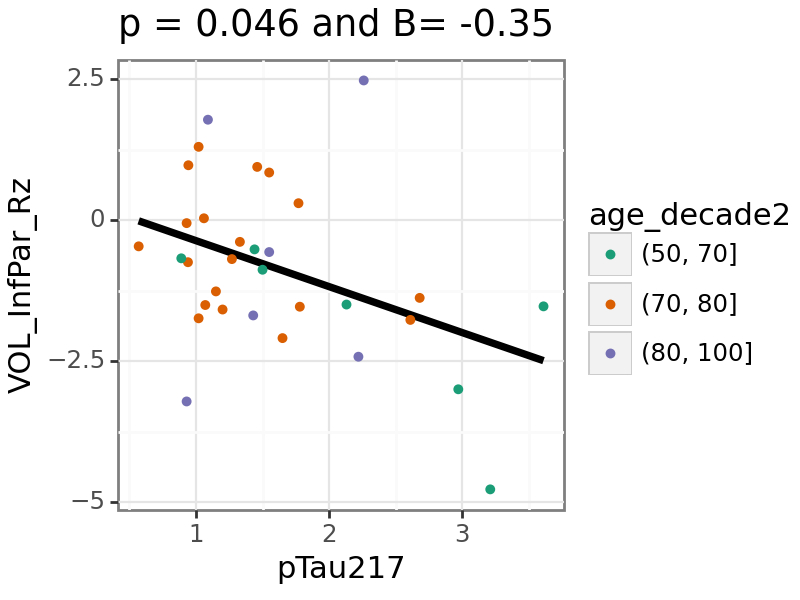


VOL_InfPar_Rz pTau181


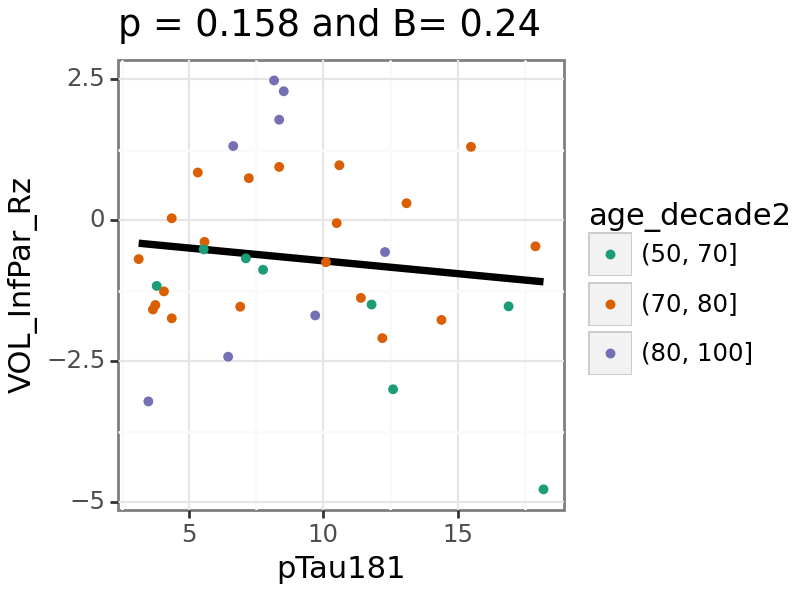


VOL_InfPar_Rz pTau231


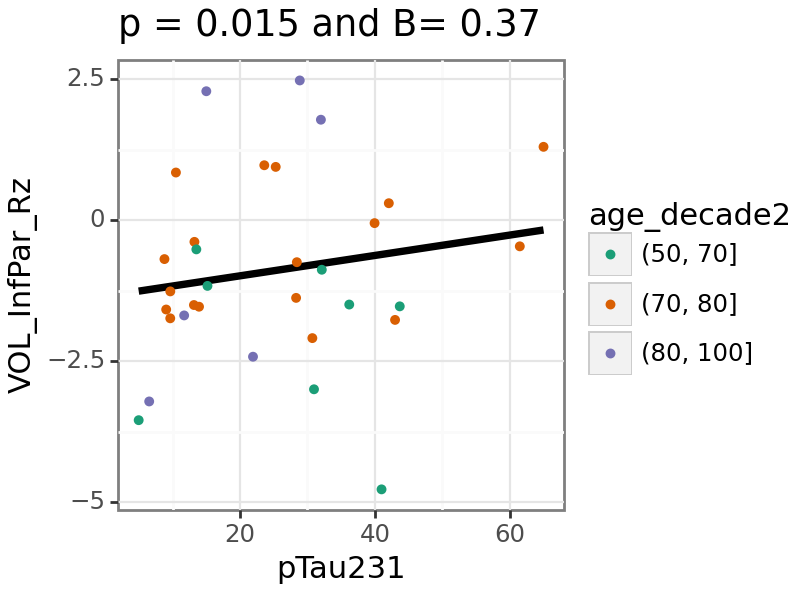


VOL_Hip_Lz pTau217


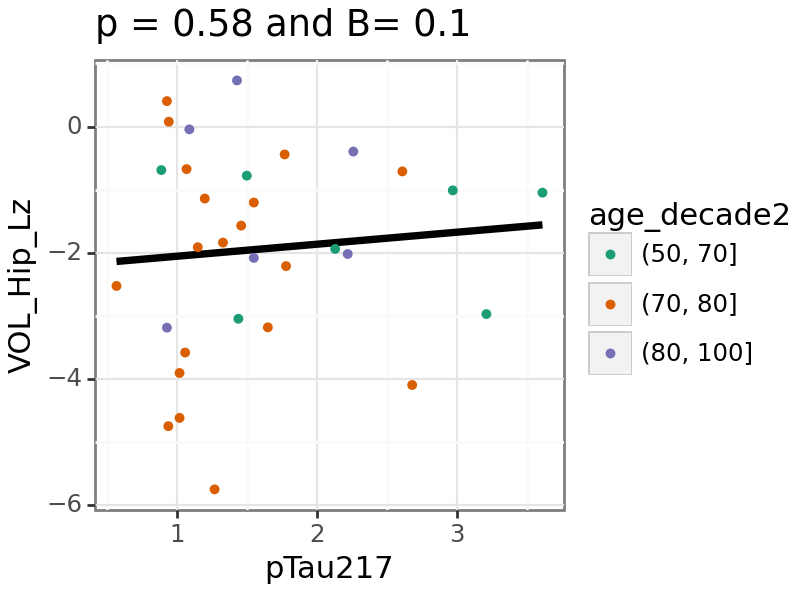


VOL_Hip_Lz pTau181


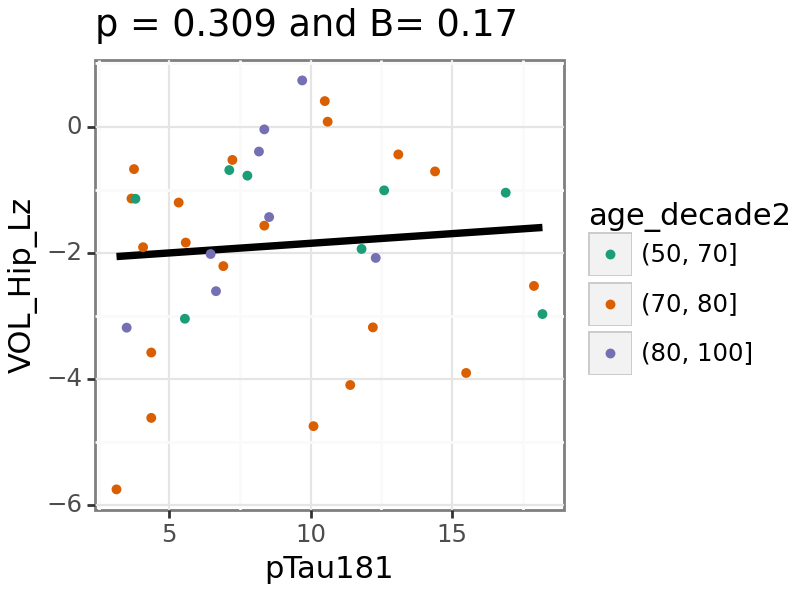


VOL_Hip_Lz pTau231


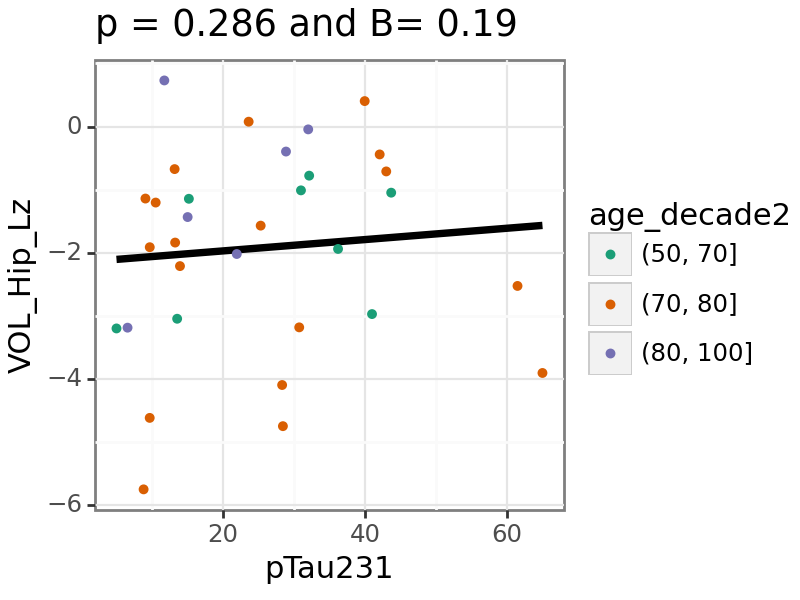


VOL_Hip_Rz pTau217


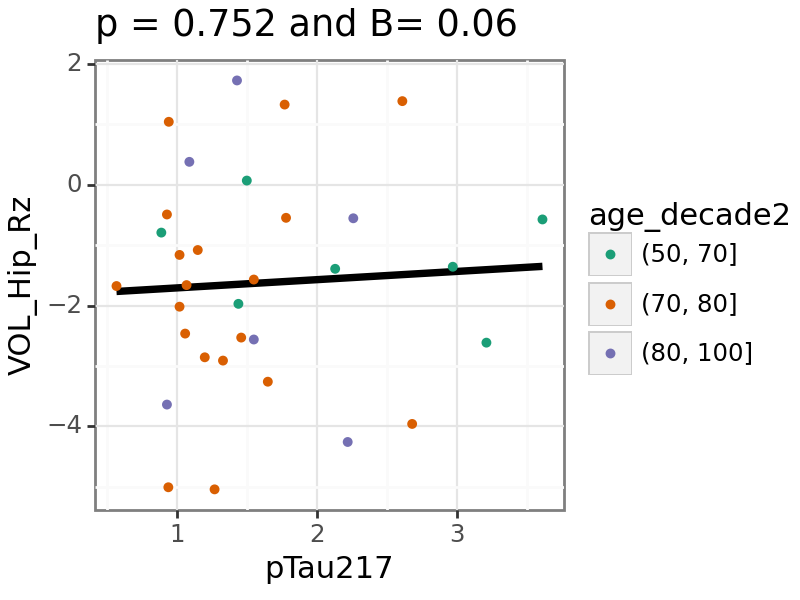


VOL_Hip_Rz pTau181


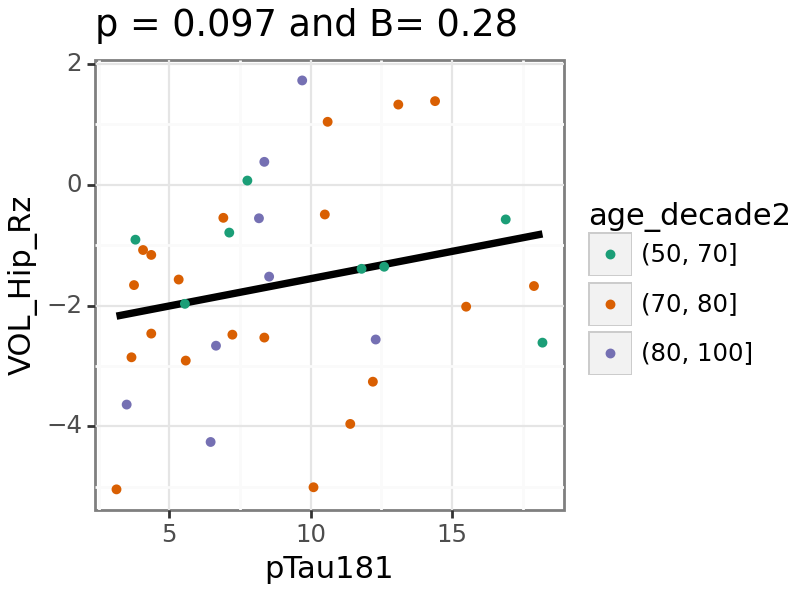


VOL_Hip_Rz pTau231


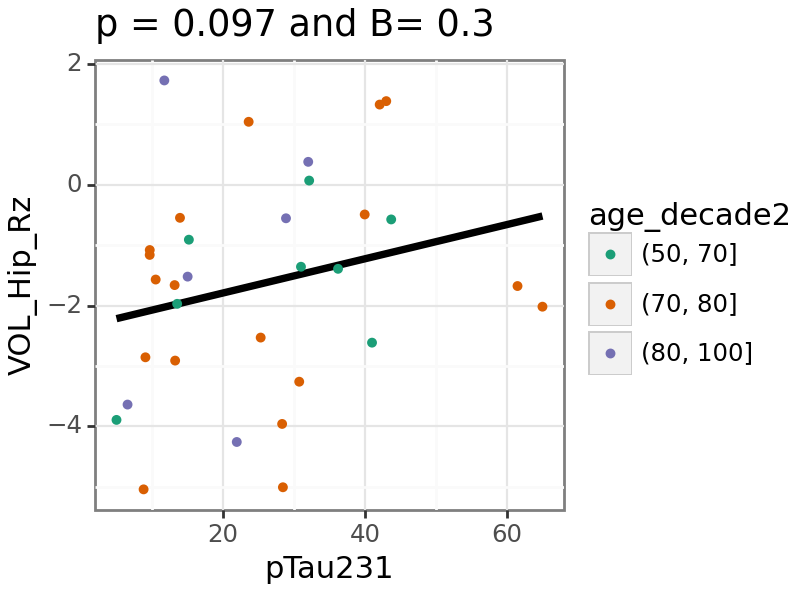


VOL_TotalGrayz pTau217


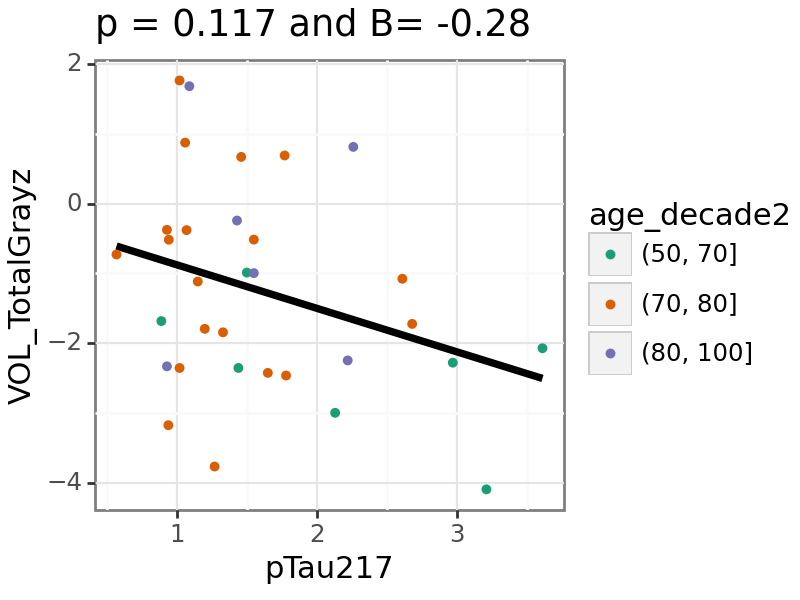


VOL_TotalGrayz pTau181


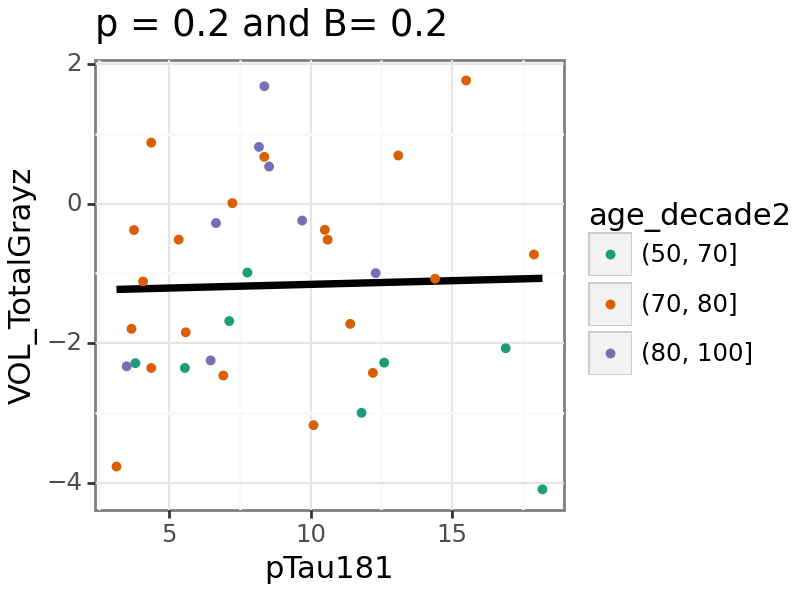


VOL_TotalGrayz pTau231


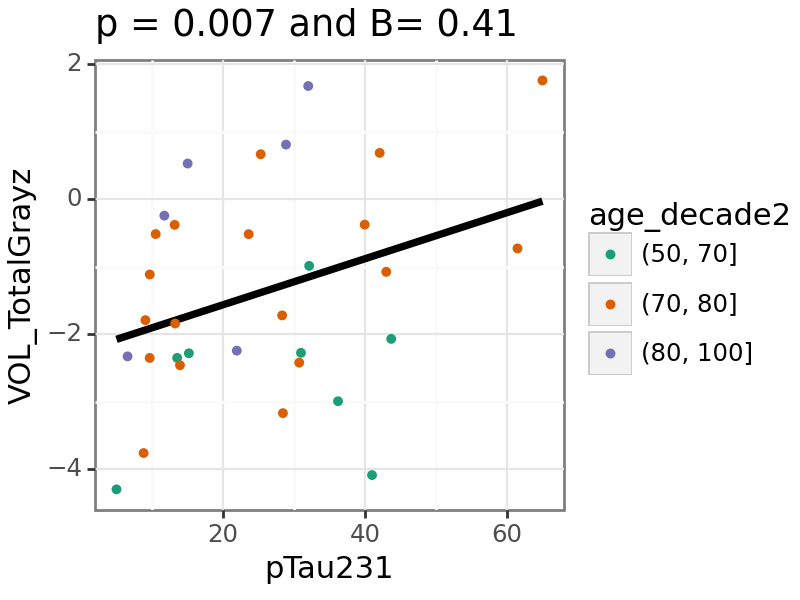


VOL_Inf_Mid_Fus_Temp_Lz pTau217


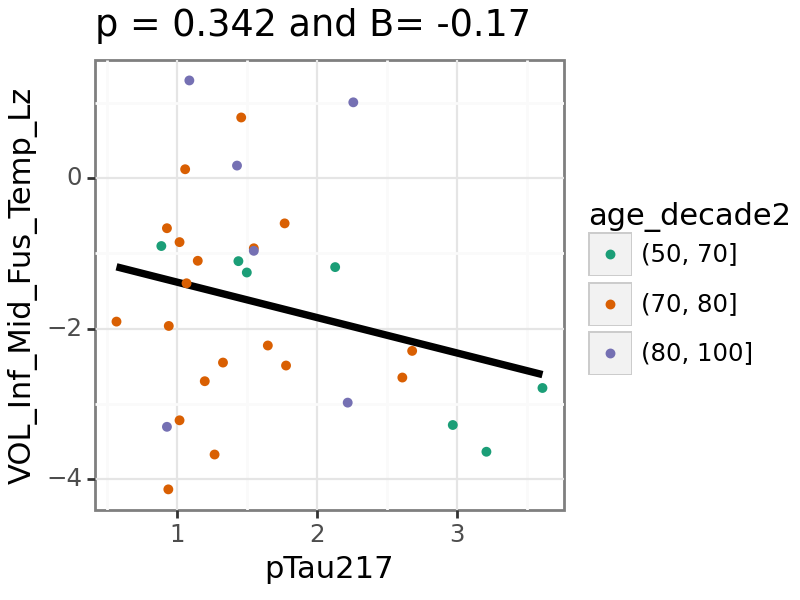


VOL_Inf_Mid_Fus_Temp_Lz pTau181


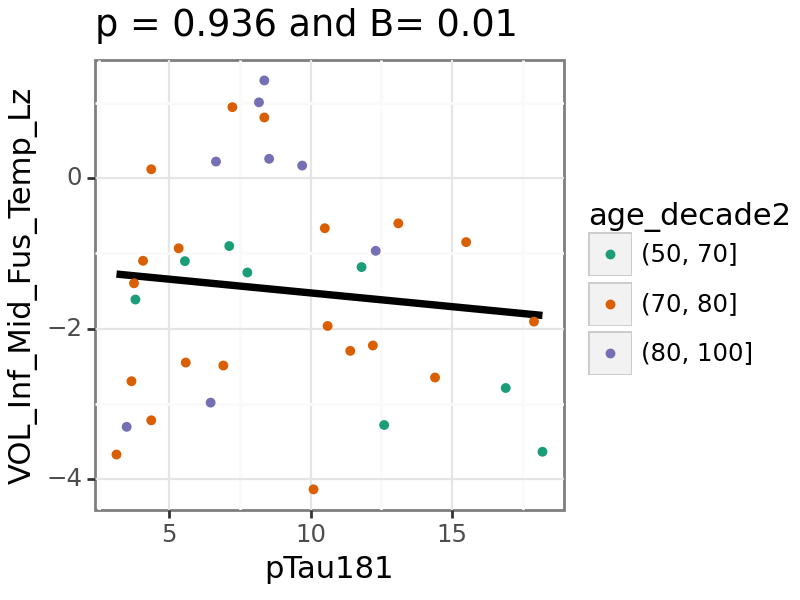


VOL_Inf_Mid_Fus_Temp_Lz pTau231


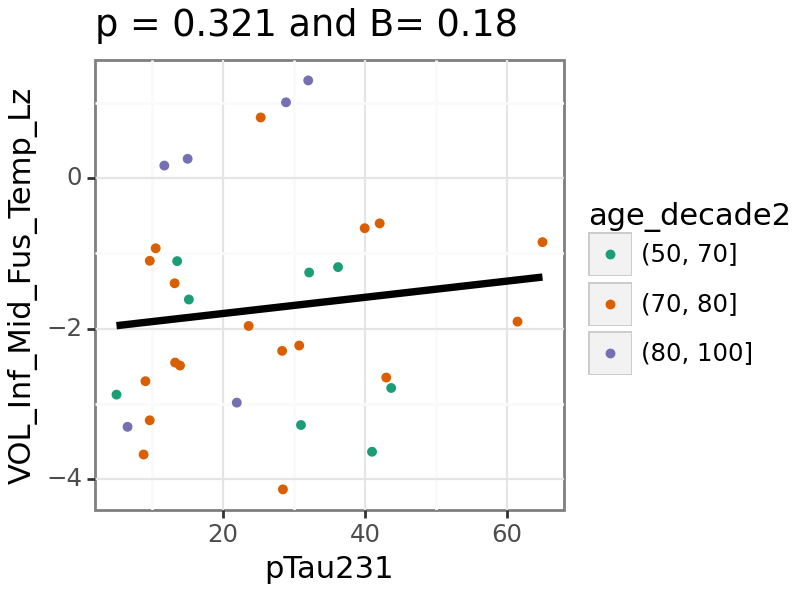


VOL_Inf_Mid_Fus_Temp_Rz pTau217


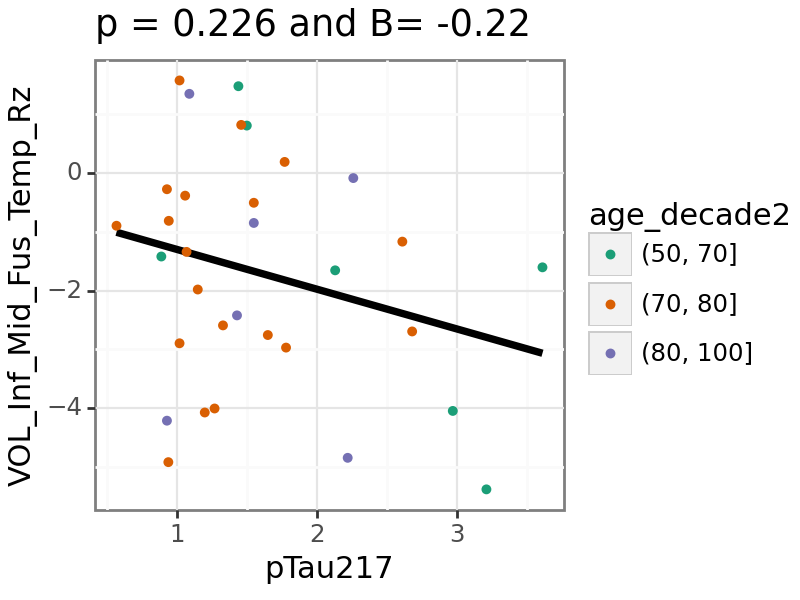


VOL_Inf_Mid_Fus_Temp_Rz pTau181


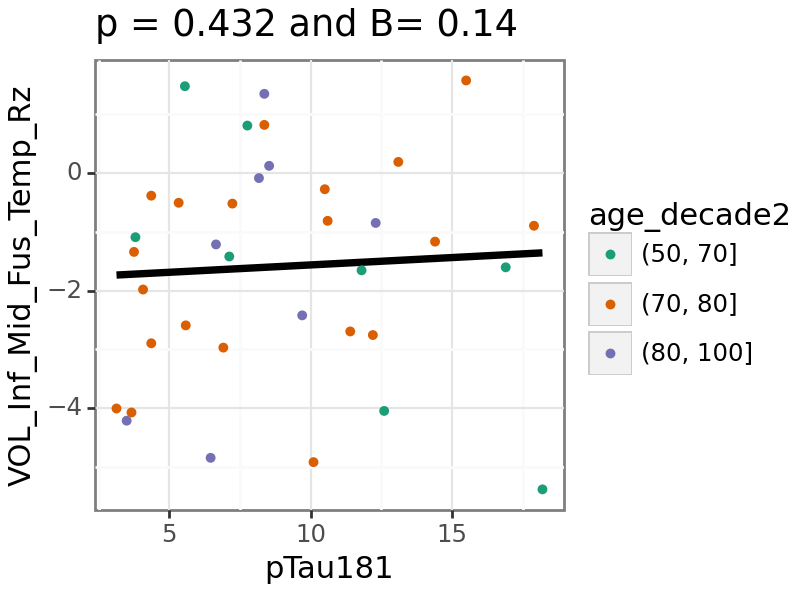


VOL_Inf_Mid_Fus_Temp_Rz pTau231


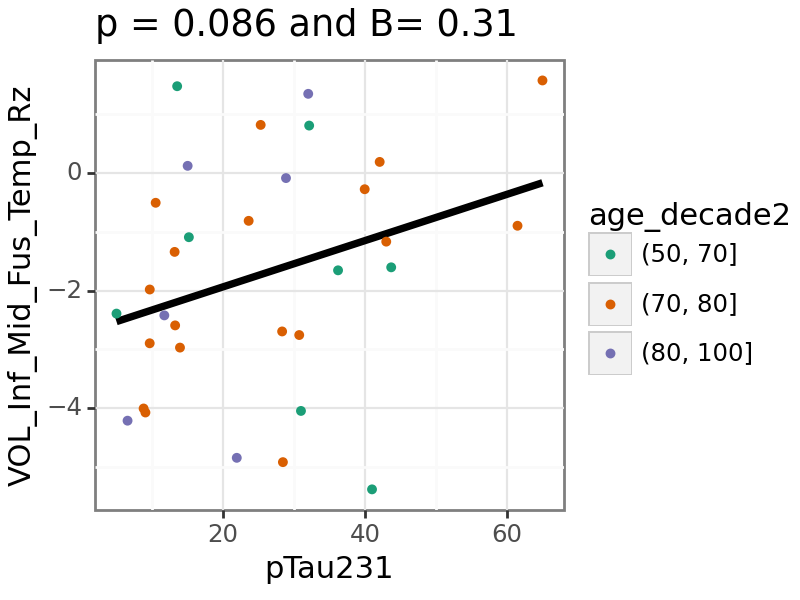


VOL_MidFront_Lz pTau217


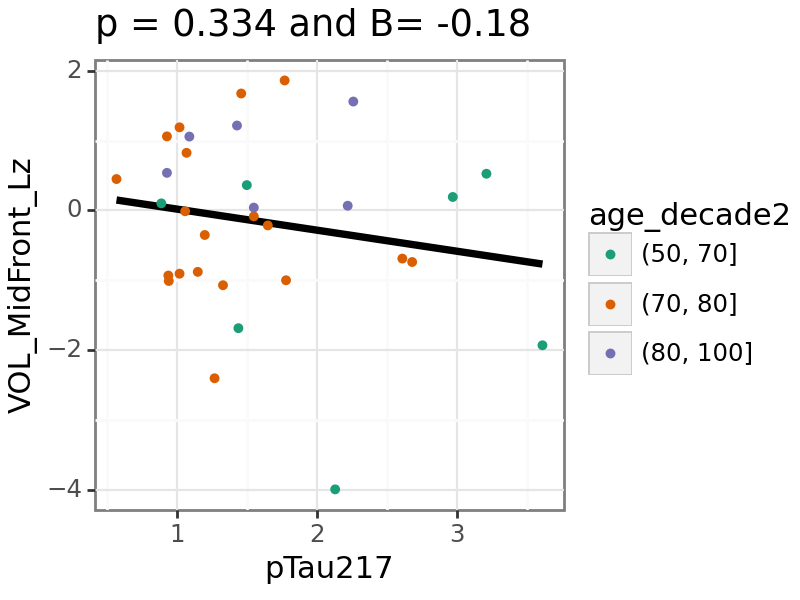


VOL_MidFront_Lz pTau181


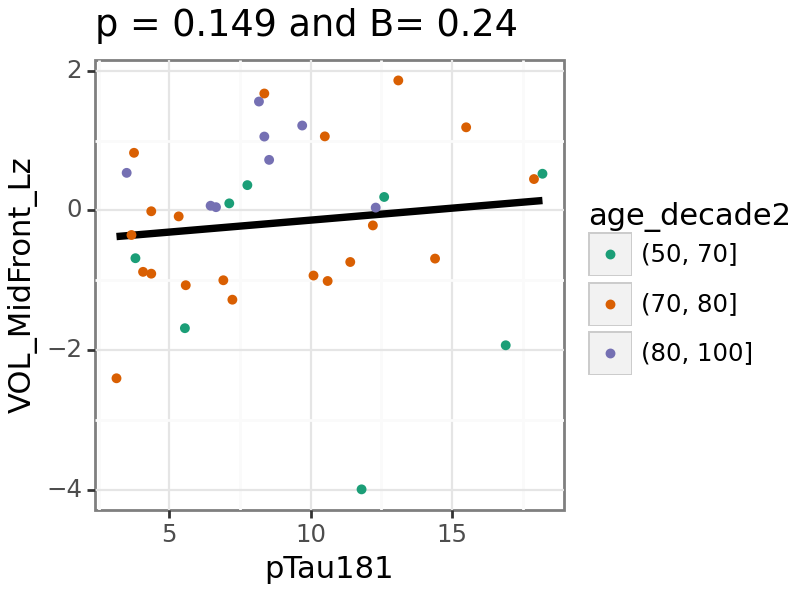


VOL_MidFront_Lz pTau231


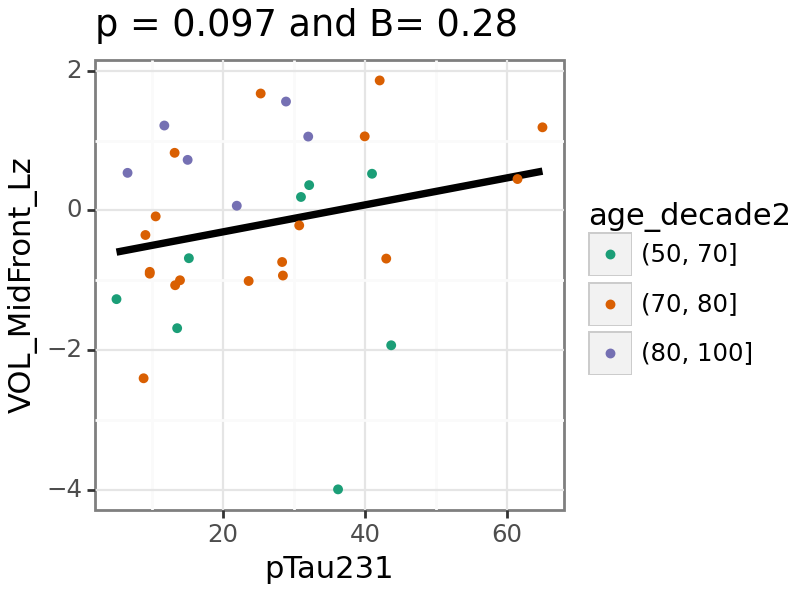


VOL_MidFront_Rz pTau217


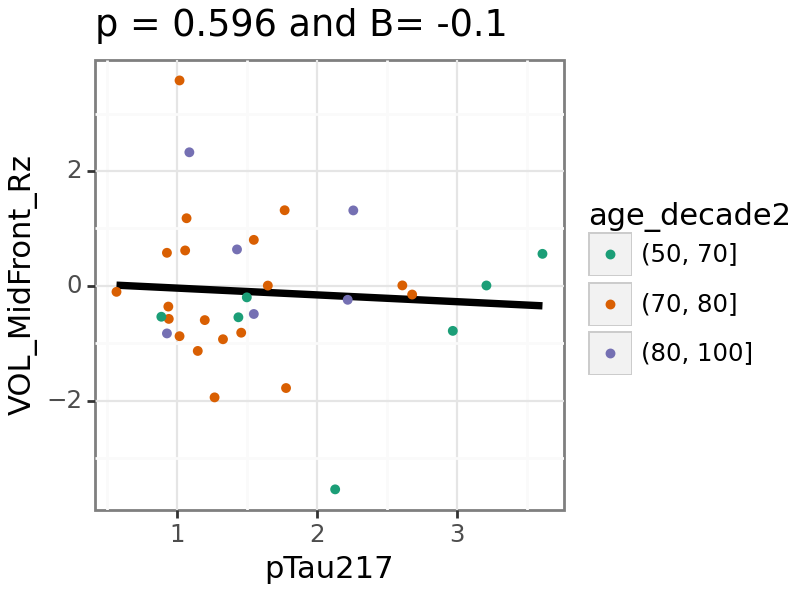


VOL_MidFront_Rz pTau181


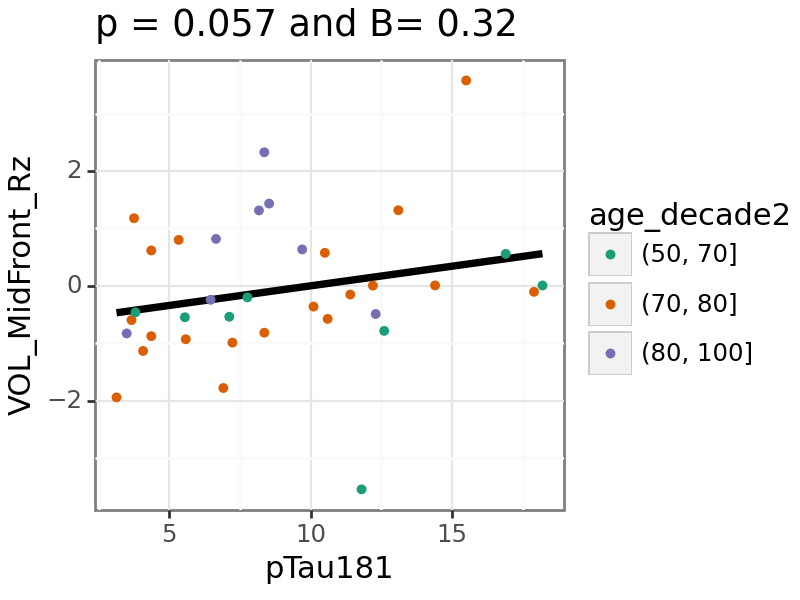


VOL_MidFront_Rz pTau231


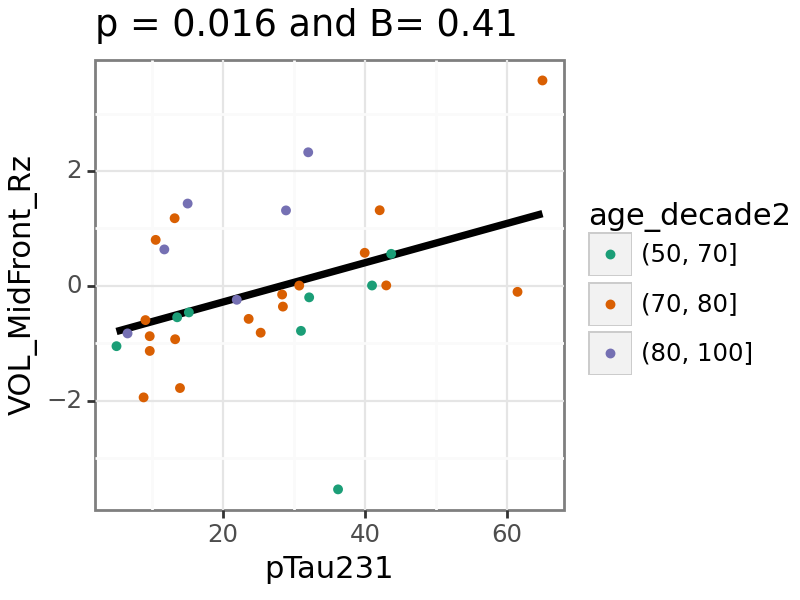

In [45]:
p9.options.figure_size = (4,3)  

for y_var in [ele for ele in vol_columns if ele in all_data.columns]:
    for x_var in ['pTau217', 'pTau181', 'pTau231']:
        p_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), pvals_to_consider[0]].reset_index(drop=True)[0].round(3).astype('str')
        B_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), Bval_to_grab].reset_index(drop=True)[0].round(2).astype('str')

        subset_data = baseline_trial_data.dropna(subset = [x_var, y_var, 'age_decade2'])
        subset_data2 = subset_data.copy()
        subset_data2 = subset_data2.groupby('age_decade2', observed=True).filter(lambda x: x['ID_ADM'].nunique()> 5)
        print(y_var, x_var)
        plot = (
                p9.ggplot(subset_data, p9.aes(x = x_var, y = y_var, color = 'age_decade2'))
                + p9.theme_bw(base_size = 11)
                + p9.geom_smooth(subset_data, size = 1.5, se = False, alpha = 1, color = 'black', method = 'lm')
                #+ p9.geom_smooth(subset_data2, size = 0.8, se = False, alpha = 1, method = 'lm')
                
                + p9.geom_point(size = 1.0)
                + p9.labs(title = ('p = ' + p_value + ' and B= ' + B_value))
                + p9.scale_color_manual(['#1b9e77', '#d95f02', '#7570b3', '#737373'])
            )
        print(plot)

## Ptau vs Ptau with subject labels

In [46]:
baseline_trial_data['ID_ADM'] = baseline_trial_data['ID_ADM'].astype('category')

C:\Users\Lauren.Koenig\AppData\Local\Temp\4\ipykernel_38248\3034066170.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


pTau217 pTau231


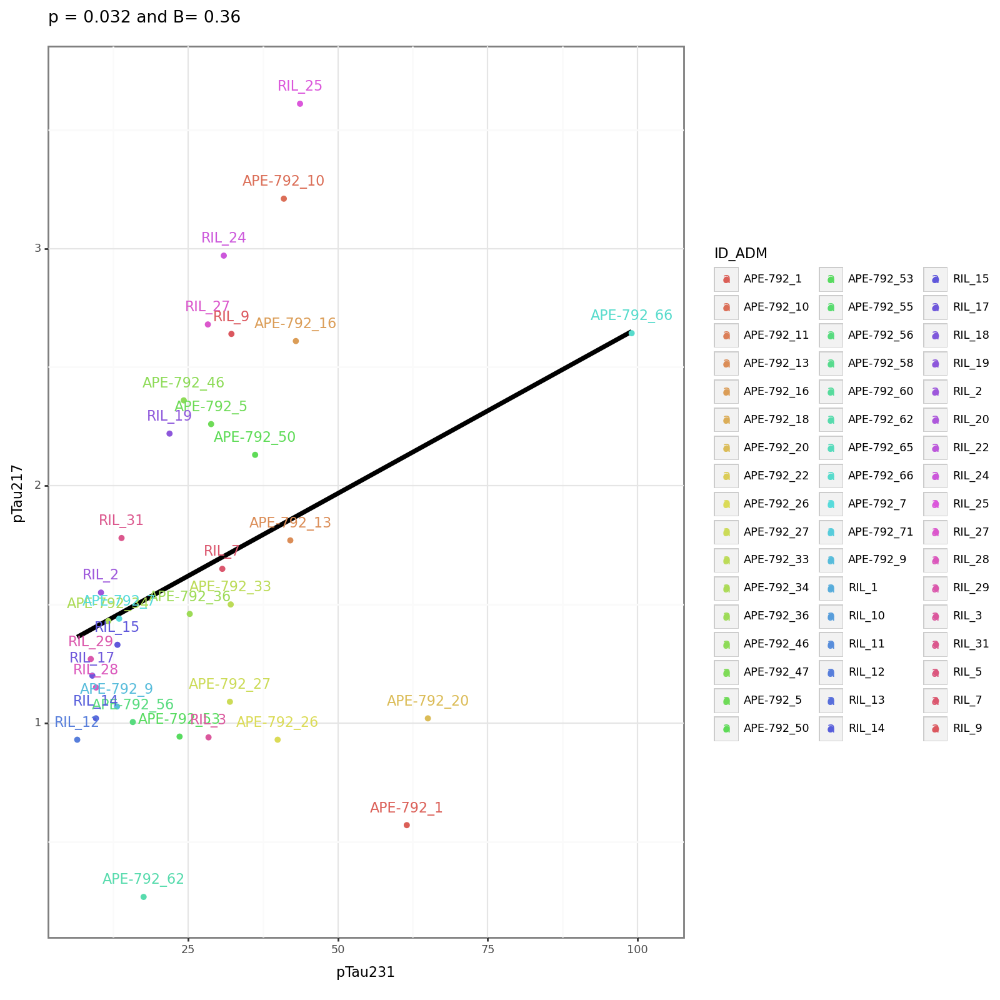


pTau217 pTau181


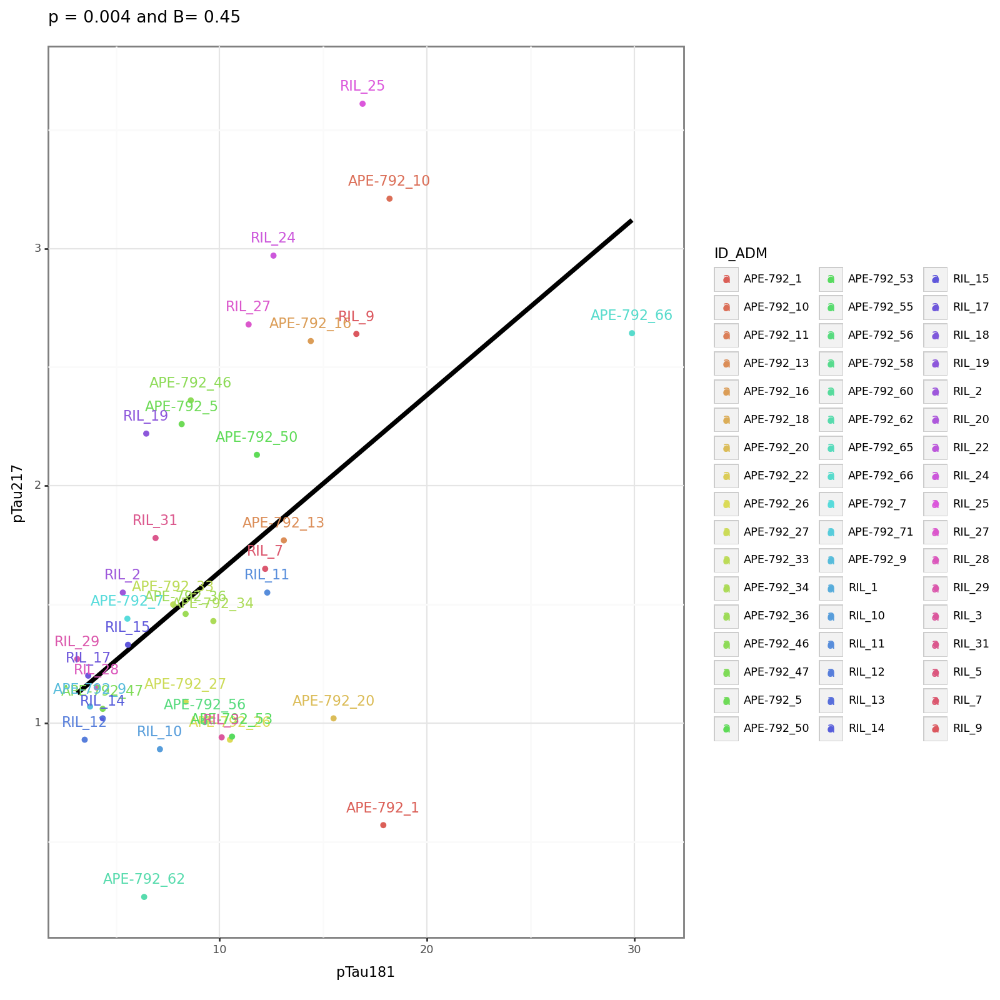


pTau181 pTau231


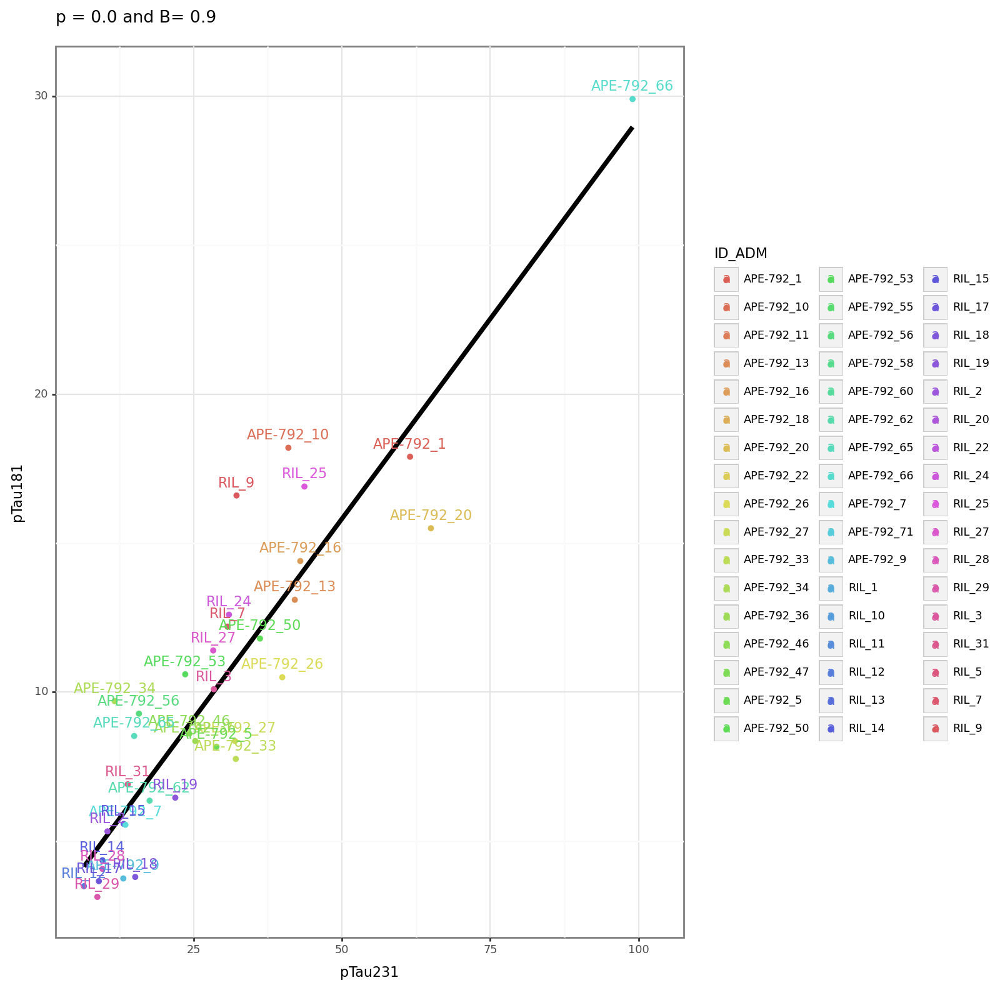

In [47]:

y_var = 'pTau217'
x_var = 'pTau231'
print(y_var, x_var)

p_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), pvals_to_consider[0]].reset_index(drop=True)[0].round(3).astype('str')
B_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), Bval_to_grab].reset_index(drop=True)[0].round(2).astype('str')

subset_data = baseline_trial_data.dropna(subset = [x_var, y_var, 'age_decade2'])
subset_data2 = subset_data.copy()
subset_data2 = subset_data2.groupby('age_decade2', observed=True).filter(lambda x: x['ID_ADM'].nunique()> 4)
p9.options.figure_size = (8,8)  
plot = (
        p9.ggplot(subset_data, p9.aes(x = x_var, y = y_var, color = 'ID_ADM', label = 'ID_ADM'))
        + p9.theme_bw(base_size = 8)
        + p9.geom_smooth(subset_data, size = 1.5, se = False, alpha = 1, color = 'black', method = 'lm')
        #+ p9.geom_smooth(subset_data2, size = 0.8, se = False, alpha = 1, method = 'lm')
        + p9.geom_point(size = 1.0)
        + p9.geom_text(size = 8, nudge_x = 0, nudge_y =baseline_data[y_var].std()/12)
        + p9.labs(title = ('p = ' + p_value + ' and B= ' + B_value))
        + p9.scale_x_continuous(limits = [subset_data[x_var].min(), subset_data[x_var].max() + 0.2*subset_data[x_var].std()])
    )
print(plot)




y_var = 'pTau217'
x_var = 'pTau181'
print(y_var, x_var)

p_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), pvals_to_consider[0]].reset_index(drop=True)[0].round(3).astype('str')
B_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), Bval_to_grab].reset_index(drop=True)[0].round(2).astype('str')

subset_data = baseline_trial_data.dropna(subset = [x_var, y_var, 'age_decade2'])
subset_data2 = subset_data.copy()
subset_data2 = subset_data2.groupby('age_decade2', observed=True).filter(lambda x: x['ID_ADM'].nunique()> 4)
p9.options.figure_size = (8,8)  

plot = (
        p9.ggplot(subset_data, p9.aes(x = x_var, y = y_var, color = 'ID_ADM', label = 'ID_ADM'))
        + p9.theme_bw(base_size = 8)
        + p9.geom_smooth(subset_data, size = 1.5, se = False, alpha = 1, color = 'black', method = 'lm')
        #+ p9.geom_smooth(subset_data2, size = 0.8, se = False, alpha = 1, method = 'lm')
        + p9.geom_point(size = 1.0)
        + p9.geom_text(size = 8, nudge_x = 0, nudge_y =baseline_data[y_var].std()/12)
        + p9.labs(title = ('p = ' + p_value + ' and B= ' + B_value))
        + p9.scale_x_continuous(limits = [subset_data[x_var].min(), subset_data[x_var].max() + 0.2*subset_data[x_var].std()])
    )
print(plot)



y_var = 'pTau181'
x_var = 'pTau231'
print(y_var, x_var)

p_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), pvals_to_consider[0]].reset_index(drop=True)[0].round(3).astype('str')
B_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), Bval_to_grab].reset_index(drop=True)[0].round(2).astype('str')

subset_data = baseline_trial_data.dropna(subset = [x_var, y_var, 'age_decade2'])
subset_data2 = subset_data.copy()
subset_data2 = subset_data2.groupby('age_decade2', observed=True).filter(lambda x: x['ID_ADM'].nunique()> 4)
p9.options.figure_size = (8,8)  
plot = (
        p9.ggplot(subset_data, p9.aes(x = x_var, y = y_var, color = 'ID_ADM', label = 'ID_ADM'))
        + p9.theme_bw(base_size = 8)
        + p9.geom_smooth(subset_data, size = 1.5, se = False, alpha = 1, color = 'black', method = 'lm')
        #+ p9.geom_smooth(subset_data2, size = 0.8, se = False, alpha = 1, method = 'lm')
        + p9.geom_point(size = 1.0)
        + p9.geom_text(size = 8, nudge_x = 0, nudge_y =baseline_data[y_var].std()/12)
        + p9.labs(title = ('p = ' + p_value + ' and B= ' + B_value))
        + p9.scale_x_continuous(limits = [subset_data[x_var].min(), subset_data[x_var].max() + 0.2*subset_data[x_var].std()])
    )
print(plot)

## all ptau by all volumes with subject labels

VOL_Precun_Lz pTau217


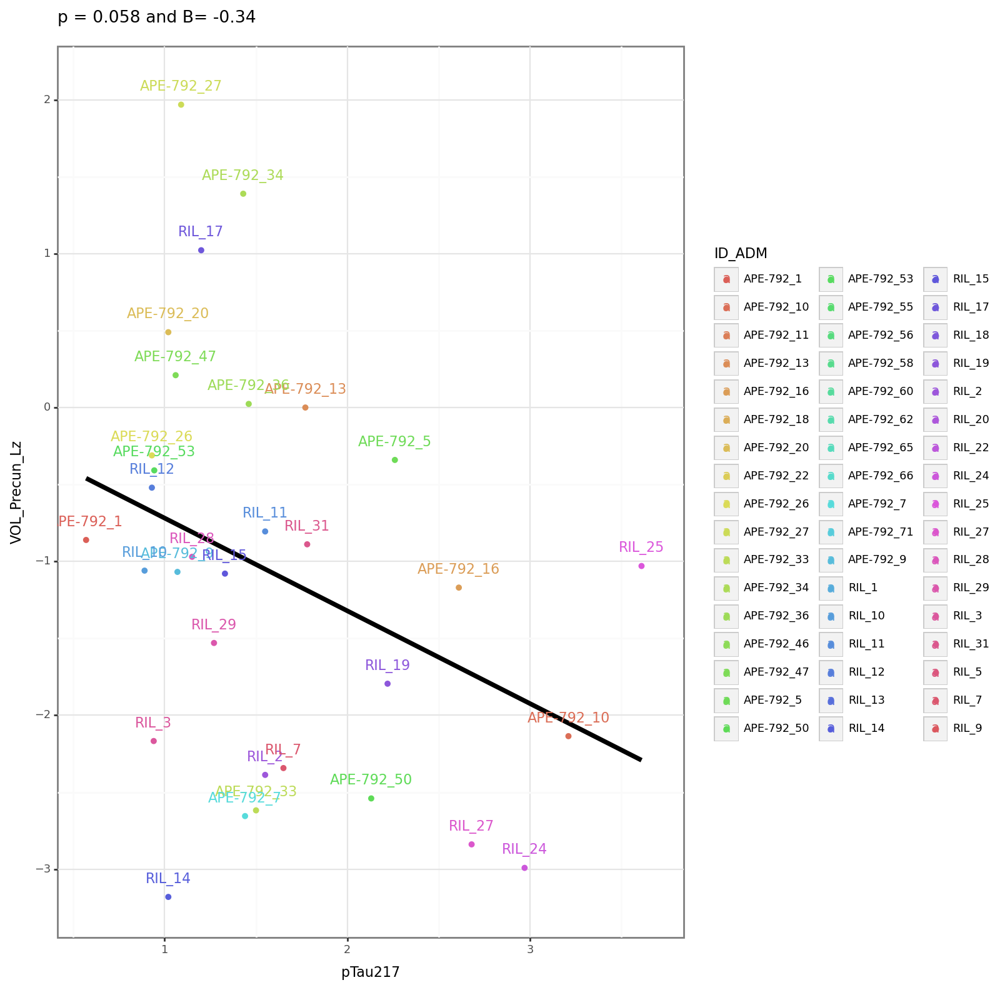


VOL_Precun_Lz pTau231


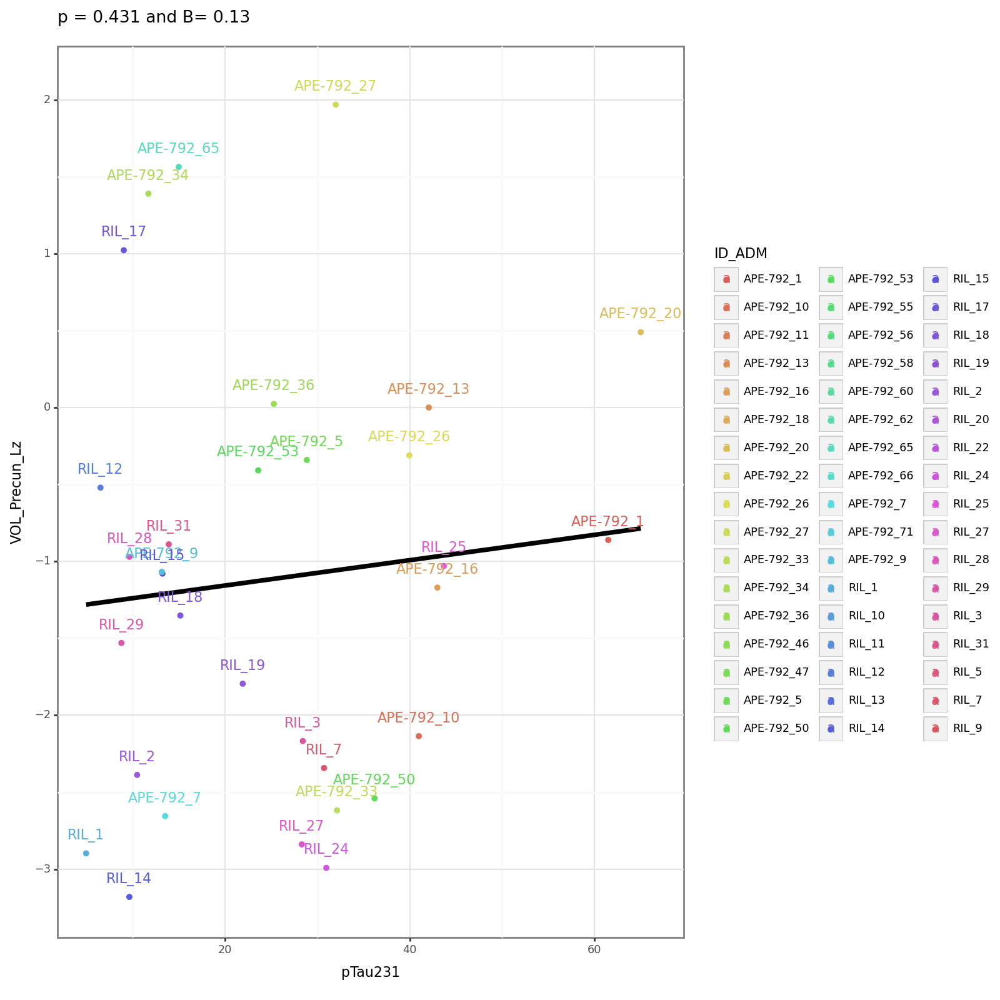


VOL_Precun_Lz pTau181


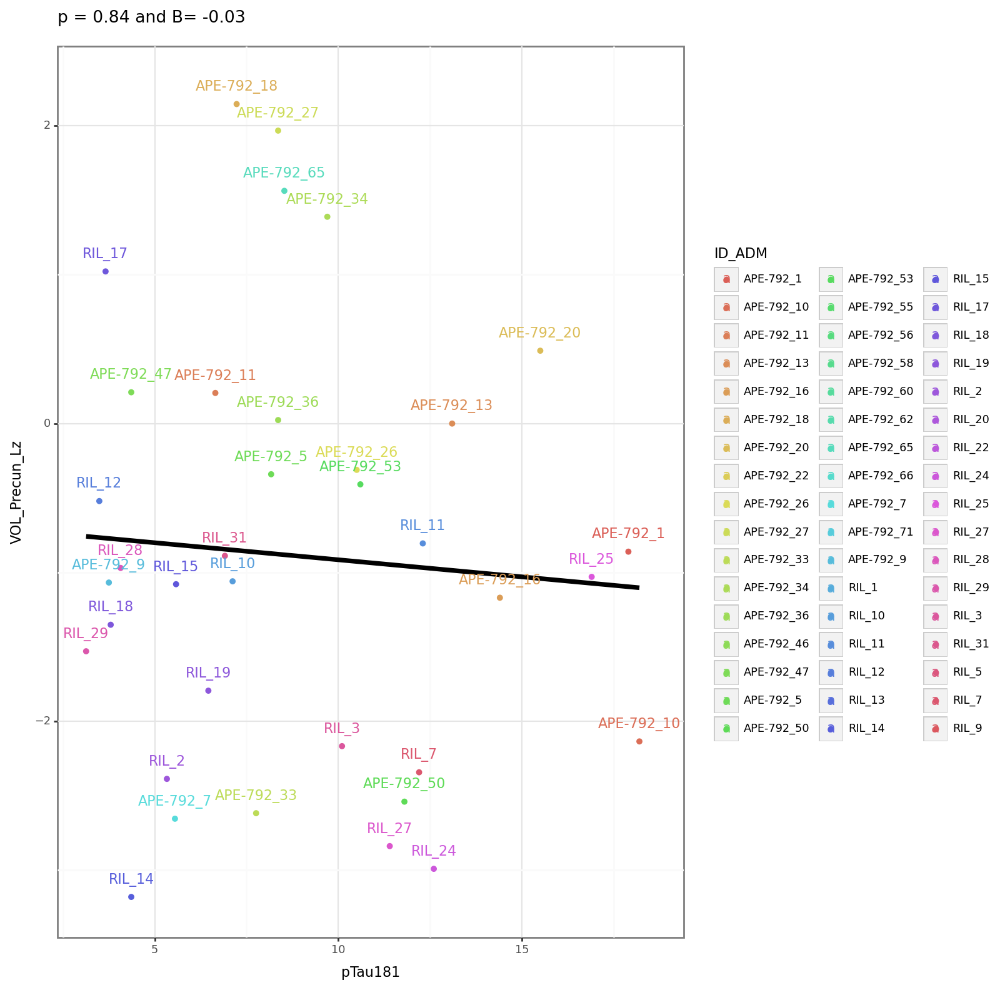


VOL_Precun_Rz pTau217


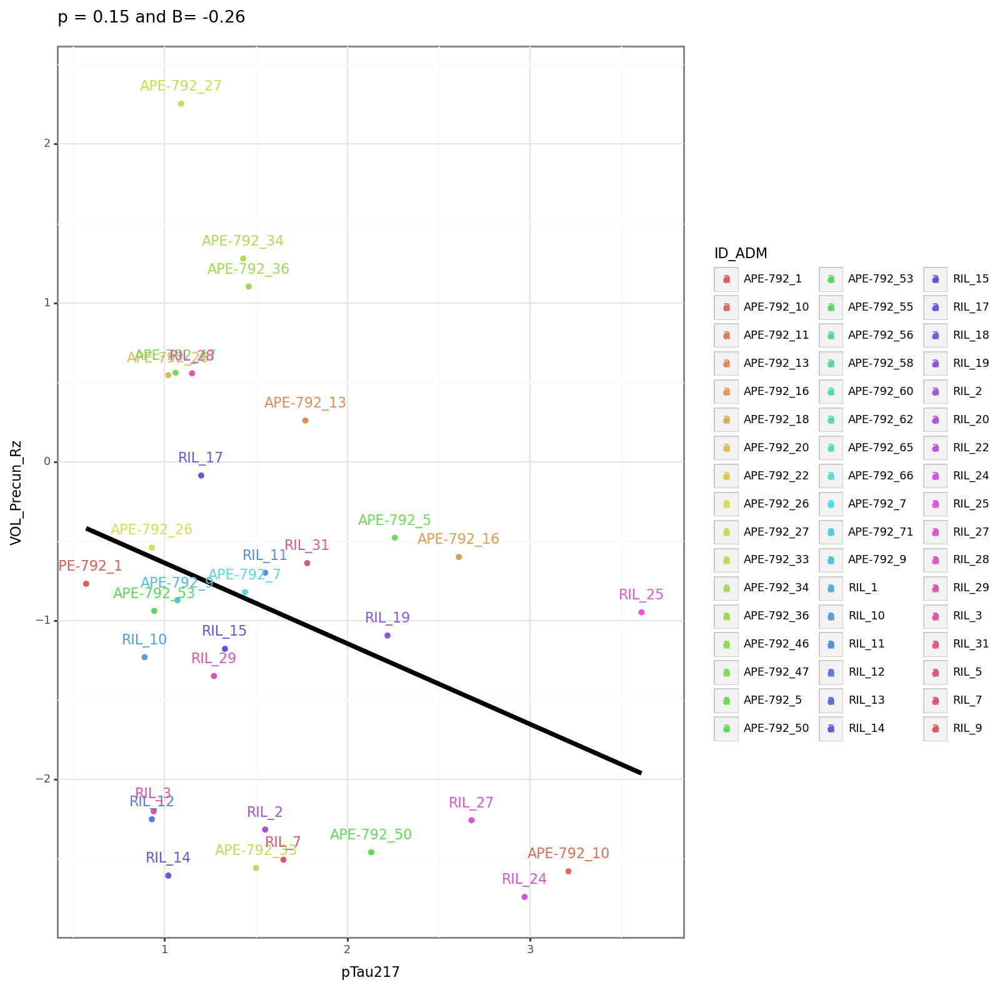


VOL_Precun_Rz pTau231


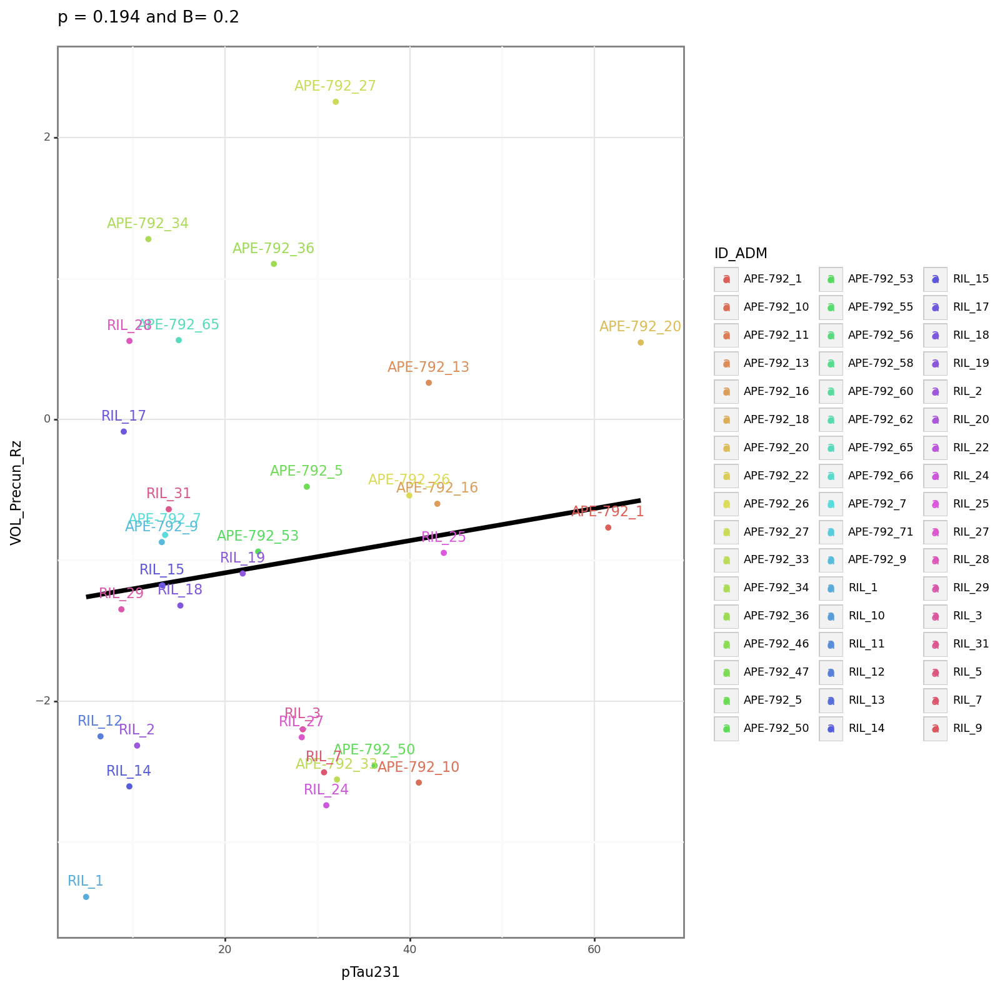


VOL_Precun_Rz pTau181


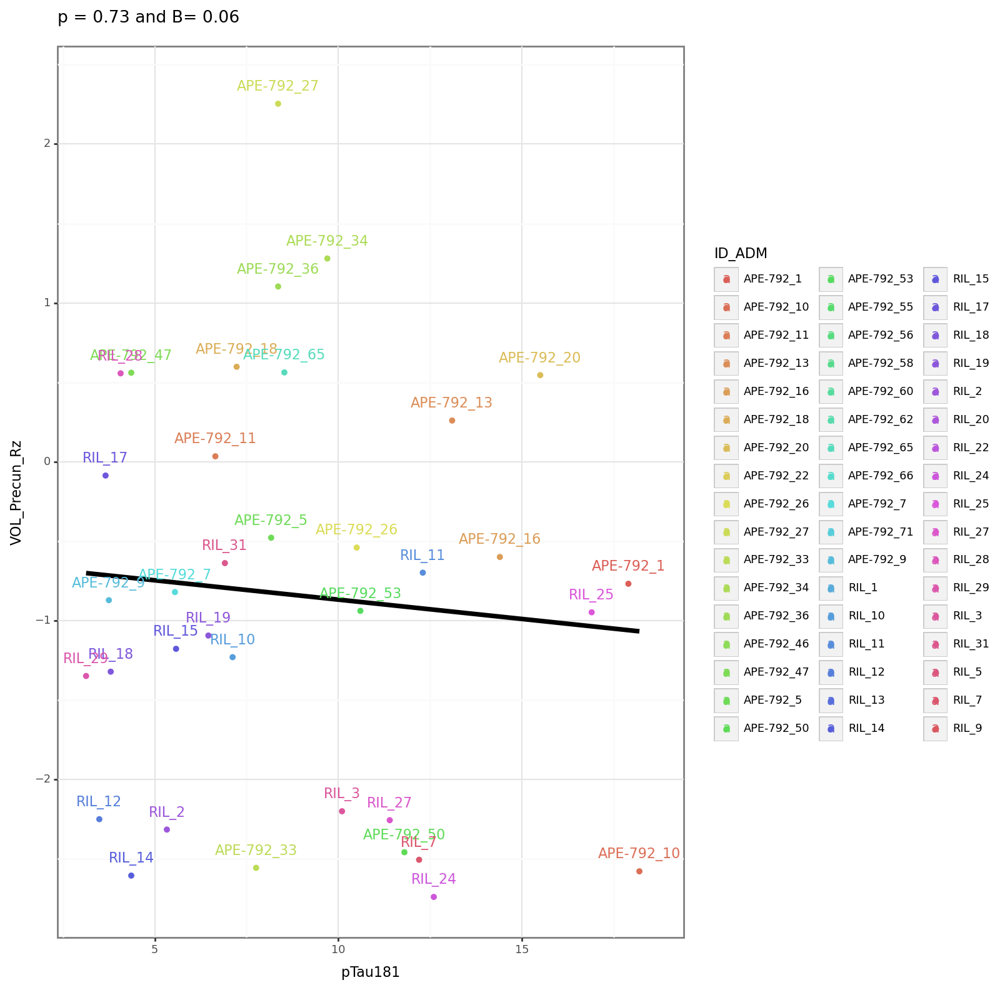


VOL_InfPar_Lz pTau217


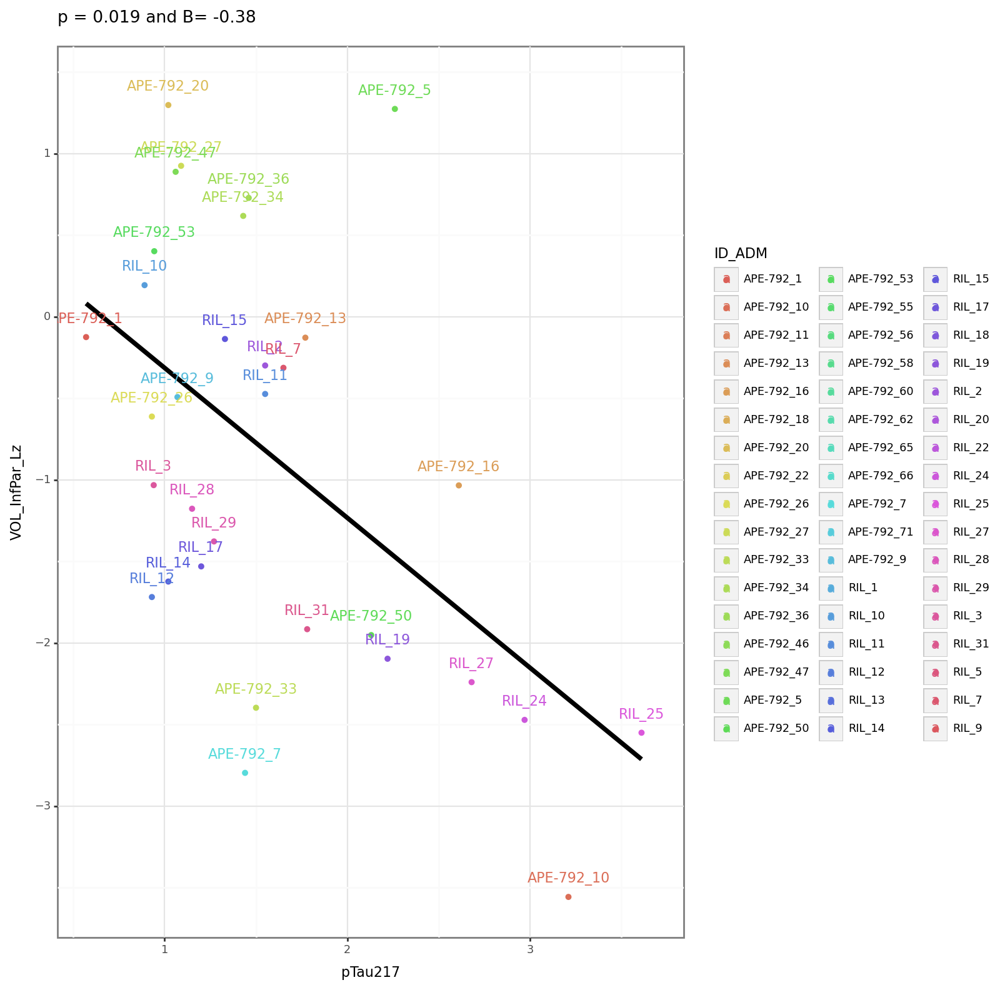


VOL_InfPar_Lz pTau231


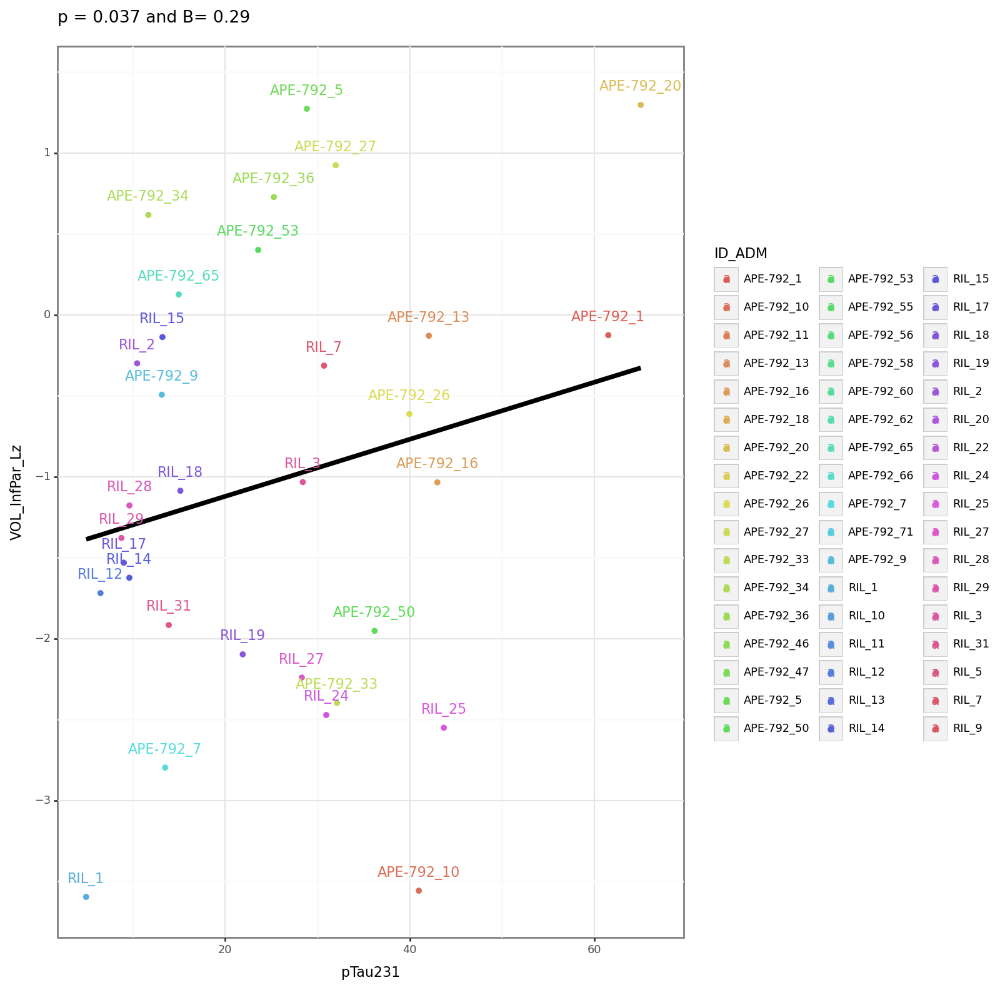


VOL_InfPar_Lz pTau181


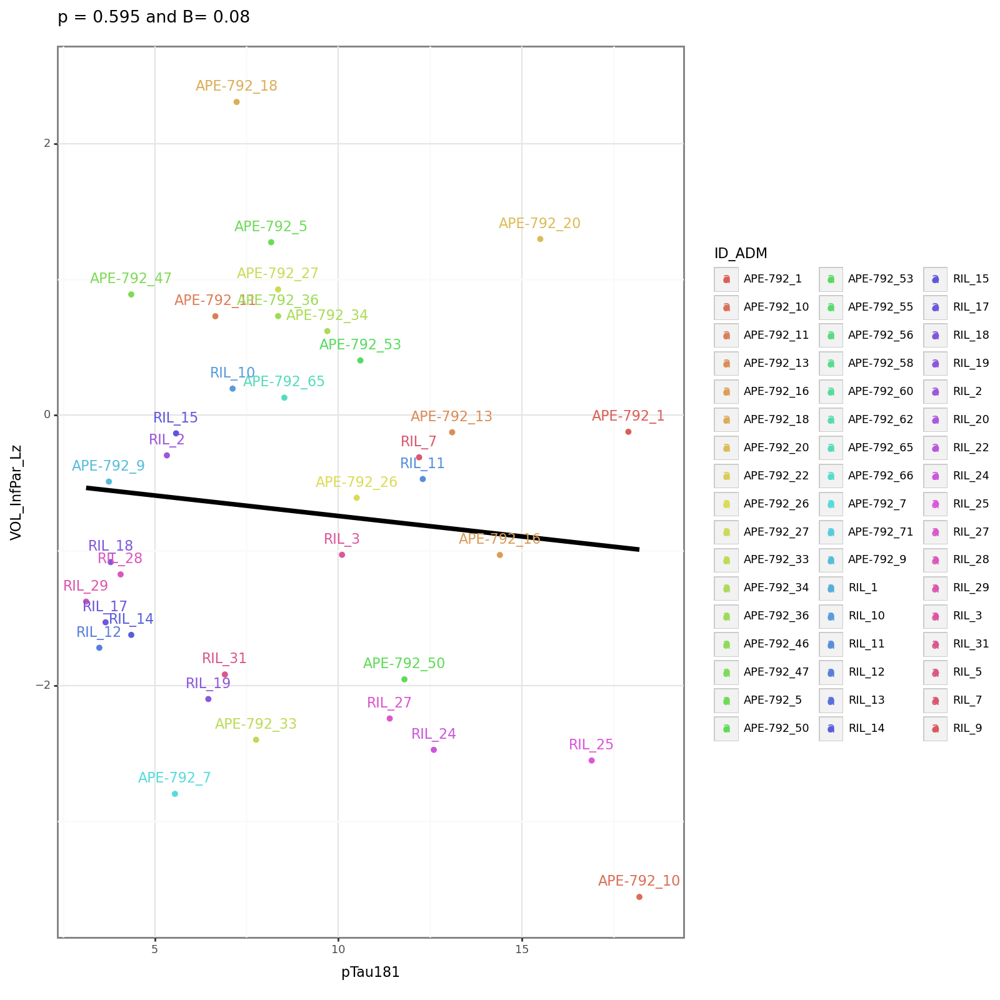


VOL_InfPar_Rz pTau217


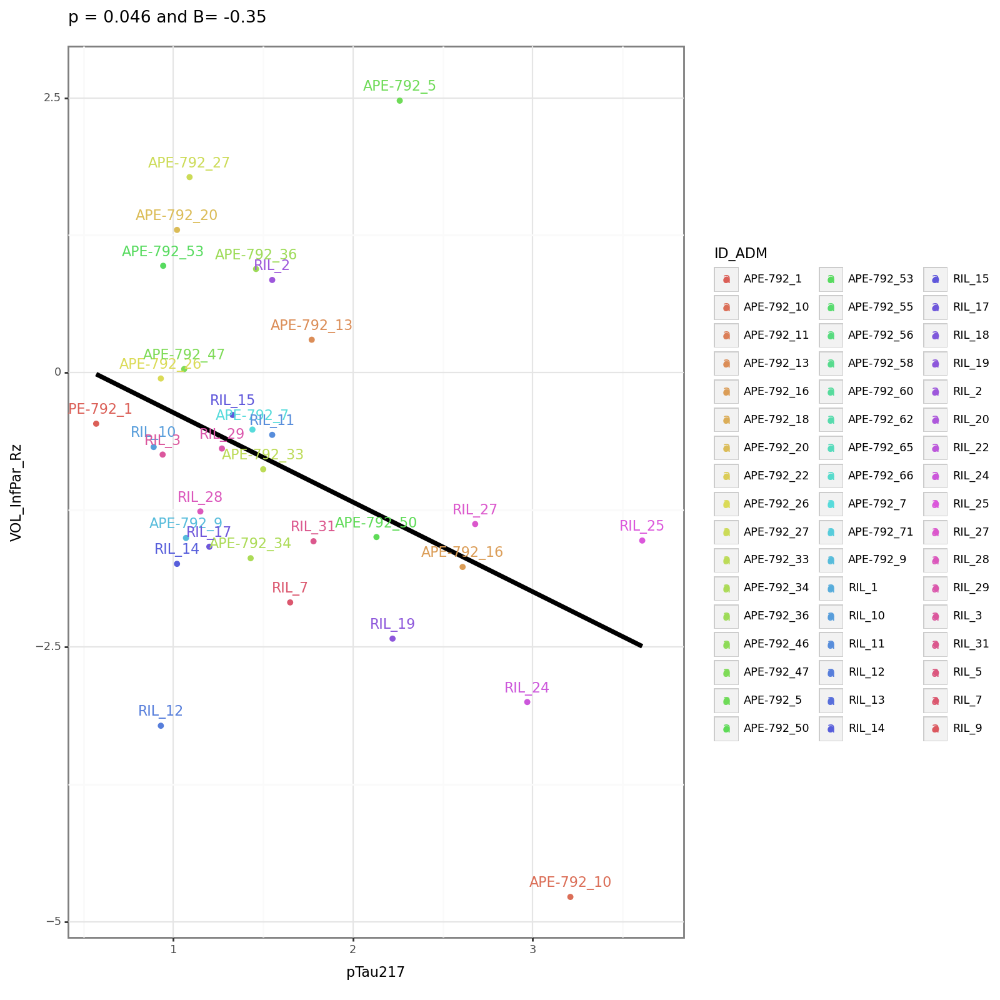


VOL_InfPar_Rz pTau231


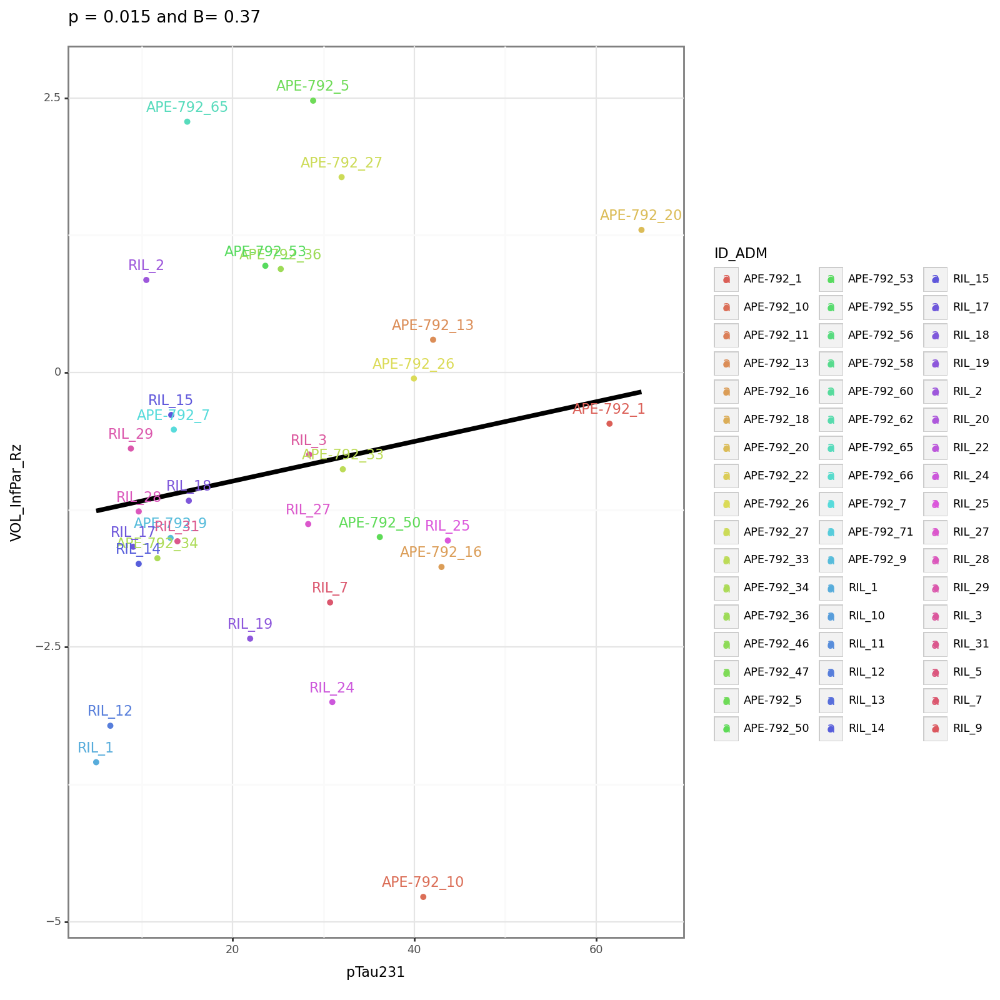


VOL_InfPar_Rz pTau181


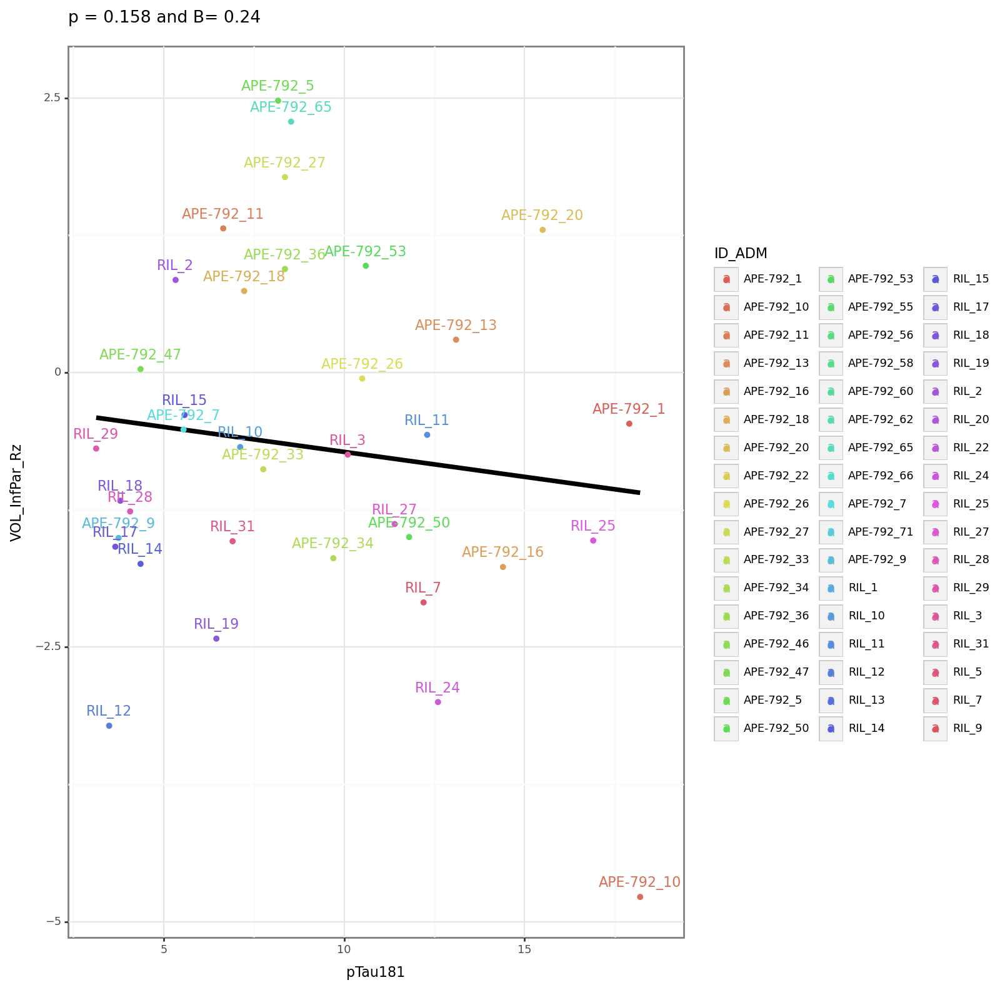


VOL_Hip_Lz pTau217


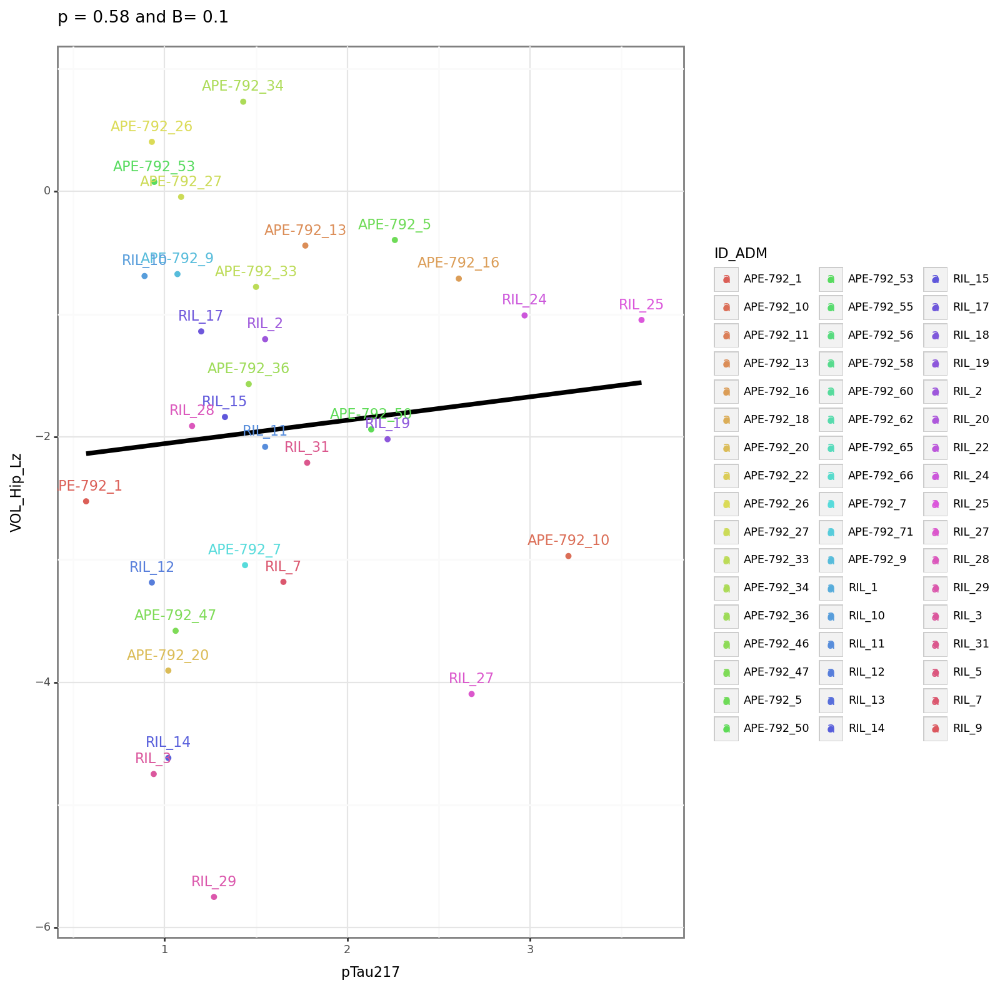


VOL_Hip_Lz pTau231


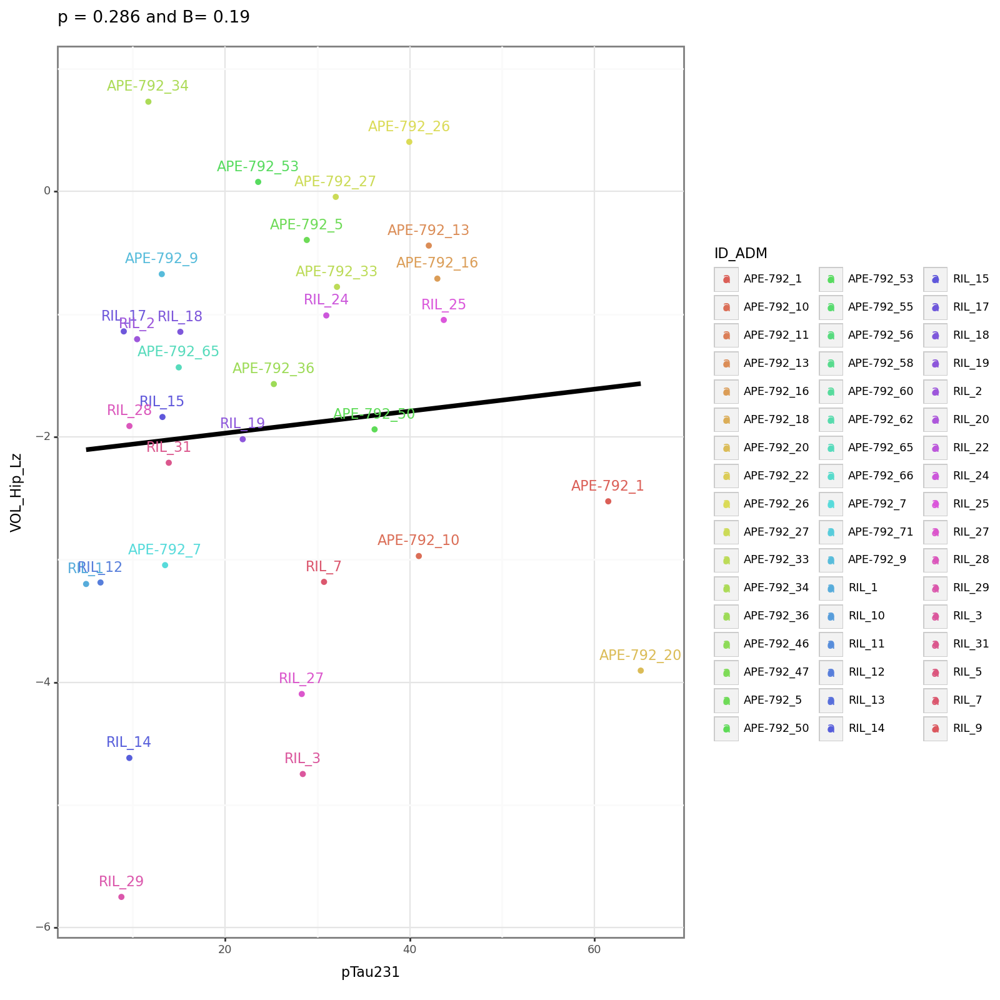


VOL_Hip_Lz pTau181


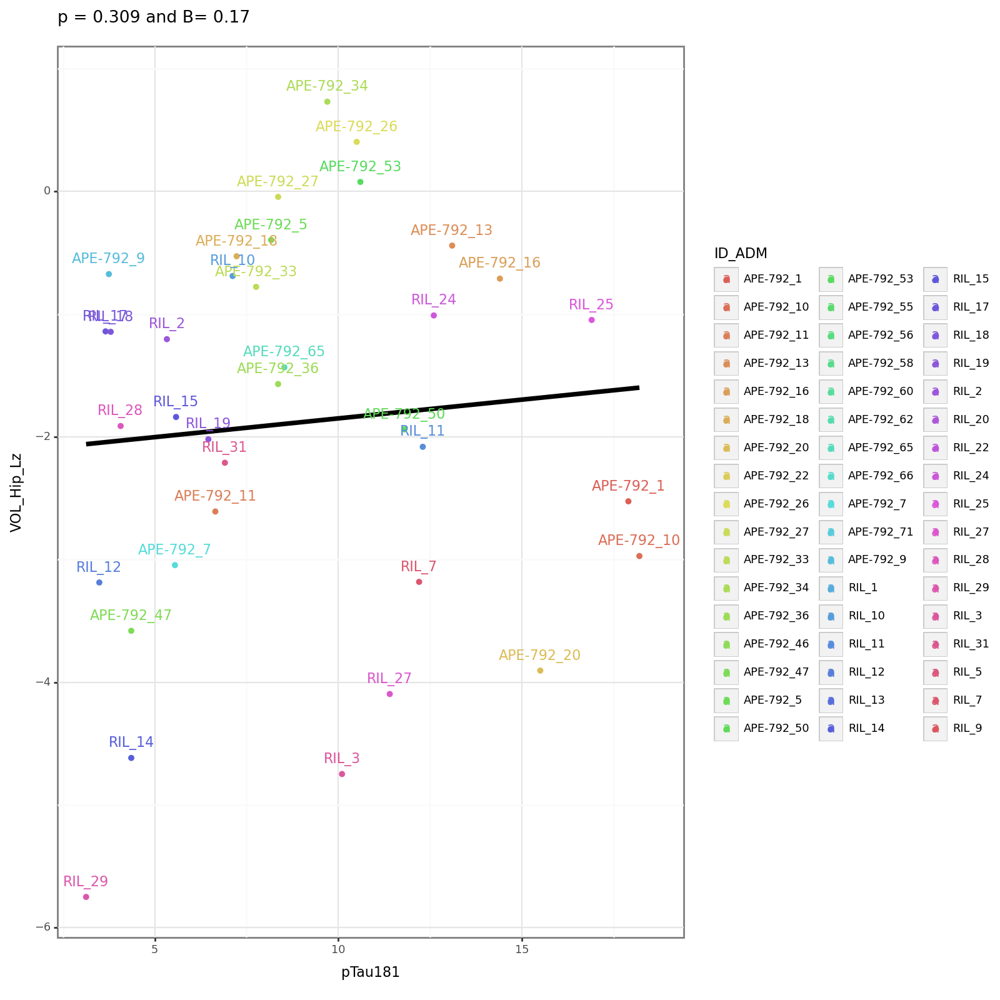


VOL_Hip_Rz pTau217


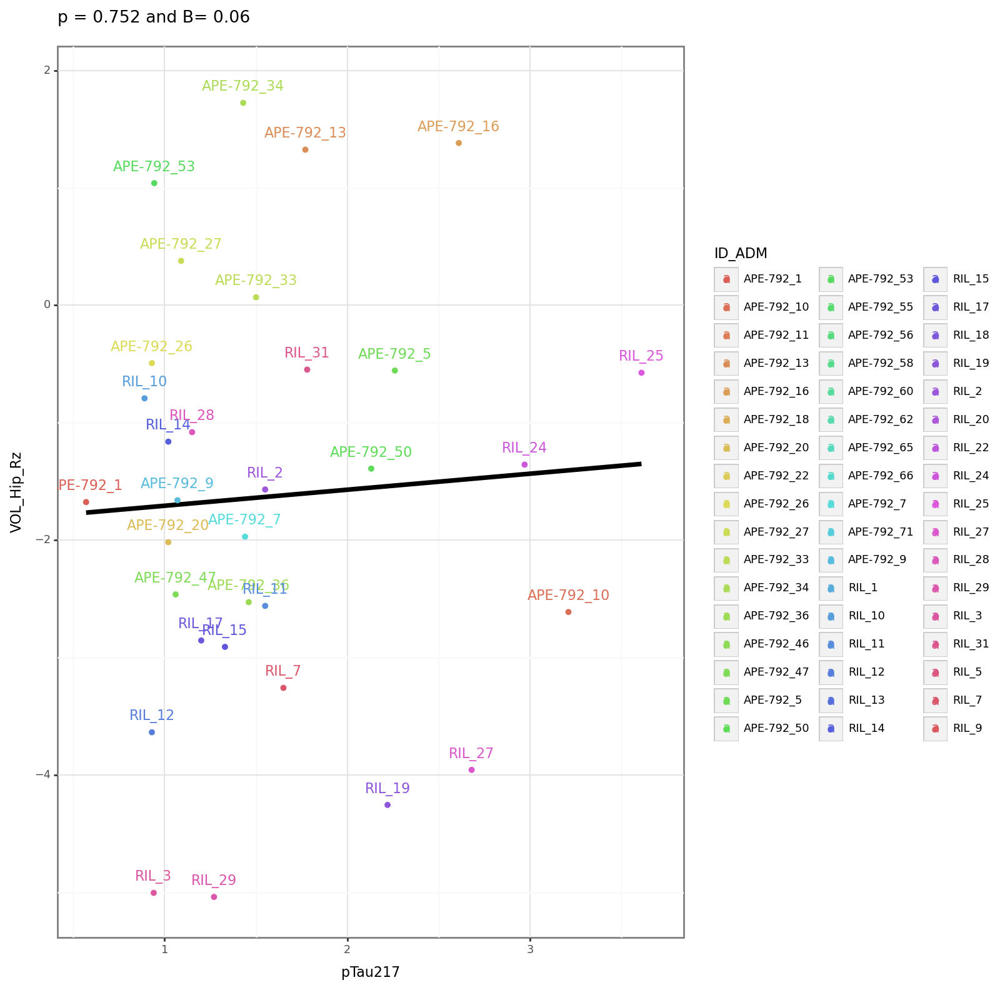


VOL_Hip_Rz pTau231


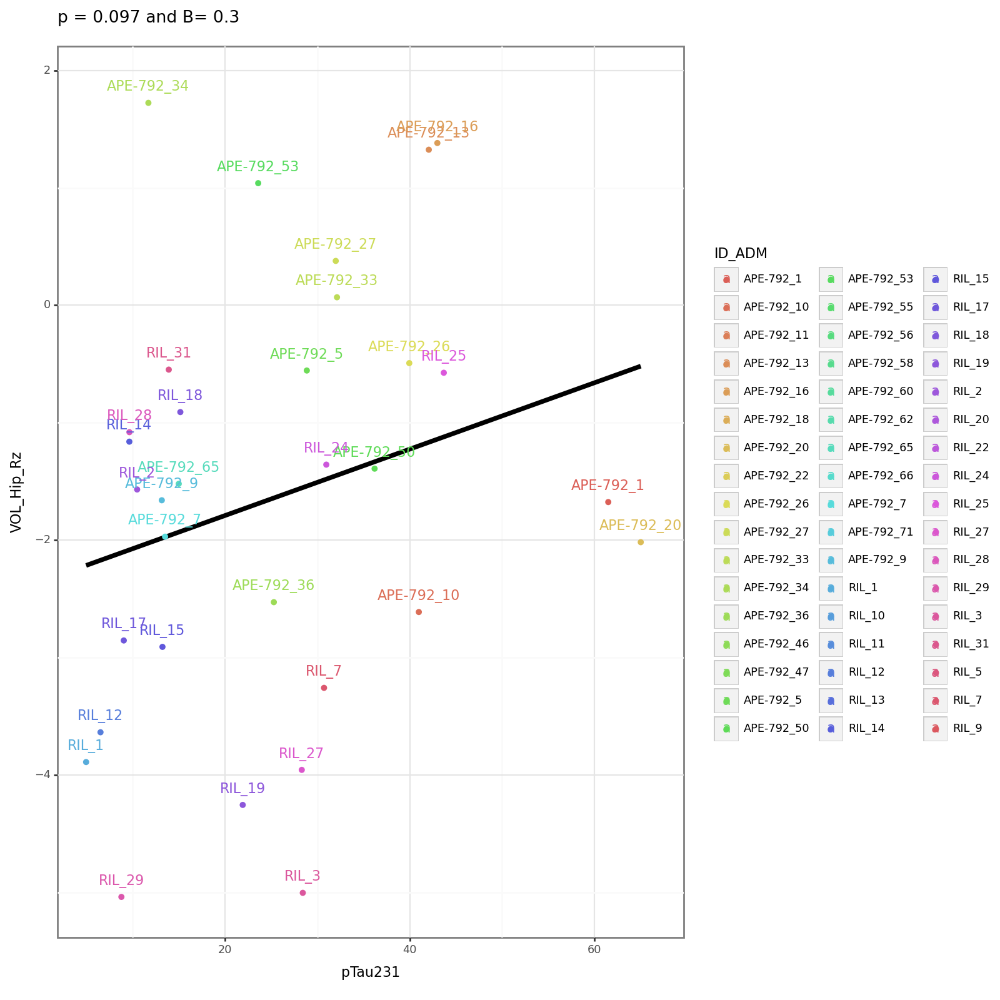


VOL_Hip_Rz pTau181


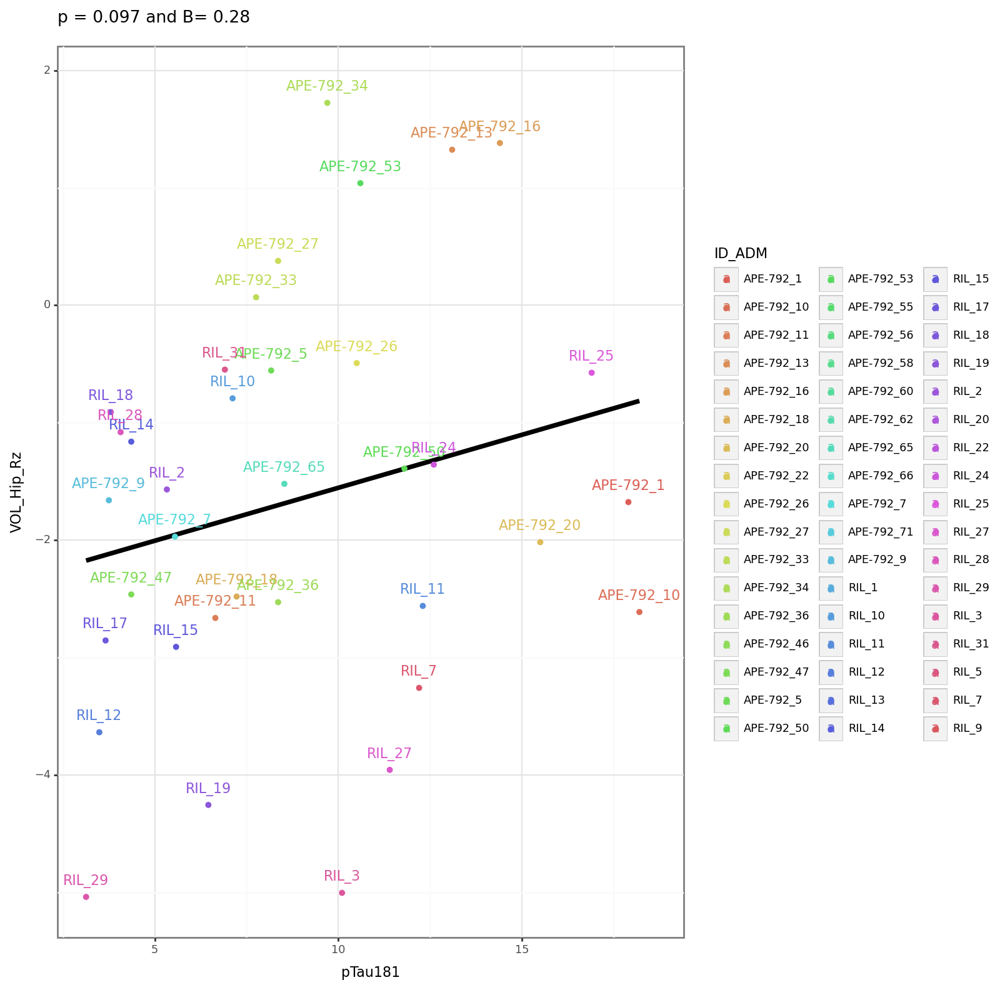


VOL_TotalGrayz pTau217


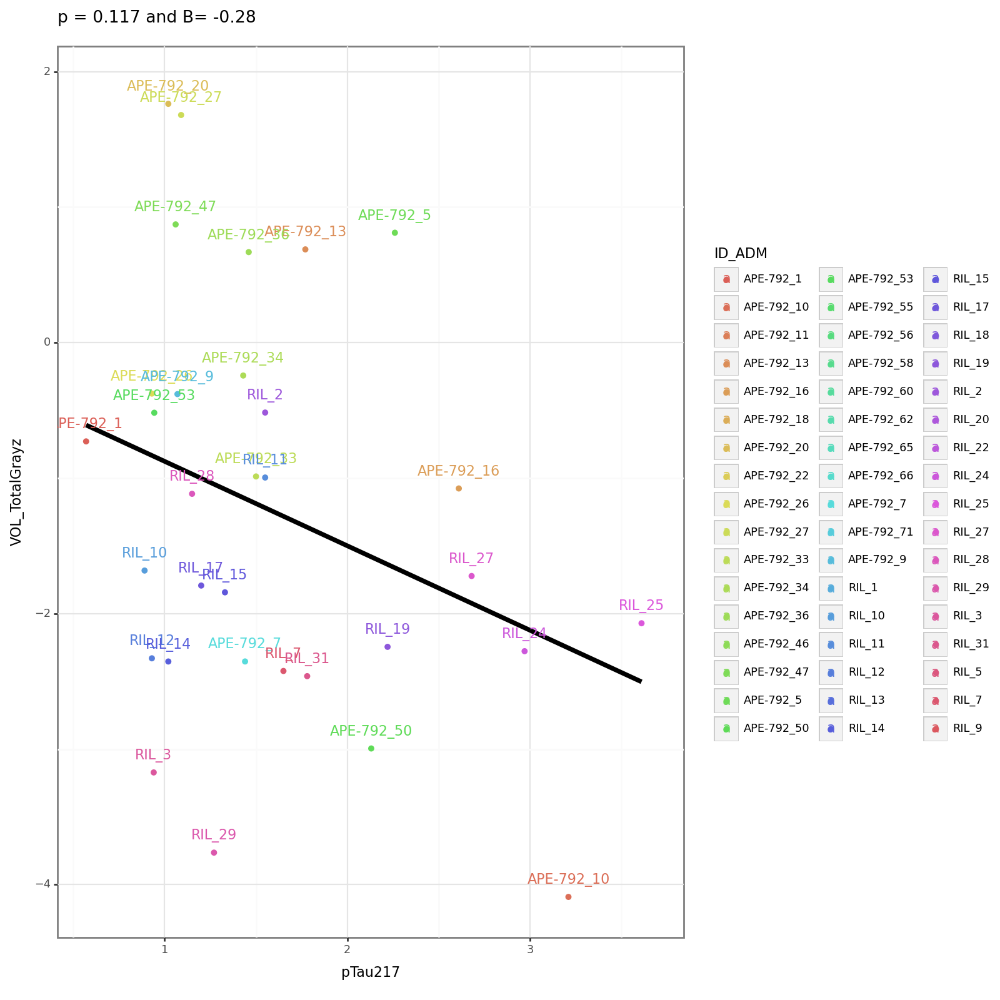


VOL_TotalGrayz pTau231


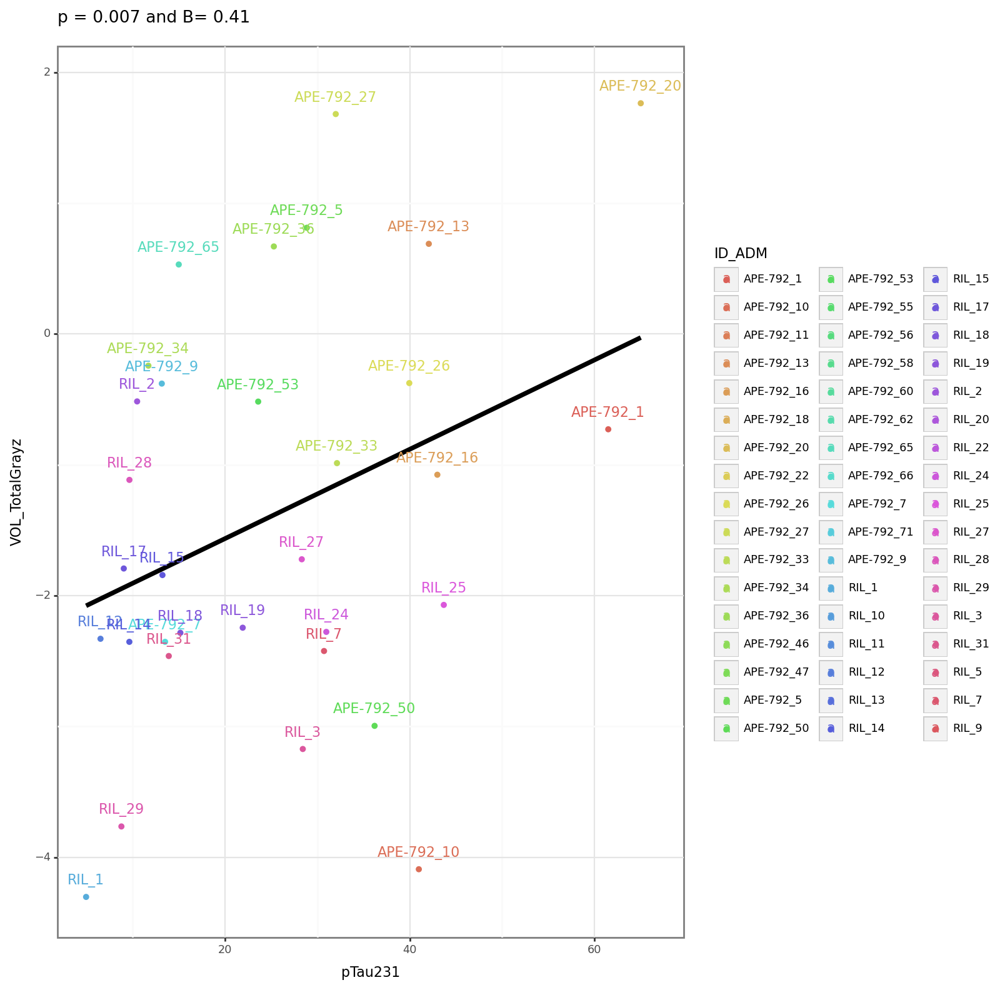


VOL_TotalGrayz pTau181


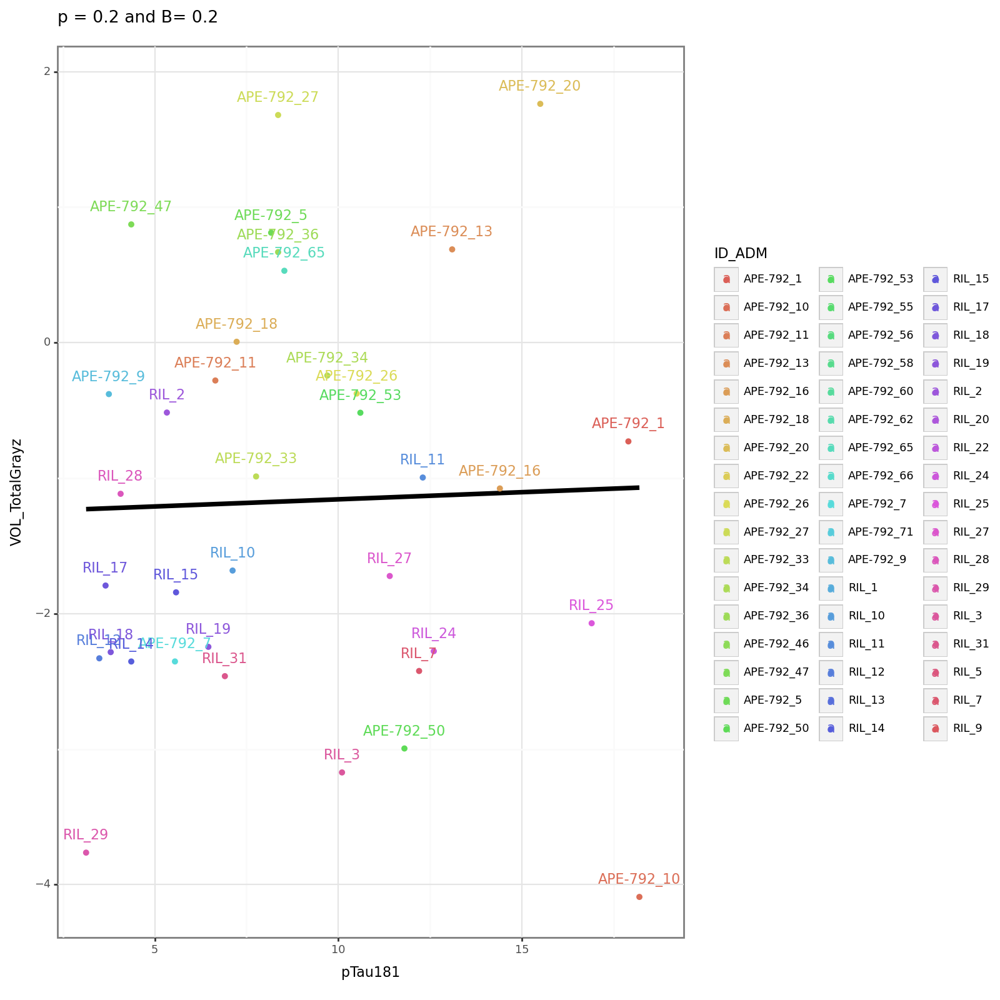


VOL_Inf_Mid_Fus_Temp_Lz pTau217


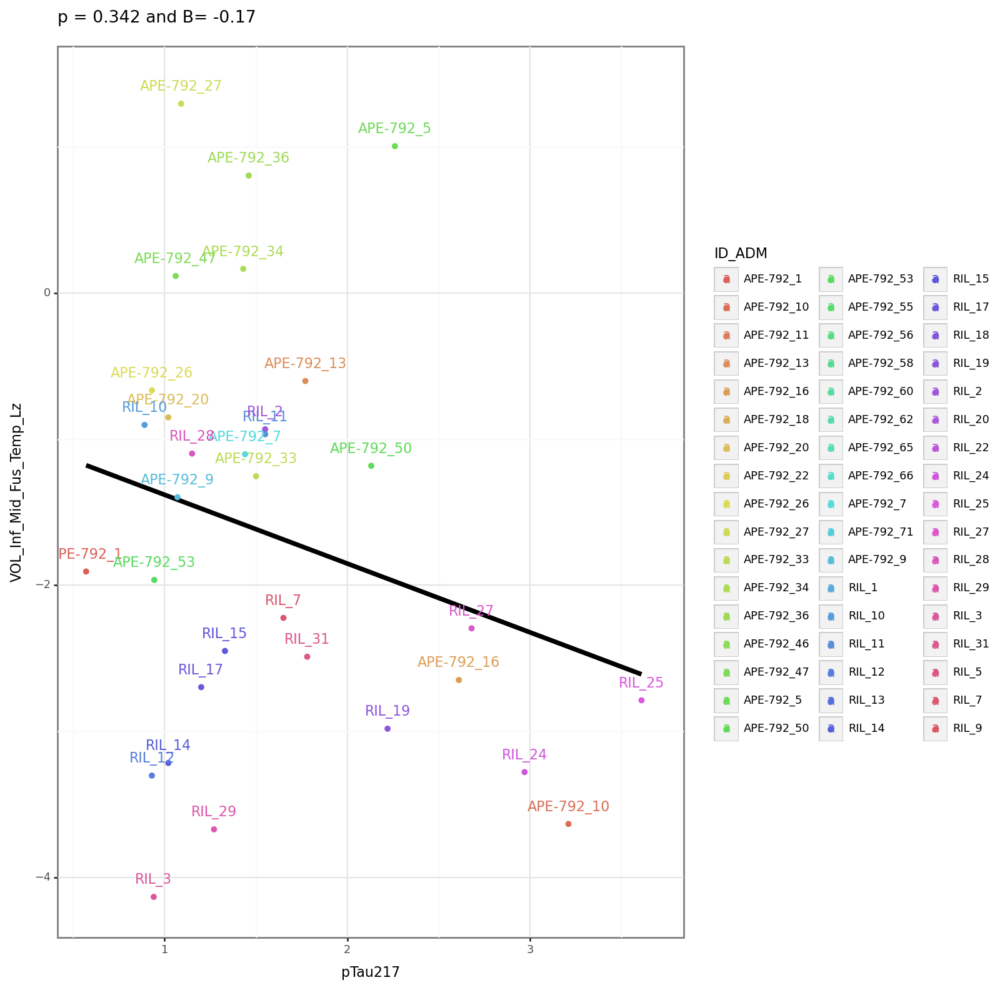


VOL_Inf_Mid_Fus_Temp_Lz pTau231


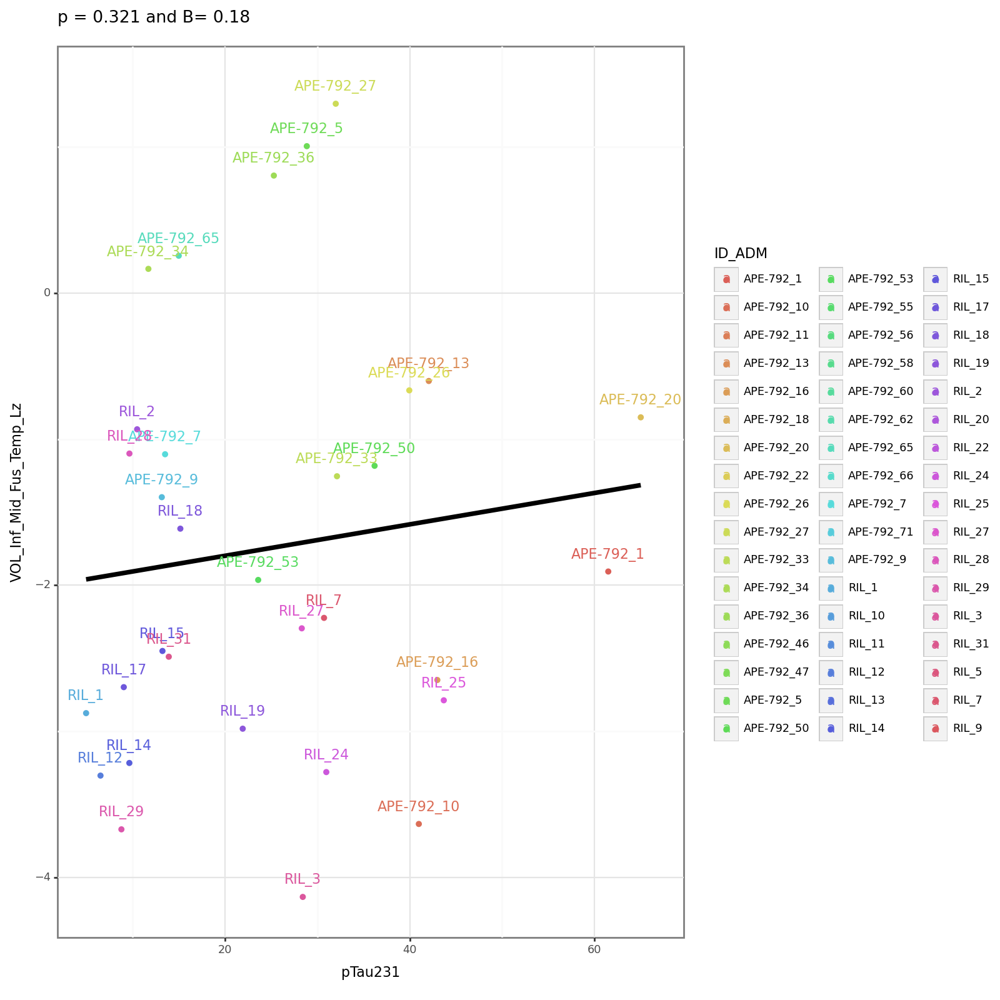


VOL_Inf_Mid_Fus_Temp_Lz pTau181


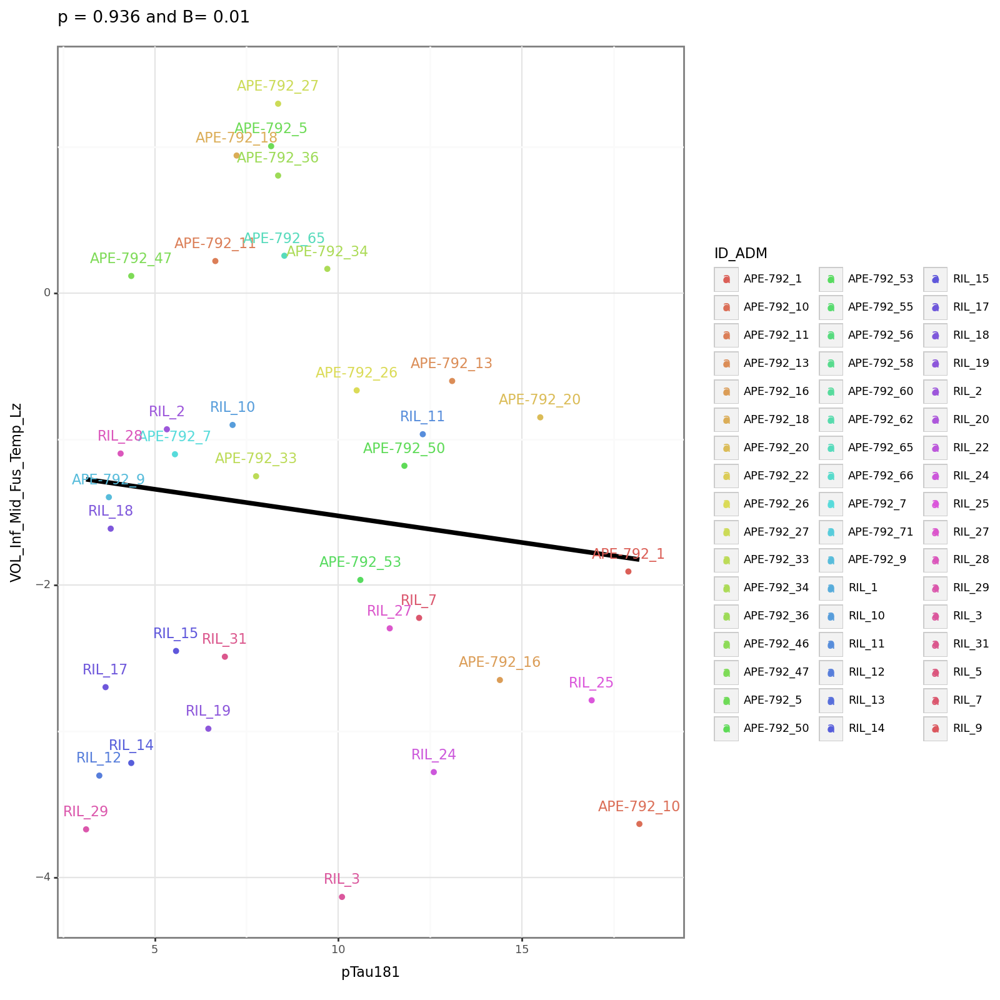


VOL_Inf_Mid_Fus_Temp_Rz pTau217


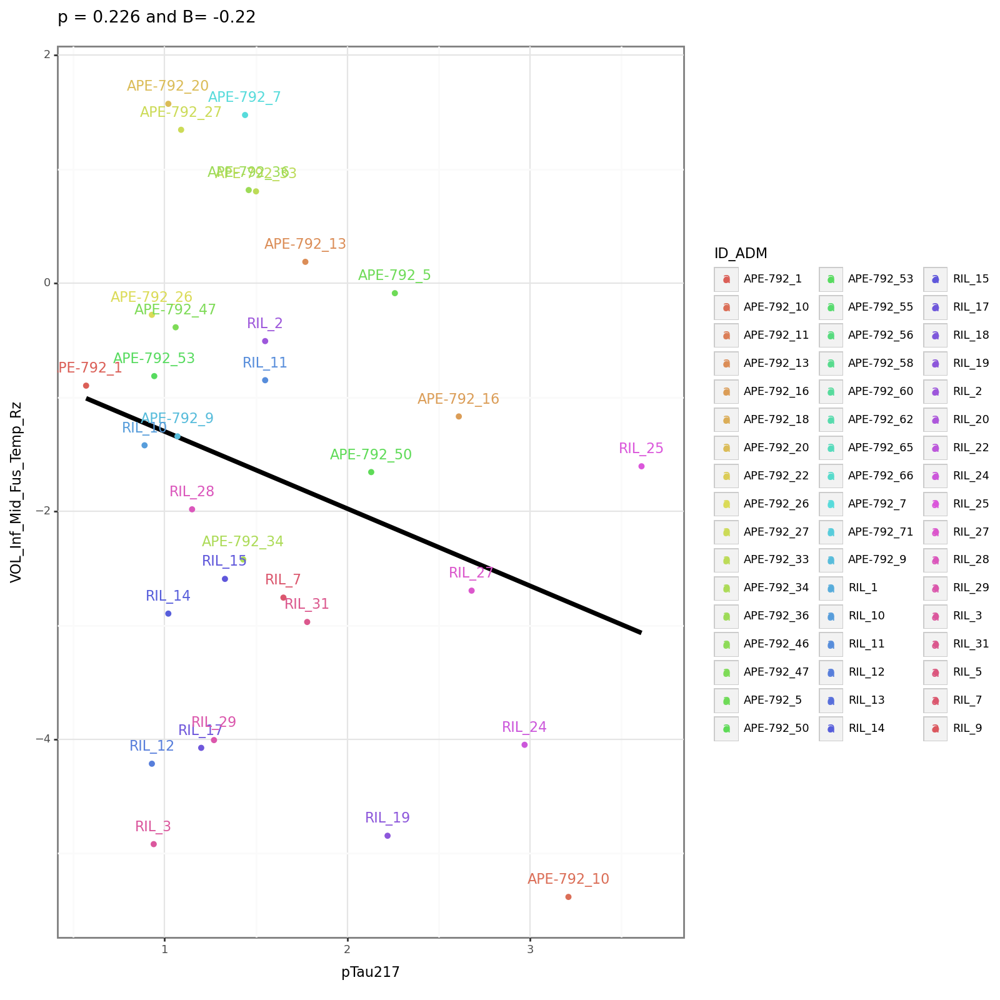


VOL_Inf_Mid_Fus_Temp_Rz pTau231


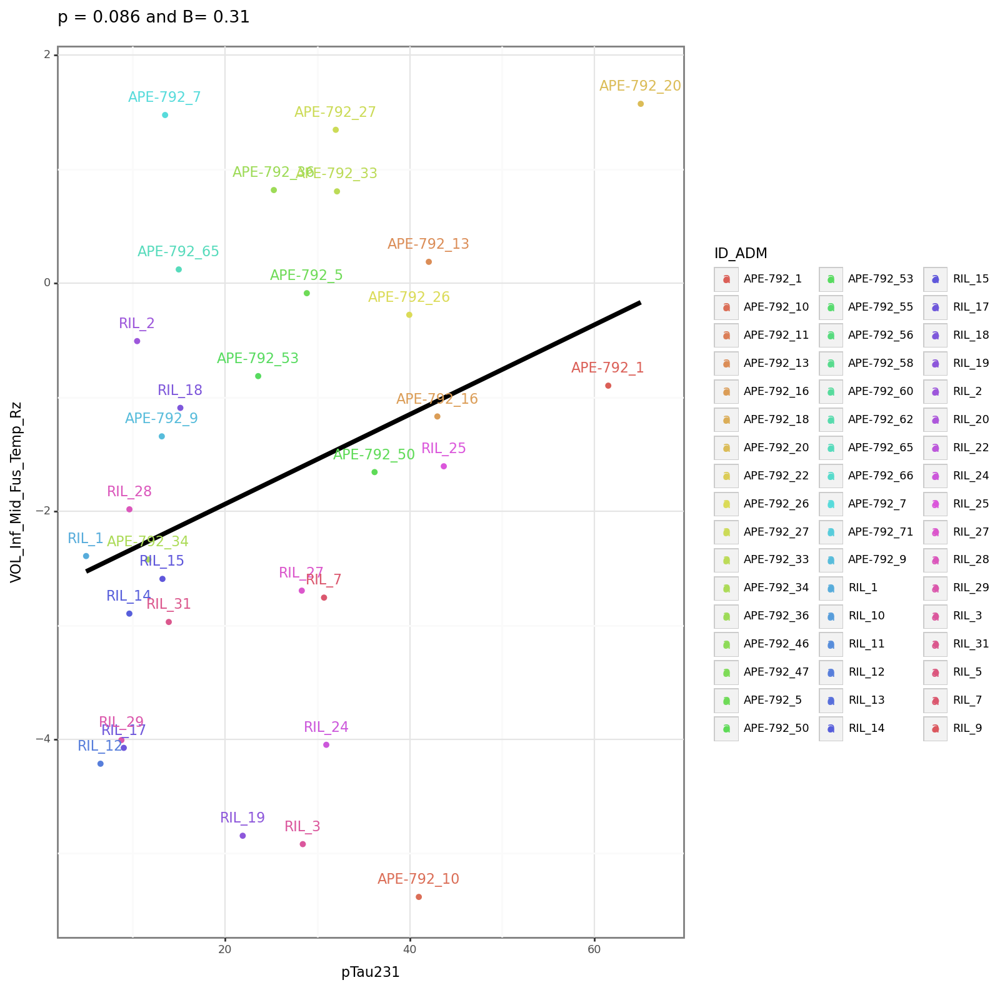


VOL_Inf_Mid_Fus_Temp_Rz pTau181


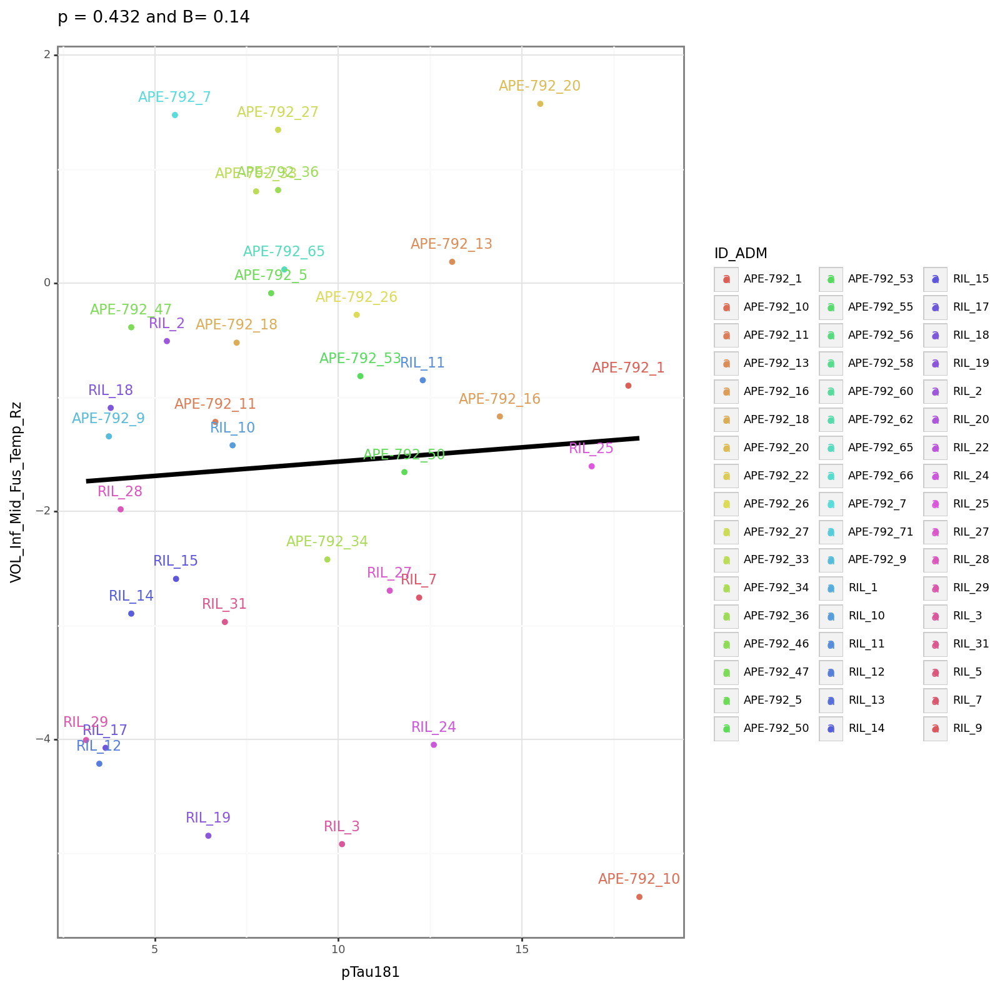


VOL_MidFront_Lz pTau217


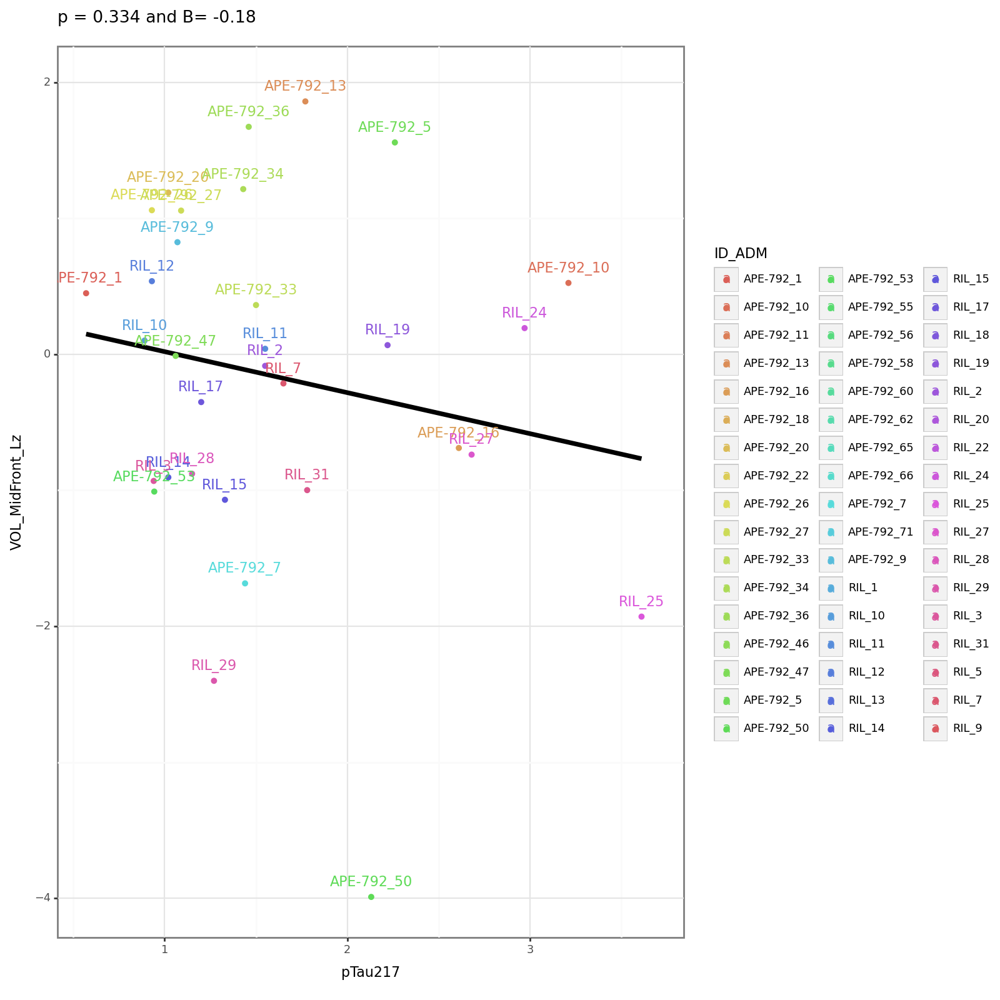


VOL_MidFront_Lz pTau231


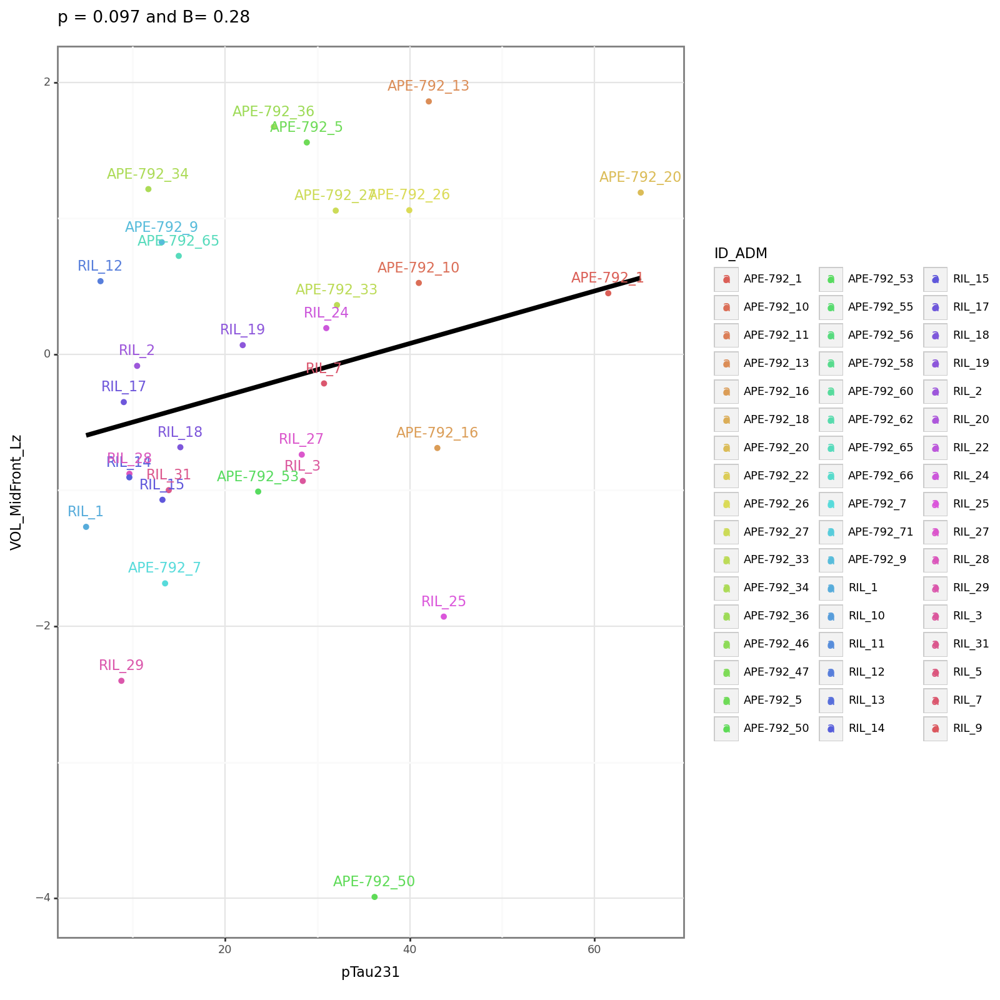


VOL_MidFront_Lz pTau181


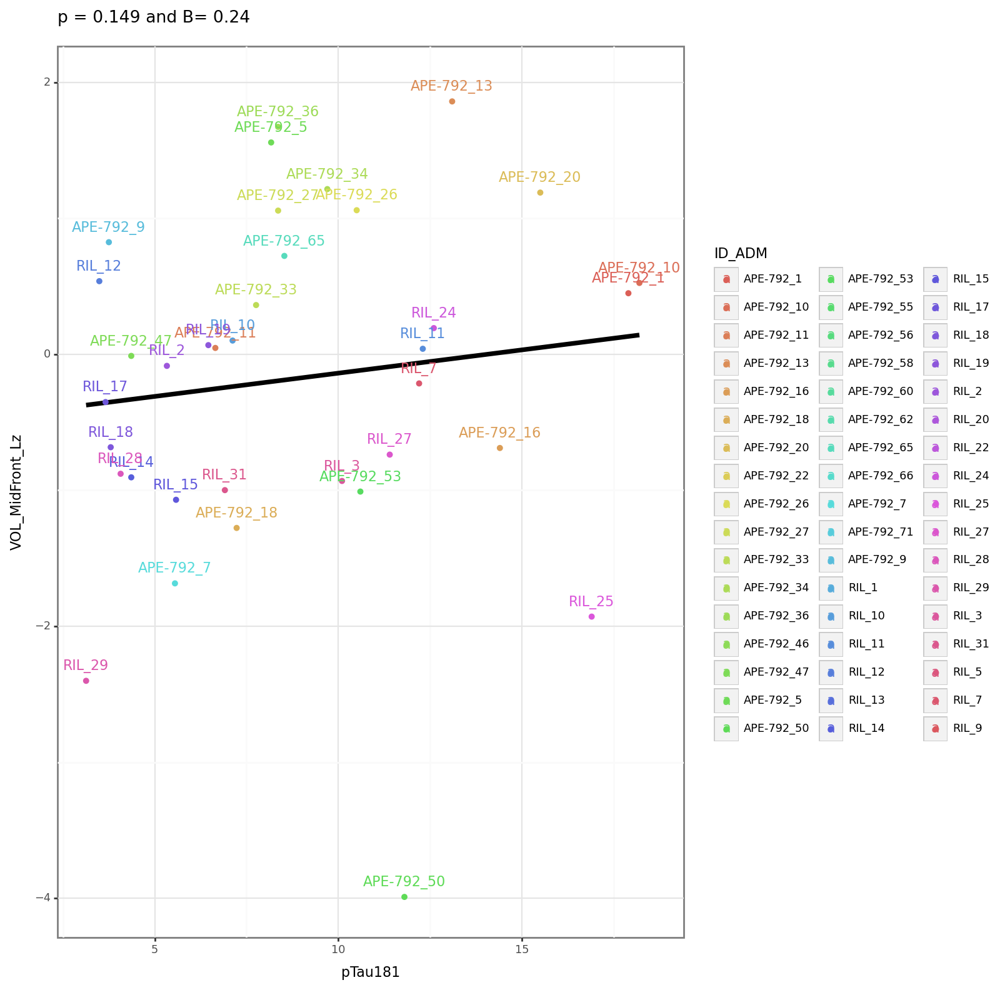


VOL_MidFront_Rz pTau217


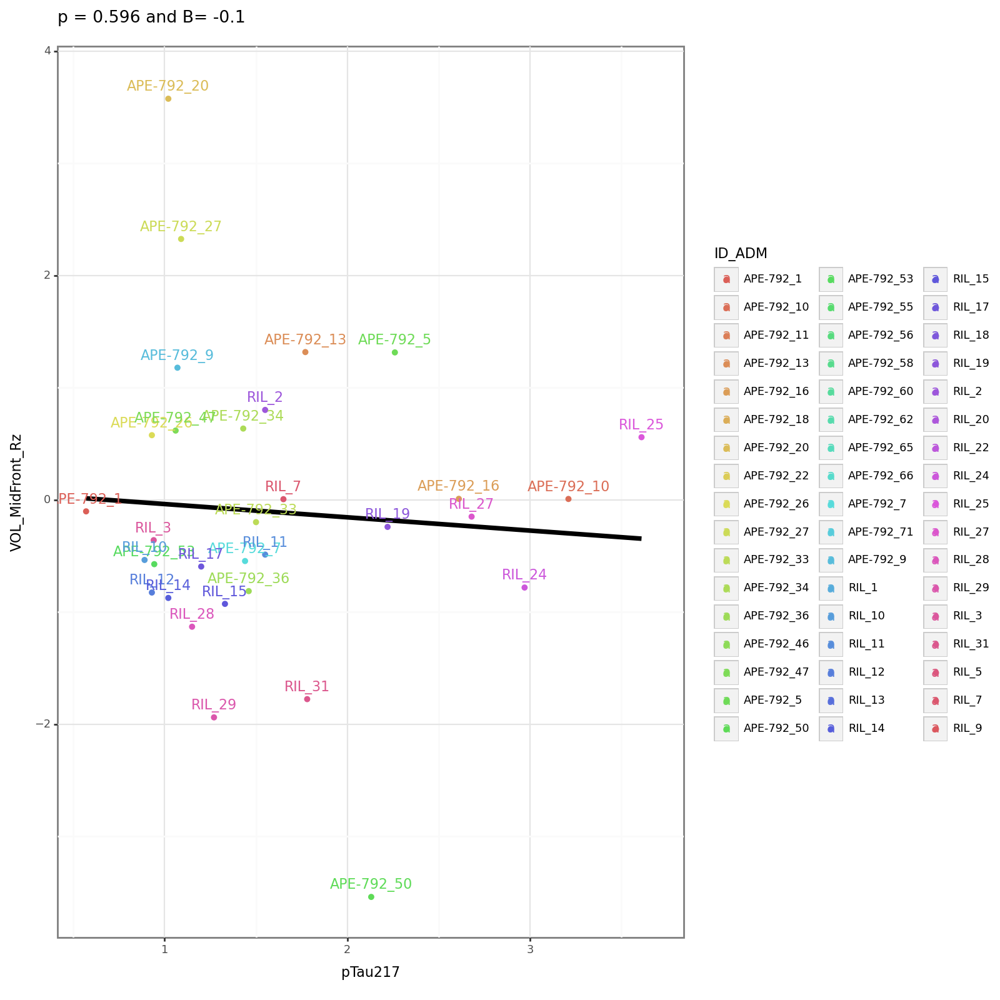


VOL_MidFront_Rz pTau231


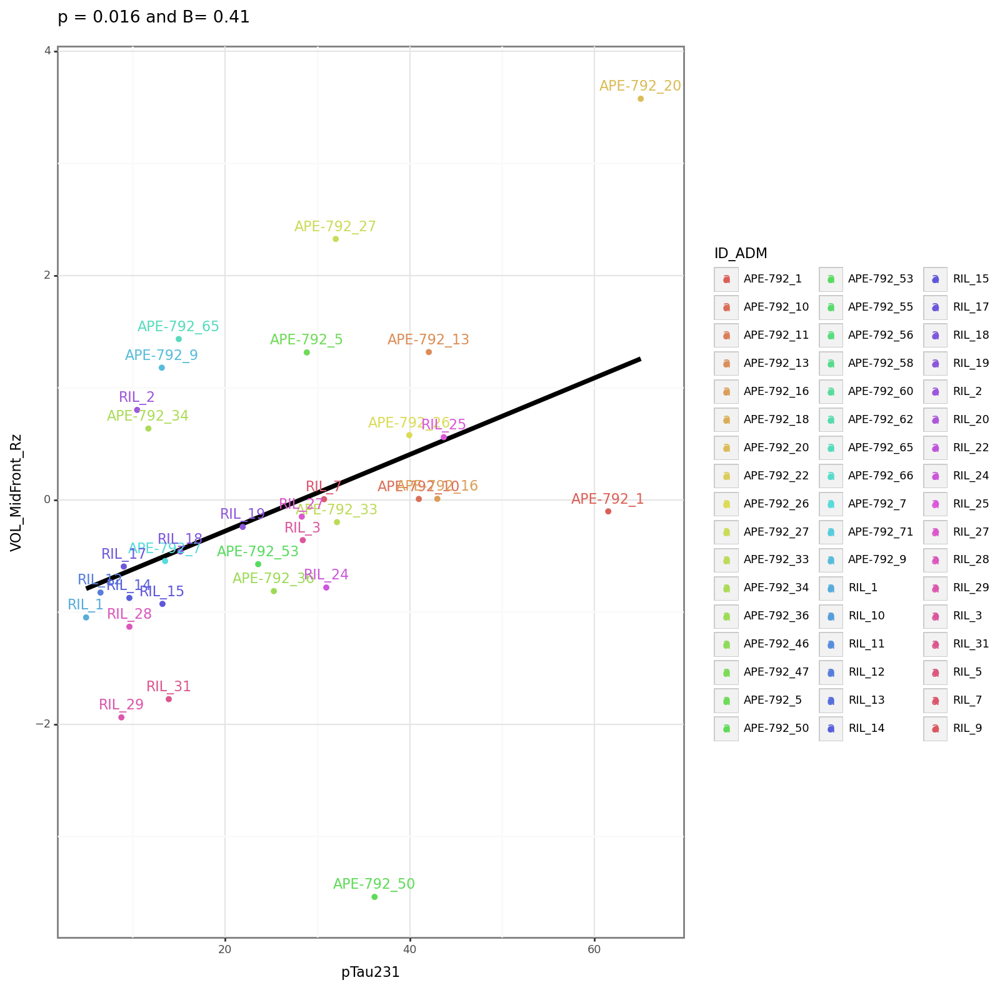


VOL_MidFront_Rz pTau181


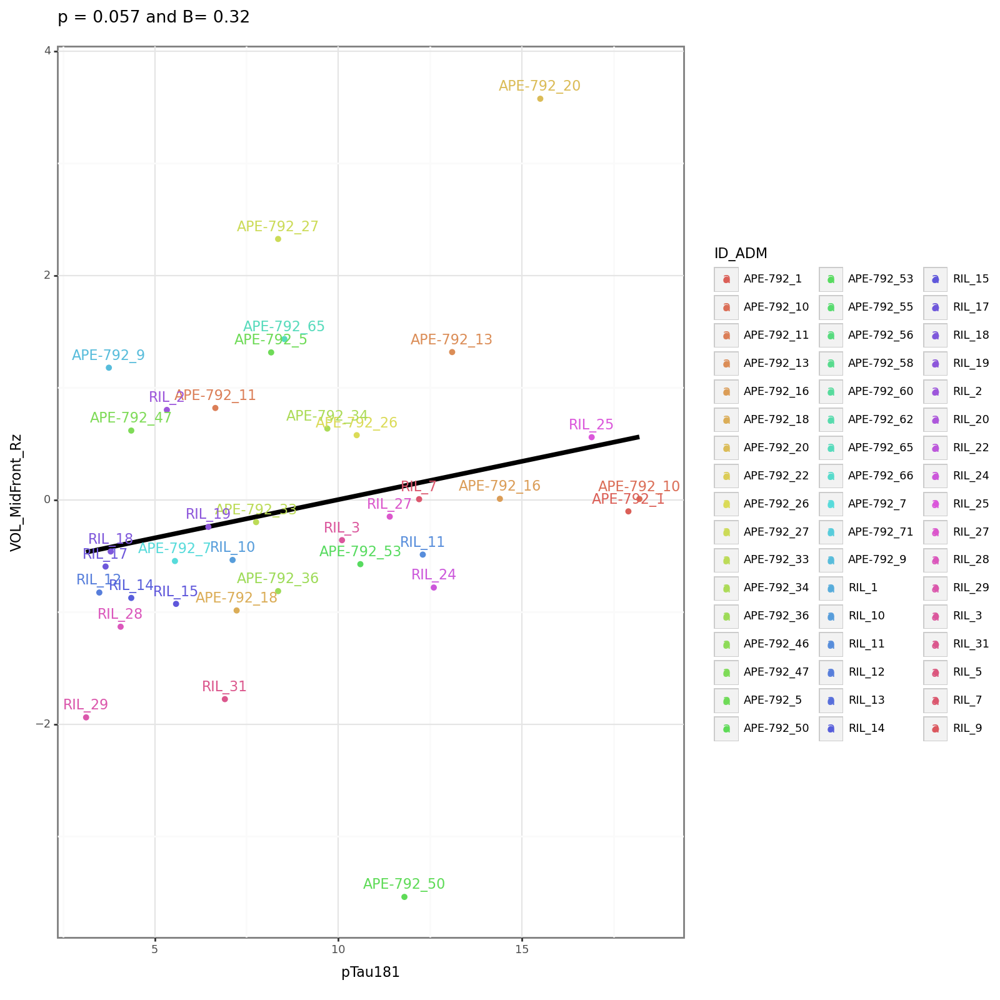

In [48]:
p9.options.figure_size = (4,3)    

for y_var in [ele for ele in vol_columns if ele in all_data.columns]:
    for x_var in ['pTau217', 'pTau231', 'pTau181']:
        p_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), pvals_to_consider[0]].reset_index(drop=True)[0].round(3).astype('str')
        B_value = biomarker_relationship_results_log10.loc[biomarker_relationship_results_log10['y_var'].isin([y_var]) & biomarker_relationship_results_log10['x_var'].isin([x_var]), Bval_to_grab].reset_index(drop=True)[0].round(2).astype('str')

        subset_data = baseline_trial_data.dropna(subset = [x_var, y_var, 'age_decade2'], how = 'any')
        subset_data2 = subset_data.copy()
        subset_data2 = subset_data2.groupby('age_decade2', observed=True).filter(lambda x: x['ID_ADM'].nunique()> 1)
        print(y_var, x_var)

        p9.options.figure_size = (8,8)  
        plot = (
                p9.ggplot(subset_data, p9.aes(x = x_var, y = y_var, color = 'ID_ADM', label = 'ID_ADM'))
                + p9.theme_bw(base_size = 8)
                + p9.geom_smooth(subset_data, size = 1.5, se = False, alpha = 1, color = 'black', method = 'lm')
                #+ p9.geom_smooth(subset_data2, size = 0.8, se = False, alpha = 1, method = 'lm')
                + p9.geom_point(size = 1.0)
                + p9.geom_text(size = 8, nudge_x = 0, nudge_y =baseline_data[y_var].std()/12)
                + p9.labs(title = ('p = ' + p_value + ' and B= ' + B_value))
                + p9.scale_x_continuous(limits = [subset_data[x_var].min(), subset_data[x_var].max() + 0.1*subset_data[x_var].std()])
            )
        print(plot)